# Preparation

## Setting Jupyter's parameters

In [5]:
# change code cells width
from IPython.display import display, HTML
display(
HTML(data = """
<style>
  div#notebook-container {width: 75%;}
  div#menubar-container {width: 65%;}
  div#maintoolbar-container {width: 55%;}
</style>

"""))


# display all outputs
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'



# pandas DataFrame displayed output size
import pandas as pd
pd.options.display.max_rows = 500
pd.options.display.max_columns = 40

# turning off scientific format for number in pandas DataFrames
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# size of plot made by plotnine
import plotnine
plotnine.options.figure_size = (20, 10) # width, hight

## Packages and functions

In [6]:
import os

# import modules.data_analysis_tools
# import modules.grid_search

%run "modules/data_analysis_tools.py"
%run "modules/F_regression.py"
%run "modules/grid_search.py"



IndentationError: unindent does not match any outer indentation level (data_analysis_tools.py, line 1693)

ModuleNotFoundError: No module named 'imblearn'

ModuleNotFoundError: No module named 'optuna'

## Global variables

In [7]:
# list of available models
models_base = {  'rf' :RandomForestRegressor(n_estimators=10, max_depth=6)
                ,'gb' :GradientBoostingRegressor(n_estimators=10, max_depth = 6)
                ,'cat':CatBoostRegressor(iterations=10,  random_seed=123)
                ,'ab' :AdaBoostRegressor(n_estimators = 30)
                ,'knn':skl.neighbors.KNeighborsRegressor(n_neighbors=5, weights='uniform', algorithm='auto', leaf_size=10, p=2, metric='minkowski')
                #,'nb' :skl.naive_bayes.GaussianNB(priors=None, var_smoothing=1e-09)
                ,'lgbm':LGBMRegressor(n_estimators = 50, n_jobs = 5, learning_rate = 0.1, max_depth = 7)
                #,'lr':LinearRegression(fit_intercept=True, normalize=False, copy_X=True, n_jobs=None, positive=False)
#                 ,'xgb':XGBRegressor(n_estimators = 50, leanring_rate = 0.1, max_depth = 7, n_jobs = 5)
                }

# main target variable
var_y = 'price'

# date varaibles (useful for quick filtering date variables)
var_date = ['date']

path_results = 'F:\\1_Programs_and_programing\\DS_proj\\classification_python\\results\\'

# Data

## Loading and basic statistics

In [8]:
dateparse = lambda x: datetime.datetime.strptime(x, '%Y-%m-%d')
# %Y: Year (4 digits)
# %m: Month
# %d: Day of month
# %H: Hour (24 hour)
# %M: Minutes
# %S: Seconds
# %f: Microseconds

data = pd.read_csv( 'data/diamonds.txt'
                   , sep = ','
                   , decimal = '.'
                   , parse_dates = ['date']
                   , na_values = ''
                   , date_parser = dateparse
                   , encoding = 'windows-1252' # useful encodings: latin1, latin2, utf8, windows-1252
                   , converters = {'z':float})   

# data = data.drop(data.columns[0], axis = 1) # for dropping first column with index if necessary


data['year'] = pd.DatetimeIndex(data['date']).year 
data['month'] = pd.DatetimeIndex(data['date']).month
data['quarter'] = data['date'].dt.quarter
data.loc[data['quarter']<3,'half'] = int(0)
data.loc[data['quarter']>=3,'half'] = int(1)
data['half'] = data['half'].astype(int)
data.loc[data['month'] <  10,'year_month'] = data['year'].astype(str) + '_0' + data['month'].astype(str)
data.loc[data['month'] >= 10,'year_month'] = data['year'].astype(str) + '_' + data['month'].astype(str)
data['year_quarter'] = data['year'].astype(str) + '_' + data['quarter'].astype(str) 
data['year_half'] = data['year'].astype(str) + '_' + data['half'].astype(str) 

h('data size')
data.shape

h('columns type')
data.dtypes

h('variables statistics')
glimpse_data(data, var_cat = list(data.dtypes[data.dtypes=='object'].index) )

(53940, 32)

carat                                float64
cut                                   object
color                                 object
clarity                               object
depth                                float64
table                                float64
price                                  int64
x                                    float64
y                                    float64
z                                    float64
target                                 int64
target_multi_label                     int64
carat_missing                        float64
cut_missing                           object
color_missing                         object
clarity_missing                       object
depth_missing                        float64
table_missing                        float64
price_missing                        float64
x_missing                            float64
y_missing                            float64
z_missing                            float64
target_mis

,target,table,quarter,y,x_missing,half,target_multi_label_missing,month,z_missing,table_missing,price_missing,target_multi_label,carat,price,target_missing,year,carat_missing,depth_missing,depth,x,date,y_missing,z,cut,color,clarity,cut_missing,color_missing,clarity_missing,year_month,year_quarter,year_half
NA,0.000,0.000,0.000,0.000,5394.000,0.000,5394.000,0.000,5394.000,5394.000,5394.000,0.000,0.000,0.000,5394.000,0.000,5394.000,5394.000,0.000,0.000,0,5394.000,0.000,0.0,0.0,0.0,0.1,0.1,0.1,0.0,0.0,0.0
NA_proc,0.000,0.000,0.000,0.000,0.100,0.000,0.100,0.000,0.100,0.100,0.100,0.000,0.000,0.000,0.100,0.000,0.100,0.100,0.000,0.000,0.0,0.100,0.000,0,0,0,5394,5394,5394,0,0,0
min,0.000,43.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,43.000,326.000,0.000,0.200,326.000,NaN,2019.000,0.200,43.000,43.000,0.000,2019-11-01 00:00:00,0.000,0.000,Ideal (21551),G (11292),SI1 (13065),Ideal (19337),G (10144),SI1 (11739),2020_01 (18135),2019_4 (35207),2019_1 (35207)
q_25,0.000,56.000,1.000,4.720,4.710,0.000,0.000,1.000,2.910,56.000,949.000,0.000,0.400,950.000,0.000,2019.000,0.400,61.000,61.000,4.710,2019-11-24T00:00:00.000000000,4.720,2.910,Premium (13791),E (9797),VS2 (12258),Premium (12413),E (8797),VS2 (11064),2019_12 (17779),2020_1 (18733),2020_0 (18733)
q_50,0.000,57.000,4.000,5.710,5.700,1.000,1.000,11.000,3.520,57.000,2404.000,1.000,0.700,2401.000,0.000,2019.000,0.700,61.800,61.800,5.700,2019-12-17T00:00:00.000000000,5.710,3.530,Very Good (12082),F (9542),SI2 (9194),Very Good (10914),F (8639),SI2 (8281),2019_11 (17428),NaN,NaN
q_75,1.000,59.000,4.000,6.540,6.540,1.000,3.000,12.000,4.030,59.000,5329.000,3.000,1.040,5324.250,1.000,2020.000,1.040,62.500,62.500,6.540,2020-01-09T00:00:00.000000000,6.530,4.040,Good (4906),H (8304),VS1 (8171),Good (4438),H (7458),VS1 (7359),2020_02 (598),NaN,NaN
max,1.000,95.000,4.000,58.900,10.740,1.000,4.000,12.000,31.800,95.000,18823.000,4.000,5.010,18823.000,NaN,2020.000,5.010,79.000,79.000,10.740,2020-02-01 00:00:00,58.900,31.800,Fair (1610),D (6775),VVS2 (5066),Fair (1444),D (6065),VVS2 (4561),NaN,NaN,NaN


## More advanced statistics

In [5]:

gl_result = glimpse_data_extended(  data                       # data (usnac daty)
                                  , levels_n_limit = 7         # how many of the most common categories in categorical variables show in results
                                  , levels_n_max=35            # max number of unique values in numerical variable that make it to treat as a categorical variable. 
                                  , copy_to_clipboard = False) # if save results to clipboard (for a example to copy them to Excela)

A_F_correlation_selection(  data = data
                          , y    = var_y
                          , analytical_table_file = gl_result
                          , sheet = None
                          , round = 2)

ratio_not_calculated for cut and target.
ratio_not_calculated for color and target.
ratio_not_calculated for clarity and target.
ratio_not_calculated for cut_missing and target.
ratio_not_calculated for color_missing and target.
ratio_not_calculated for clarity_missing and target.
pearson_not_calculated for date and target.
kendall_not_calculated for date and target.
ratio_not_calculated for year_month and target.


,index,var,nan_proc,rec_type,type,n_levels,0,1,2,3,4,5,6,min,q_10,q_25,q_50,q_75,q_90,max,remove,importance_cat,importance_rand,importatnce_permut,pearson,v_cramer,ratio,kendall,v_cramer_,pearson_,ratio_,kendall_
0,0,carat,0.000,n,float64,273,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,0.31,0.4,0.7,1.04,1.51,5.01,0,1,0,0,1,1,1,1,NaN,-0.260,NaN,-0.240
1,1,cut,0.000,c,object,5,Ideal (40.0),Premium (25.6),Very Good (22.4),Good (9.1),Fair (3.0),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1,1,1,1,0.170,NaN,NaN,NaN
2,2,color,0.000,c,object,7,G (20.9),E (18.2),F (17.7),H (15.4),D (12.6),I (10.1),J (5.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1,1,1,1,0.150,NaN,NaN,NaN
3,3,clarity,0.000,c,object,8,SI1 (24.2),VS2 (22.7),SI2 (17.0),VS1 (15.1),VVS2 (9.4),VVS1 (6.8),IF (3.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1,1,1,1,1.000,NaN,NaN,NaN
4,4,depth,0.000,n,float64,184,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43.0,60.0,61.0,61.8,62.5,63.3,79.0,0,1,0,0,1,1,1,1,NaN,-0.050,NaN,-0.060
5,5,table,0.000,n,float64,127,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43.0,55.0,56.0,57.0,59.0,60.0,95.0,0,1,0,0,1,1,1,1,NaN,-0.120,NaN,-0.110
6,6,price,0.000,n,int64,11602,NaN,NaN,NaN,NaN,NaN,NaN,NaN,326.0,646.0,950.0,2401.0,5324.25,9821.0,18823.0,0,1,0,0,1,1,1,1,NaN,-0.110,NaN,-0.130
7,7,x,0.000,n,float64,554,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,4.36,4.71,5.7,6.54,7.31,10.74,0,1,0,0,1,1,1,1,NaN,-0.280,NaN,-0.230
8,8,y,0.000,n,float64,552,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,4.36,4.72,5.71,6.54,7.3,58.9,0,1,0,0,1,1,1,1,NaN,-0.270,NaN,-0.230
9,9,z,0.000,n,float64,375,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,2.69,2.91,3.53,4.04,4.52,31.8,0,1,0,0,1,1,1,1,NaN,-0.280,NaN,-0.230


# Analysis - individual features

## Target

In [6]:
cross_tab(data, var_1 = 'target', var_2 = None, round = 1, normalize = 'index')

,count,percent
0,35258,65.400
1,18682,34.600


## Categorical

### cut

braki danych: 0.0 %


,count,percent,c(Fair),c(Good),c(Ideal),c(Premium),c(Very Good),p(Fair),p(Good),p(Ideal),p(Premium),p(Very Good)
0,35258,65.400,1345,3715,12097,10086,8015,3.800,10.500,34.300,28.600,22.700
1,18682,34.600,265,1191,9454,3705,4067,1.400,6.400,50.600,19.800,21.800


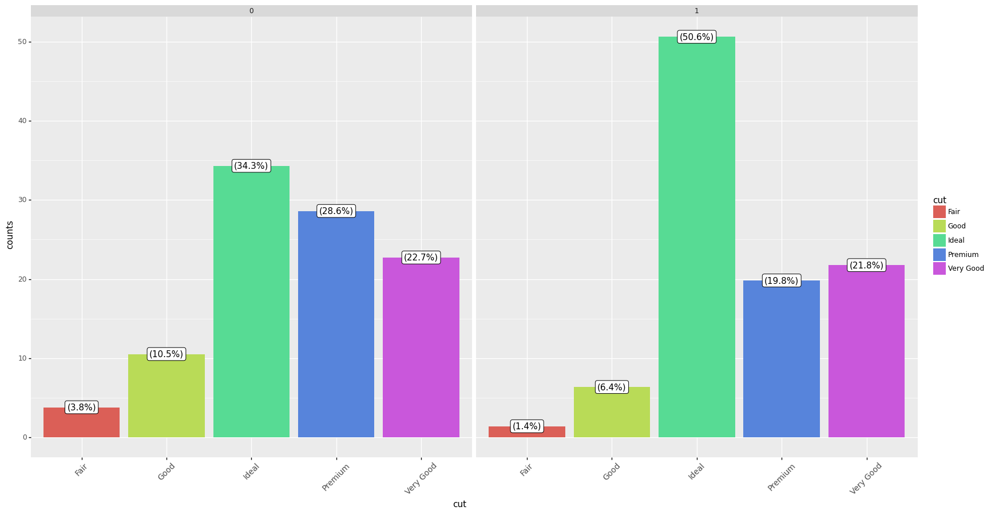

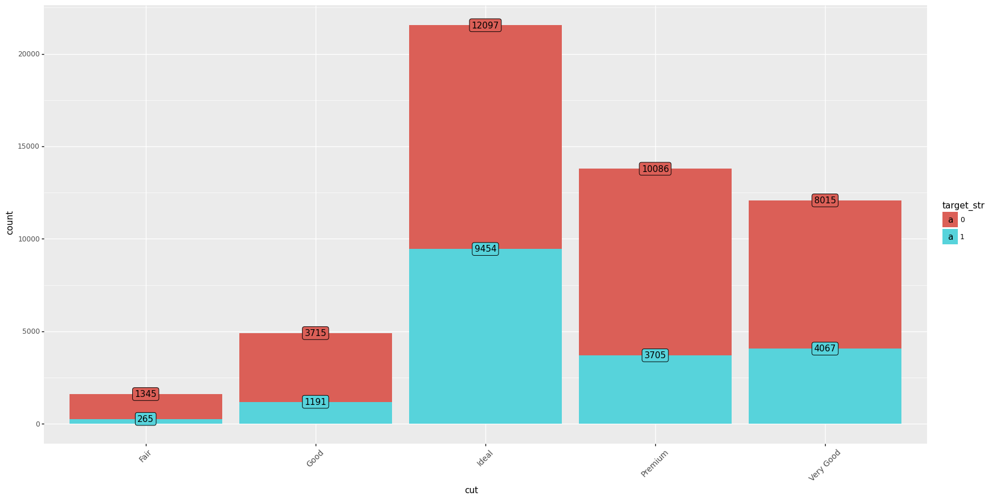

0.17

,cut,cut_woe
0,Ideal,0.389
1,Premium,-0.366
2,Good,-0.502
5,Very Good,-0.043
8,Fair,-0.986


In [7]:
var_x = 'cut'
var_y = 'target'

var_categorical_summary(data=data, var_x=var_x, var_y=var_y, normalize = 'index', x_angle = 45, x_text_size = 10)

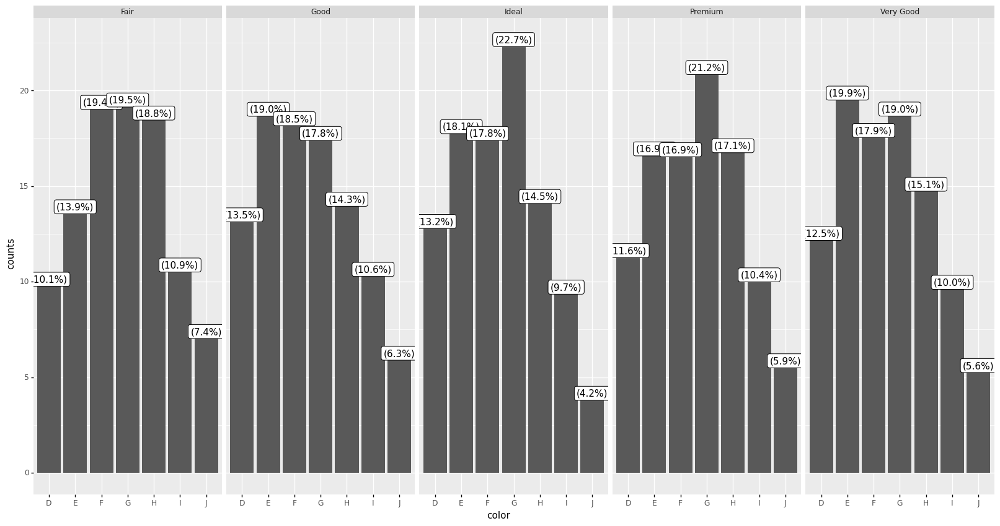

<ggplot: (-9223371890503983932)>

In [8]:


c = data.groupby(["cut","color"]).size()
c = c / c.groupby(level=[0]).transform("sum") * 100
c = c.reset_index(name='counts')
(ggplot(data=c) + geom_bar(aes(x='color', y='counts'), stat='identity') + geom_label(aes(x='color',y='counts', label = 'counts'), format_string='({:.1f}%)') + facet_grid('.~cut'))



braki danych: 0.0 %


,count,percent,c(Fair),c(Good),c(Ideal),c(Premium),c(Very Good),p(Fair),p(Good),p(Ideal),p(Premium),p(Very Good)
0,35258,65.400,1345,3715,12097,10086,8015,3.800,10.500,34.300,28.600,22.700
1,18682,34.600,265,1191,9454,3705,4067,1.400,6.400,50.600,19.800,21.800


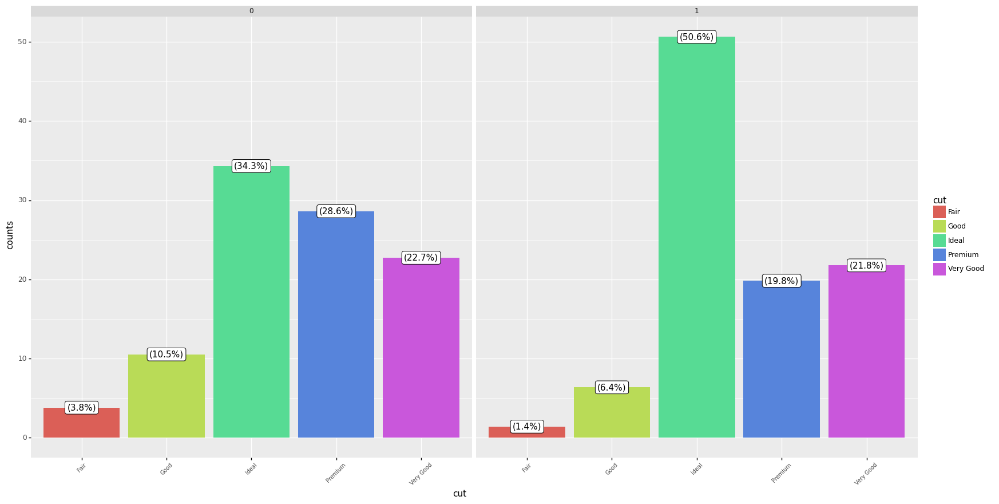

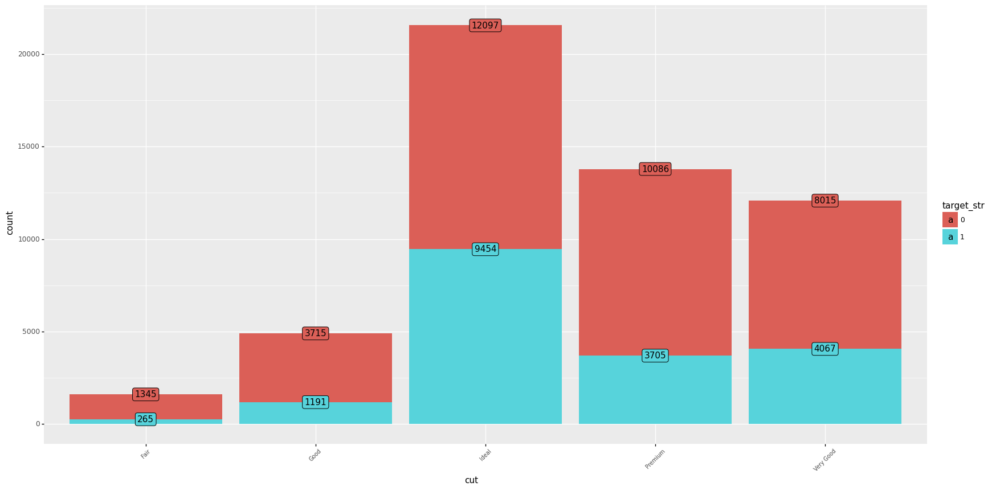

0.17

,cut,cut_woe
0,Ideal,0.389
1,Premium,-0.366
2,Good,-0.502
5,Very Good,-0.043
8,Fair,-0.986


In [9]:
var_x = 'cut'
var_y = 'target'

var_categorical_summary(data=data, var_x=var_x, var_y=var_y, normalize = 'index', x_angle = 45)

## Numerical

### LIST num filter

In [56]:
filters_num = {'price':[2000,3000], 'x':[None,10],'y':[50,None]}

### price

braki danych: 0.0 %


,min,q_05,q_10,q_25,q_50,q_75,q_90,q_95,max
0,326,544.000,646.000,950.000,2401.000,5324.250,9821.000,13107.100,18823


,min_,q_10,q_25,q_50,q_75,q_90,max_
cut,,,,,,,
Fair,337,1114,2050.250,3282.000,5205.500,9133.700,18574
Good,327,603,1145.000,3050.500,5028.000,8736.000,18788
Ideal,326,652,878.000,1810.000,4678.500,9077.000,18806
Premium,326,709,1046.000,3185.000,6296.000,11413.000,18823
Very Good,336,576,912.000,2648.000,5372.750,9680.900,18818


No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

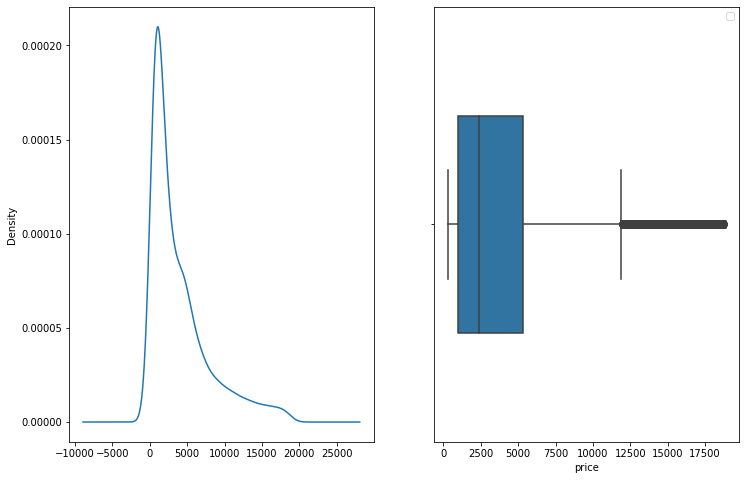

None

<Figure size 432x288 with 0 Axes>

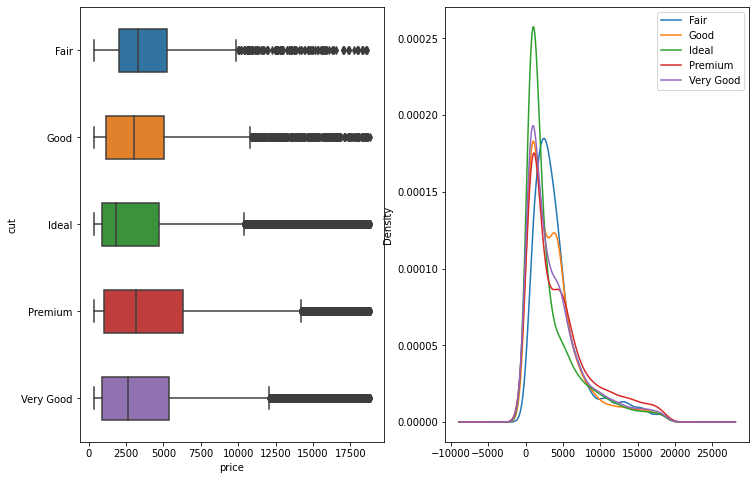

None

,price,target
price,1.000,-0.110
target,-0.110,1.000


,0
0_1,0.234


In [68]:
var_y = 'target'
var_x = 'price'
var_group = 'cut'

var_numerical_vs_numerical_summary(data, var_x='price', var_y='target', var_group='cut', filters_num=None)

# Analysis - correlation between features

## Categorical

### V-cramer

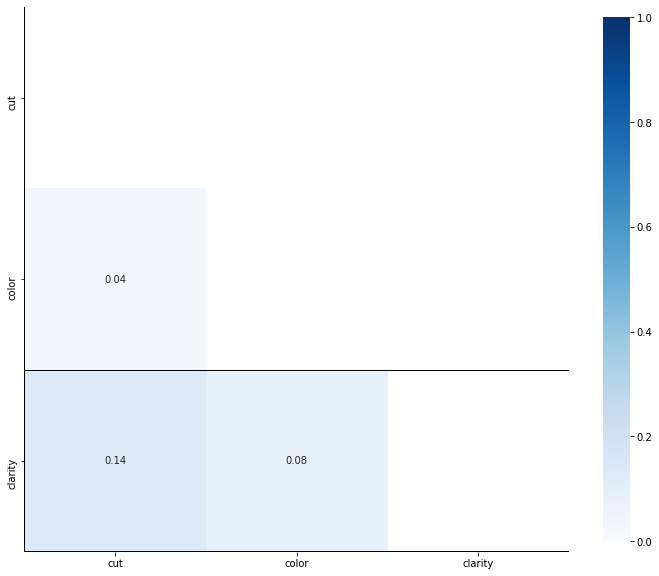

In [375]:
var_x_categorical = ['cut', 'color', 'clarity']

correlation_cramer_v_matrix(  data    = data
                            , vars    = var_x_categorical
                            , heatmap = True
                            , width   = 10
                            , height  = 10
                            , color_threshold = 0.75
                            , round   = 2)

### V-cramer grouped

In [181]:
correlation_v_cramer_grouped(data, var_main = 'z', var_other=['x','y'], var_group='target')

,category,x,y
0,0,0.37,0.37
0,1,0.36,0.35


## Numerical

### pearson

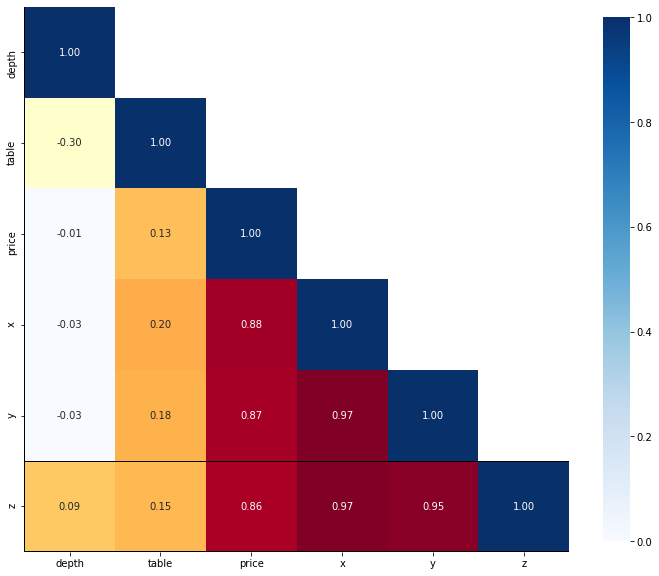

In [376]:
var_x_numeric = ['depth', 'table', 'price', 'x', 'y', 'z']

correlation_pearson(  data    = data
                    , vars    = var_x_numeric
                    , heatmap = True
                    , width   = 10
                    , height  = 10
                    , round   = 2)

In [173]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.graphics.mosaicplot import mosaic

In [2]:
import dabl

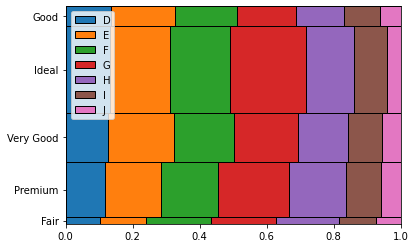

In [9]:

import matplotlib.pyplot as plt
from dabl.datasets import load_titanic
from dabl.plot import mosaic_plot



# Mosaic plot for frequencies of Titanic passengers grouped
# by gender and survival status

mosaic_plot(data, 'cut', 'color')
plt.show()


### pearson group

In [60]:
correlation_pearson_grouped(  data, var_main='x'
                            , var_other=['y','z']
                            , var_group='cut'
                            , method = 'pearson'
                            , round = 3)

,category,y,z
0,Fair,0.994,0.937
0,Good,0.998,0.967
0,Ideal,0.984,0.995
0,Premium,0.938,0.981
0,Very Good,0.999,0.927


### Correlation plot

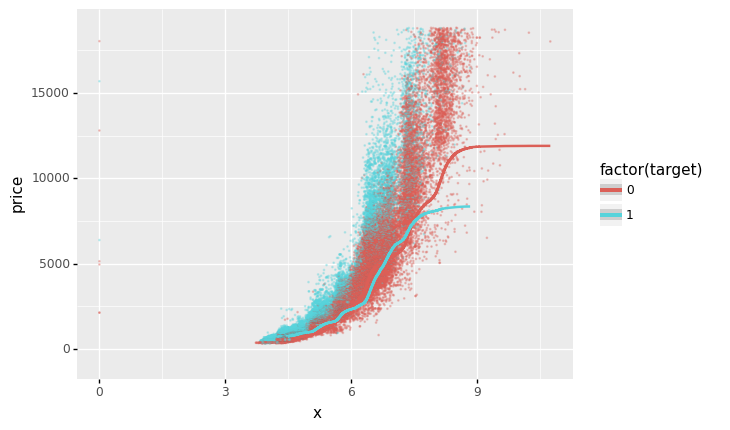

<ggplot: (-9223371890474858916)>

In [50]:
plotnine.options.figure_size = (6.4, 4.8)
(ggplot(data, aes(x='x', y='price', color = 'factor(target)')) +
        geom_point(alpha = 0.3, size = 0.1) +
        geom_smooth(se=True, method="mavg", ymin = None, ymax = None)
)

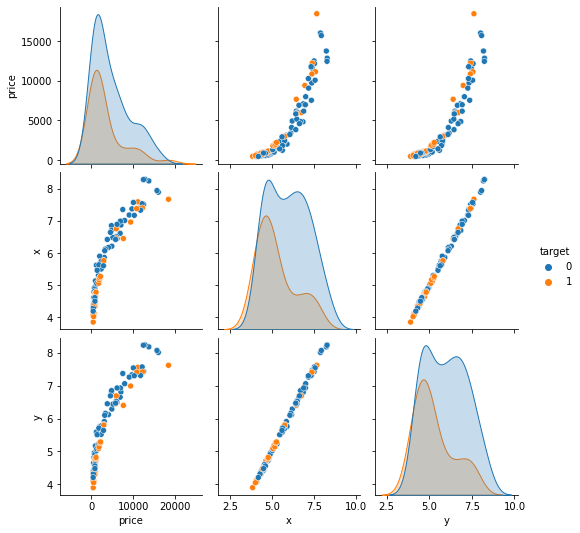

In [63]:
num_vars = ['price','x','target','y']
sns.pairplot(data[num_vars].sample(n=100), hue='target')

## Numerical vs categorical

### ratio

In [10]:
var_x_categorical = ['cut','color','clarity']
var_x_numeric     = ['price','table','depth','x','y','z']

correlation_ratio_matrix(  data     = data
                         , vars_cat = var_x_categorical
                         , vars_num = var_x_numeric
                         , heatmap  = False # currently function with 'True' does not work !
                         , width    = 10
                         , height   = 10
                         , round    = 2)

,price,table,depth,x,y,z
cut,0.11,0.57,0.35,0.19,0.17,0.19
color,0.18,0.06,0.05,0.28,0.28,0.28
clarity,0.16,0.16,0.10,0.38,0.37,0.38


### ratio grouped

In [332]:
correlation_ratio_grouped(data, var_main='x', var_other=['color','clarity','target'], var_group='cut', is_var_main_num = True, round = 4)

,category,color,clarity,target
0,Fair,0.30,0.37,0.22
0,Good,0.23,0.32,0.23
0,Ideal,0.28,0.38,0.26
0,Premium,0.30,0.35,0.24
0,Very Good,0.28,0.39,0.30


### swarm plot

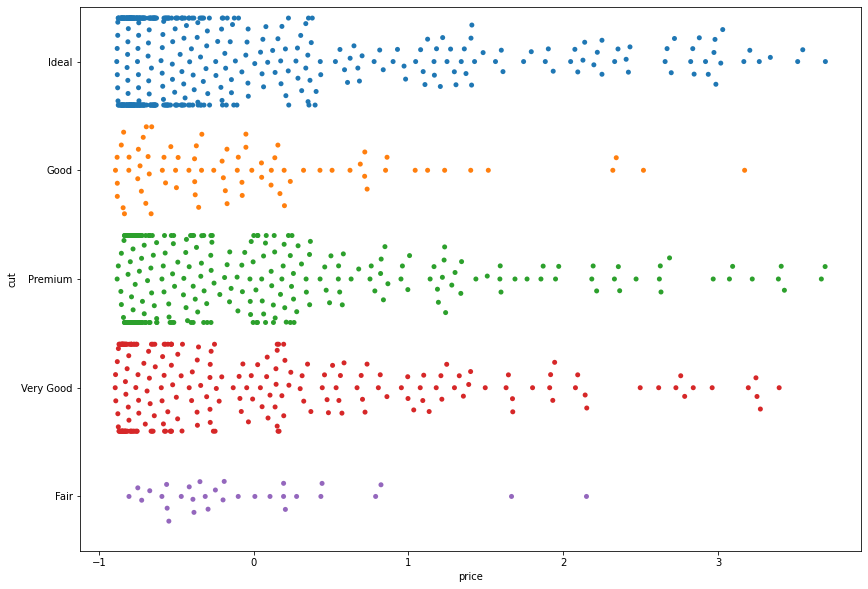

In [293]:
g = sns.swarmplot(y = "cut",
              x = 'price',
              data = data.sample(n=1000),
              size = 5) # Decrease the size of the points to avoid crowding
g.figure.set_size_inches(14,10)

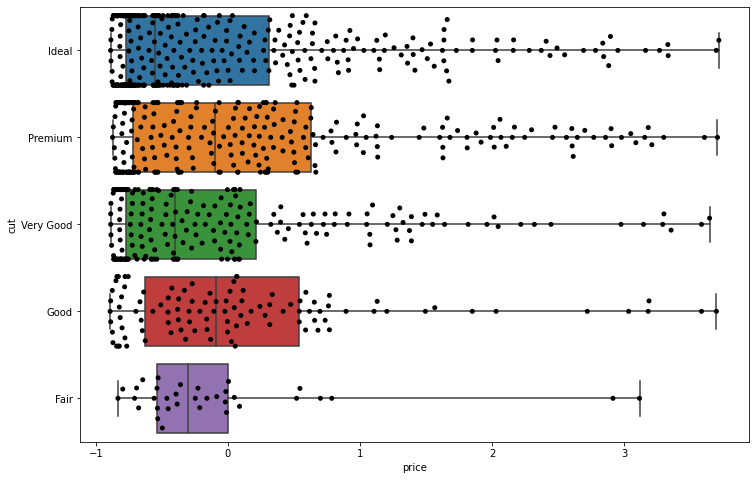

In [294]:
data_sampled = data.sample(n=1000)
num_var = 'price'
cat_vat = 'cut'

g = sns.boxplot(y = cat_vat ,
              x = num_var,
              data = data_sampled
             , whis=np.inf)
g = sns.swarmplot(y = cat_vat ,
              x = num_var,
              data = data_sampled,
              size = 5,color = 'black')
g.figure.set_size_inches(12,8)

## Parallel plot

### Numerical data

In [111]:
import plotly.express as px

# DataFrame of numeric variables
df = data[['price', 'x', 'y', 'z','target']]

# Create the chart:
fig = px.parallel_coordinates(
    df,
    color="target",
    color_continuous_midpoint=2)
fig.show()
#fig.update_layout(coloraxis_showscale=True)

### Categorical data

In [44]:
import plotly.express as px


df = data[['cut', 'color','target']]

fig = px.parallel_categories(df)

fig.show()

## Dimentionality reduction 

### Correspondence analysis for 2 variables

<AxesSubplot:title={'center':'Principal coordinates'}, xlabel='Component 0 (58.36% inertia)', ylabel='Component 1 (35.67% inertia)'>

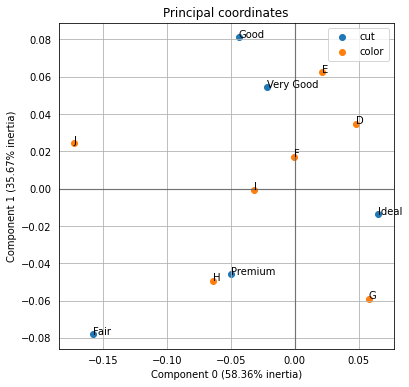

In [84]:
import prince

data_cat = data[['cut', 'color']]





ca = prince.CA(
     n_components = 2,
     n_iter = 3,
     copy = True,
     check_input = True,
     engine = 'auto',
     random_state = 42
)


cross_tab = pd.crosstab(data_cat['cut'], data_cat['color'])
ca = ca.fit(cross_tab)



ca.plot_coordinates(
     X=cross_tab,
     ax=None,
     figsize=(6, 6),
     x_component=0,
     y_component=1,
     show_row_labels=True,
     show_col_labels=True
)

### Correspondence analysis for many variables

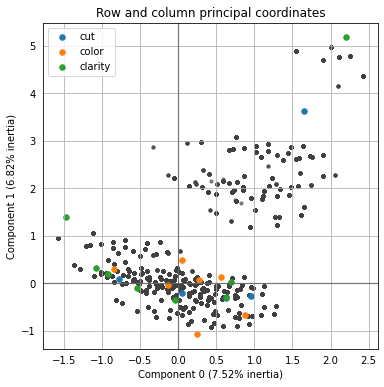

In [88]:
import prince

data_cat = data[['cut','color','clarity']]

mca = prince.MCA(
     n_components=2,
     n_iter=3,
     copy=True,
     check_input=True,
     engine='auto',
     random_state=42
)
mca = mca.fit(data_cat)


ax = mca.plot_coordinates(
     X=data_cat,
     ax=None,
     figsize=(6, 6),
     show_row_points=True,
     row_points_size=10,
     show_row_labels=False,
     show_column_points=True,
     column_points_size=30,
     show_column_labels=False,
     legend_n_cols=1
)

# Analysis - correlation between target and features

## Feature importance (catboost)

In [13]:
vax_y = 'target'
var_x = ['cut', 'color', 'clarity', 'x', 'y', 'z', 'price', 'table']
var_x_categorical = ['cut', 'color', 'clarity']

train_x = data[var_x]
train_y = data[var_y]


feature_importance_class_CB( iterations     = 30
                            , learning_rate = 0.1
                            , depth         = 5
                            , cat_features  = var_x_categorical
                            , x_train       = train_x
                            , y_train       = train_y)



You should provide test set for use best model. use_best_model parameter has been switched to false value.


,Feature Id,Importances
0,clarity,99.898
1,z,0.026
2,price,0.024
3,table,0.020
4,y,0.016
5,x,0.015
6,cut,0.000
7,color,0.000


# Outliers

## Isolation Forest

In [14]:
# categorical variables target encoding
data_recoded = target_encoding(  data  = data
                               , var_x = ['cut','clarity','color']
                               , var_y = 'target'
                               , var_y_convert_to_float = True)

outlieres_IF(  n_estimators = 20
             , x_train = data_recoded[['price','x','cut','clarity','color']])

,carat,cut,color,clarity,depth,table,price,x,y,z,target,target_multi_label,cut_new_encoding,anomaly
0,0.23,0.439,0.315,0.0,61.5,55.0,326,3.95,3.98,2.43,0,0,0,1
1,0.21,0.269,0.315,0.0,59.8,61.0,326,3.89,3.84,2.31,0,1,1,-1
2,0.23,0.243,0.315,1.0,56.9,65.0,327,4.05,4.07,2.31,1,2,2,-1
3,0.29,0.269,0.337,0.0,62.4,58.0,334,4.20,4.23,2.63,0,1,1,1
4,0.31,0.243,0.284,0.0,63.3,58.0,335,4.34,4.35,2.75,0,2,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53935,0.72,0.439,0.234,0.0,60.8,57.0,2757,5.75,5.76,3.50,0,0,0,1
53936,0.72,0.243,0.234,0.0,63.1,55.0,2757,5.69,5.75,3.61,0,2,2,1
53937,0.70,0.337,0.234,0.0,62.8,60.0,2757,5.66,5.68,3.56,0,3,3,1
53938,0.86,0.269,0.320,0.0,61.0,58.0,2757,6.15,6.12,3.74,0,1,1,1


## COPOD  (Copula Based Outlier Detector)

COPOD(contamination=0.1)

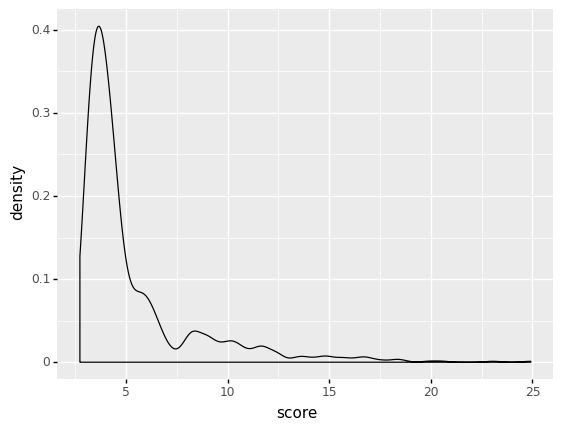

<ggplot: (-9223371897838046656)>

In [295]:
# https://towardsdatascience.com/anomaly-detection-for-dummies-15f148e559c1
# https://h1ros.github.io/posts/anomaly-detection-by-auto-encoder-deep-learning-in-pyod/

from pyod.models.copod import COPOD

clf_name = 'COPOD'
percentage_of_outlieres = 0.1
clf = COPOD(contamination = percentage_of_outlieres)

num_vars = ['price', 'x', 'y', 'z']

x_train = data.iloc[1:1000,:][num_vars]
x_test = data.iloc[1000:2000,:][num_vars]

clf.fit(x_train)

# get the prediction labels and outlier scores of the training data
y_train_pred = clf.labels_  # binary labels (0: inliers, 1: outliers)
y_train_scores = clf.decision_scores_  # raw outlier scores

outliers = pd.DataFrame({'if_outlier':y_train_pred, 'score':y_train_scores})

(ggplot(outliers) + geom_density(aes(x='score')))

# Missing Values

<AxesSubplot:>

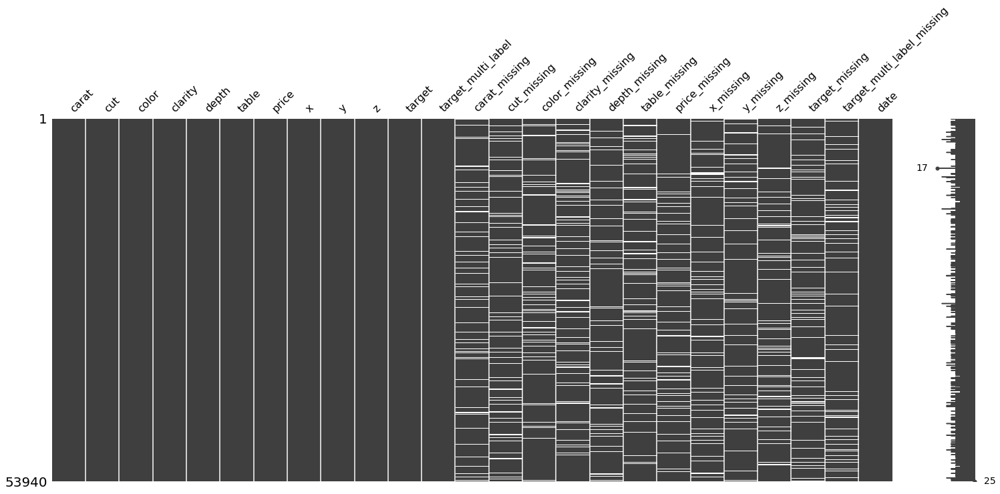

In [97]:
import missingno as msno

msno.matrix(data)

## Univariate

In [117]:
from sklearn.compose import ColumnTransformer
# numeric variables
num_vars = ['x_missing','y_missing']

# categorical variables
cat_vars = ['cut_missing','color_missing']

# imputer for numeric variables
imp_num = SimpleImputer(missing_values=np.nan, strategy='mean') # other stategies: median

# imputer for categorical variables
imp_cat = SimpleImputer(missing_values=np.nan, strategy='most_frequent')

# creating transformer
ct = ColumnTransformer(transformers = [('num', imp_num, num_vars), ('cat', imp_cat, cat_vars)])

# fitting data
data[num_vars + cat_vars] = ct.fit_transform(data[num_vars + cat_vars])



## Multivatiate

In [138]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

num_vars = ['price_missing','x_missing', 'y_missing']

imp = IterativeImputer(max_iter=10, random_state=0) # currently works only for numerical data 

imp.fit(data[num_vars])

data[num_vars] = imp.transform(data[num_vars])


IterativeImputer(random_state=0)

In [170]:
# https://medium.com/@kyawsawhtoon/a-guide-to-knn-imputation-95e2dc496e
from sklearn.preprocessing import StandardScaler

num_vars = ['price_missing','x_missing', 'y_missing']

scaler_x_mean_std = StandardScaler()

ct = ColumnTransformer(transformers = [('scaler', scaler_x_mean_std, num_vars)])
ct.fit(data[num_vars])
data[num_vars] = ct.transform(data[num_vars])


ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                 ['price_missing', 'x_missing', 'y_missing'])])

# IML

## Shapley

In [310]:
# categorical variables target encoding
shap.initjs()
data_recoded = target_encoding(  data  = data
                               , var_x = ['cut','clarity','color']
                               , var_y = 'target'
                               , var_y_convert_to_float = True)


x_train = data_recoded[['price', 'color']]
y_train = data_recoded['target']

sample_size = 1000
model = RandomForestClassifier(  max_depth    = 6
                               , random_state = 0
                               , n_estimators = 10)
  

shapley_value(  model       = model
              , x_train     = x_train
              , y_train     = y_train
              , sample_size = 100)


AttributeError: 'RandomForestRegressor' object has no attribute 'predict_proba'

## Partial Dependence Plot

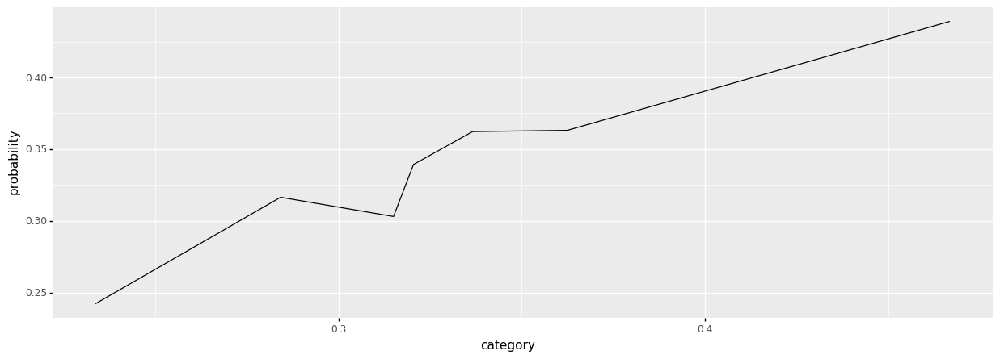

<ggplot: (-9223371917141499700)>

In [391]:
data_recoded = target_encoding(  data  = data
                               , var_x = ['cut','clarity','color']
                               , var_y = 'target'
                               , var_y_convert_to_float = True)

x_train = data_recoded[['price', 'color']]Krzysiu
y_train = data_recoded['target']
model = RandomForestClassifier(  max_depth = 6
                               , random_state = 0
                               , n_estimators = 10)
var = 'color'


PDP_plot_RF(  model   = model
            , x_train = x_train
            , y_train = y_train
            , var     = var)



## ICE

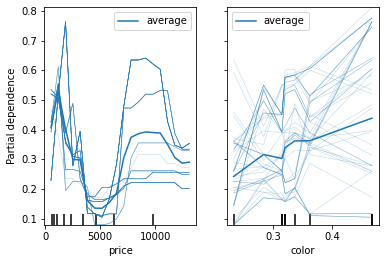

In [104]:
plot_partial_dependence(
       model, x_train, ['price','color'], kind="both", subsample=50,
       n_jobs=3, grid_resolution=20, random_state=0
)

# Model - regression

## train valide test

In [20]:
# sampled (only train and valid)
data1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1 = data1.sample(frac = 1)
data1 = data1.reset_index(drop=True)

# splitting data set into train and test
data_x_train, data_x_test, data_y_train, data_y_test = skl.model_selection.train_test_split(data1, data1[y_var], test_size=0.33)

In [11]:
# sampled (train, valid (I call it test for algoritm internall structure) and test (real test data) )
(data_x_train, data_y_train), (data_x_test, data_y_test), (data_x_rtest, data_y_rtest) = train_test_val_split(  data.drop(columns=var_y)
                                                                                                          , data[var_y]
                                                                                                          , split=(0.2, 0.1) # valid and test size. train size = 1-(valid_size+test_size)
                                                                                                          , shuffle=True)    # random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)

In [111]:
# by date
date_var = 'date'

data_x_train = data.loc[data[date_var] <= pd.Timestamp(2020,1,1)].drop(columns=var_y) 
data_y_train = data.loc[data[date_var] <= pd.Timestamp(2020,1,1), var_y]

data_x_test = data.loc[(data[date_var] > pd.Timestamp(2020,1,1)) & (data[date_var] <= pd.Timestamp(2020,1,2))].drop(columns=var_y) 
data_y_test = data.loc[(data[date_var] > pd.Timestamp(2020,1,1)) & (data[date_var] <= pd.Timestamp(2020,1,2)), var_y]

data_x_rtest = data.loc[(data[date_var] > pd.Timestamp(2020,1,2))].drop(columns=var_y) 
data_y_rtest = data.loc[(data[date_var] > pd.Timestamp(2020,1,2)), var_y]


## Model 1

### Variables and data sets

In [241]:
# variables
y_var     = ['price']                # target
x_var_num = ['x', 'y', 'z']  # numerical features
x_var_cat = ['color','cut']           # categorical features
x_var     = x_var_num + x_var_cat     # all features


train_set = pd.concat([data_x_train[x_var], data_y_train], axis = 1)
test_set  = pd.concat([data_x_test[x_var],  data_y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var]
test_set[y_var]  = test_set[y_var]


### Learning and performance

(3349, 6)
(1650, 6)
int64
int64
int64
int64
int64
int64
int64
int64
int64
int64


You should provide test set for use best model. use_best_model parameter has been switched to false value.


{'learn': {'RMSE': 315.07033714037584}}


,simulation_name,description,x_n,y_name,x_num,x_cat,cat_encoding,simulation_start,simulation_end,performance start,performance end
0,symulacja_1,pierwszy model na wszyskich zmiennych,4,price,"x, y, z",color,target,2021-06-23 23:13:13,2021-06-23 23:13:18,2021-06-23 23:13:18,2021-06-23 23:13:19


None

,Feature,Importance,Importance_abs,l1
0,y,851.160,851.160,0.1
1,x,-164.140,164.140,0.1
2,z,110.080,110.080,0.1
3,color,93.430,93.430,0.1
4,NOISE_normal,5.680,5.680,0.1
5,NOISE_uniform,-1.970,1.970,0.1
6,y,721.130,721.130,0.5
7,z,108.310,108.310,0.5
8,color,93.650,93.650,0.5
9,x,-29.000,29.000,0.5


[None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

,model_name,set_type,_explained_var_score,_max_error,_mean_absolute_er,_mean_gamma_dev,_mean_poisson_dev,_mean_squared_er,_mean_squared_log_er,_mean_tweedie_dev,_median_absolute_er
0,ab,test,0.910,2824.967,203.542,0.012,23.669,66072.638,0.010,66072.638,192.475
1,ab,train,0.921,668.832,203.137,0.007,19.770,61783.698,0.008,61783.698,193.364
2,rf,test,0.917,1806.128,195.202,0.008,19.821,60802.302,0.008,60802.302,177.098
3,rf,train,0.929,1005.321,189.121,0.006,17.710,55478.743,0.007,55478.743,172.203


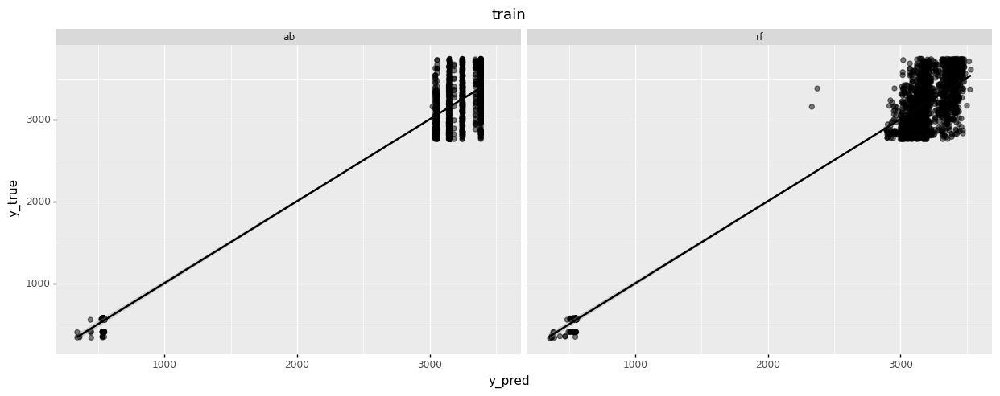

<ggplot: (-9223371891847020068)>

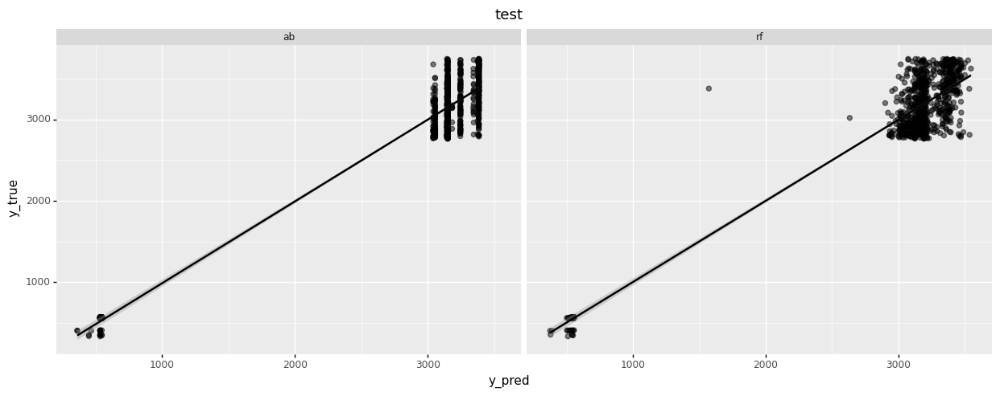

<ggplot: (-9223371891890118016)>

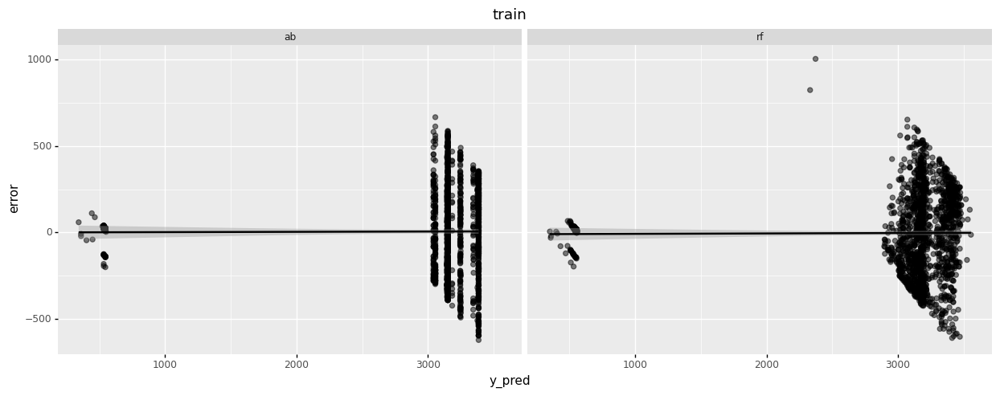

<ggplot: (-9223371891886175524)>

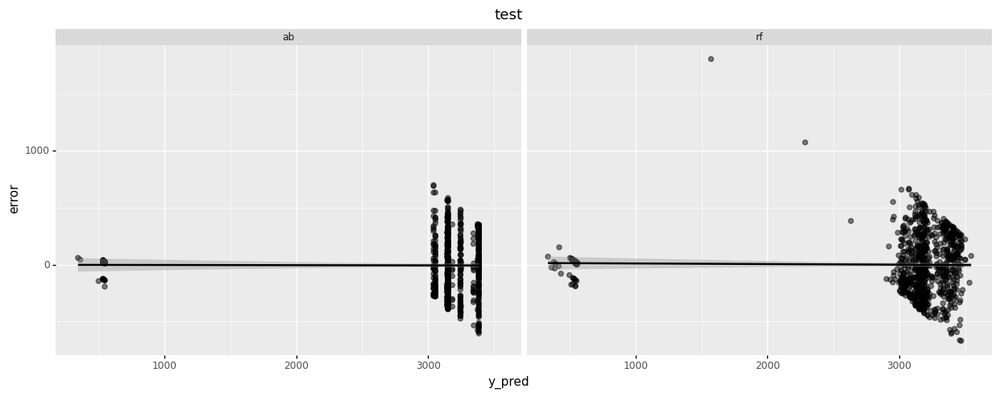

<ggplot: (-9223371891885371800)>

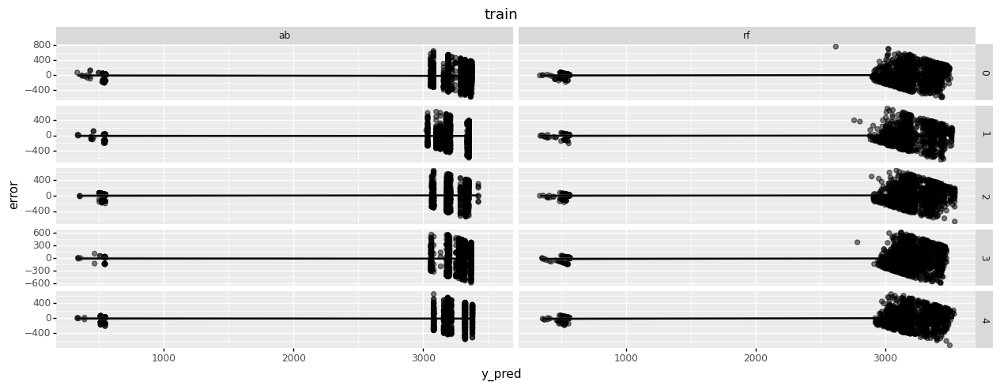

<ggplot: (-9223371891851442832)>

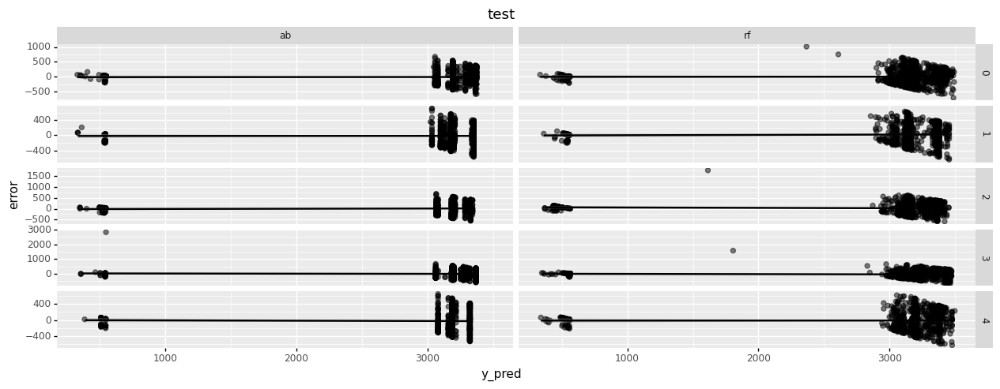

<ggplot: (-9223371891886176436)>

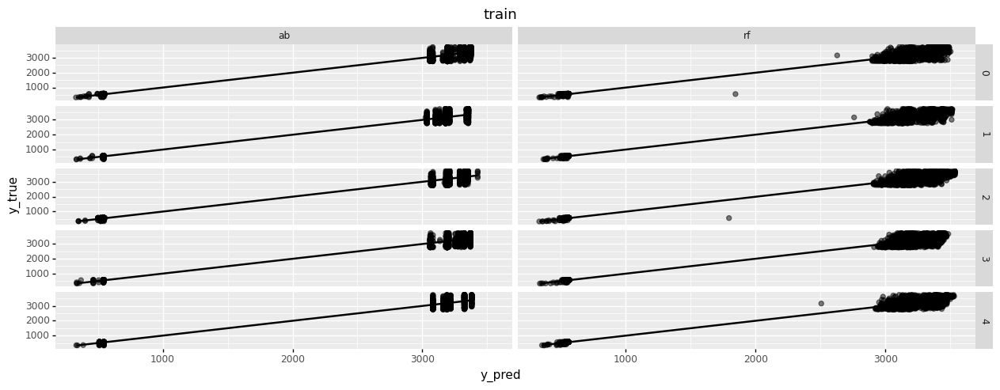

<ggplot: (-9223371891880322348)>

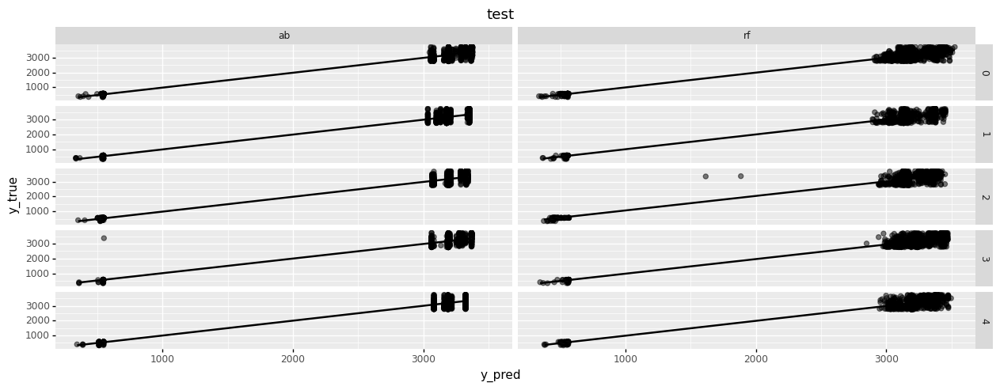

<ggplot: (-9223371891851332172)>

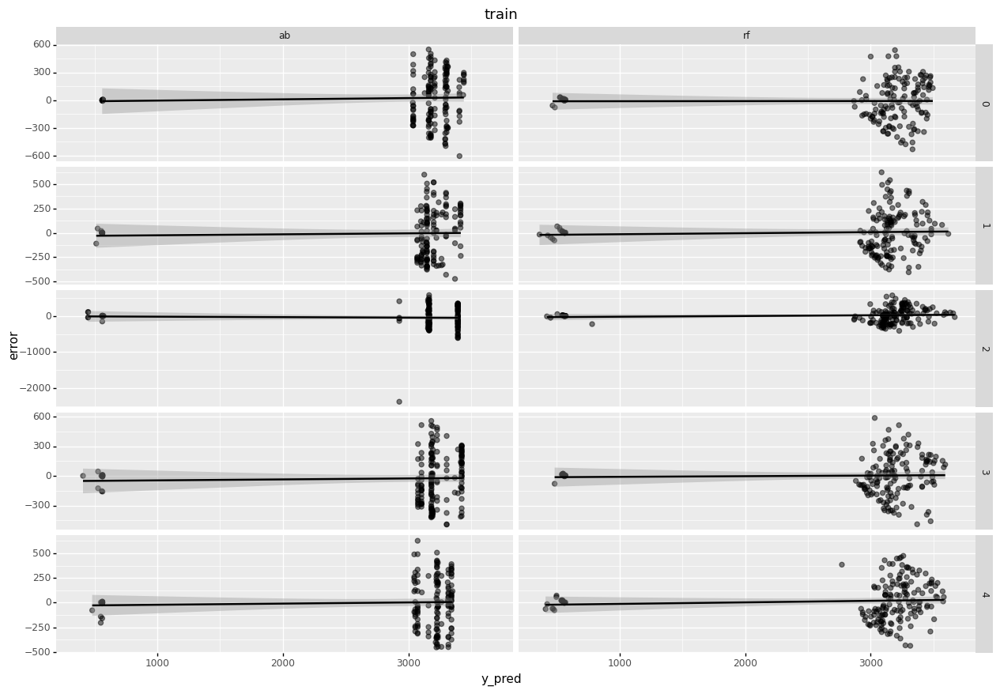

<ggplot: (-9223371891851767736)>

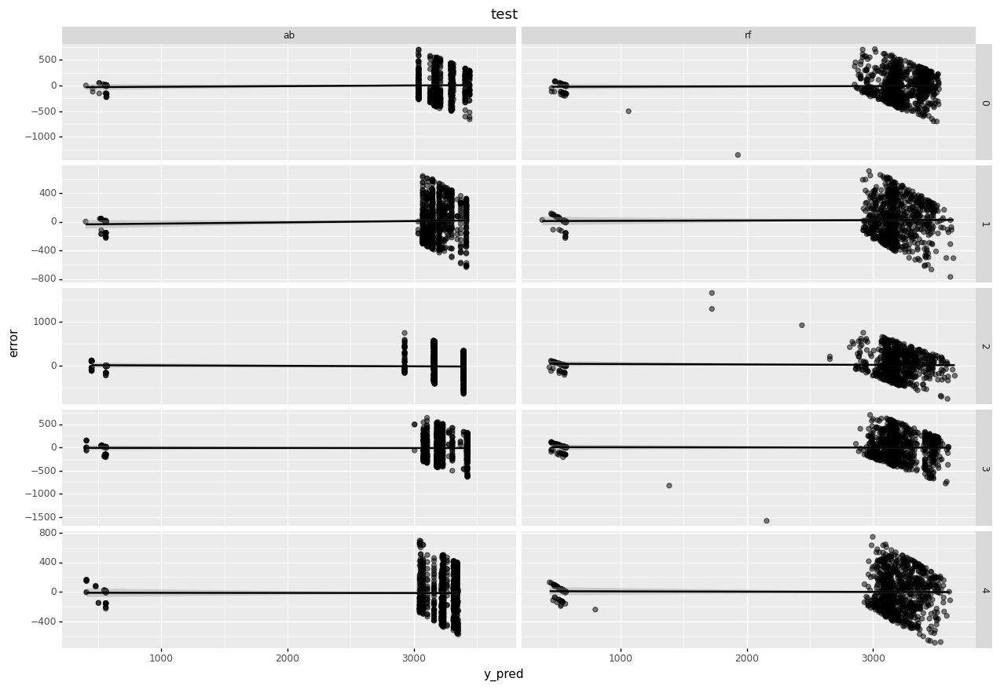

<ggplot: (-9223371891890023952)>

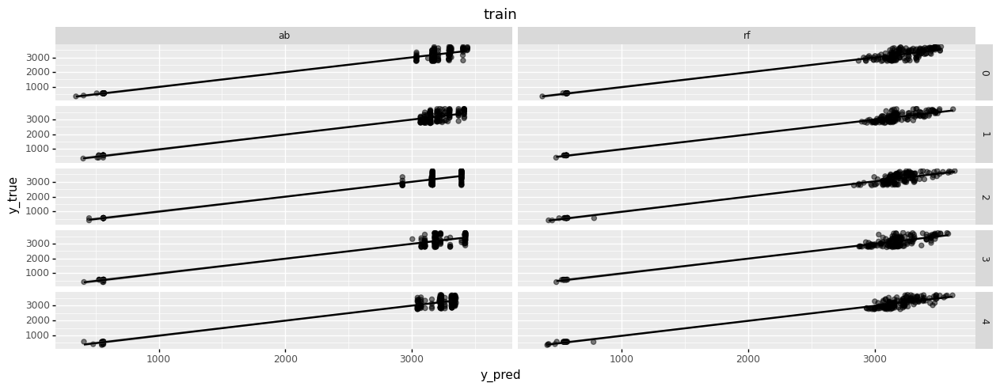

<ggplot: (-9223371891879536048)>

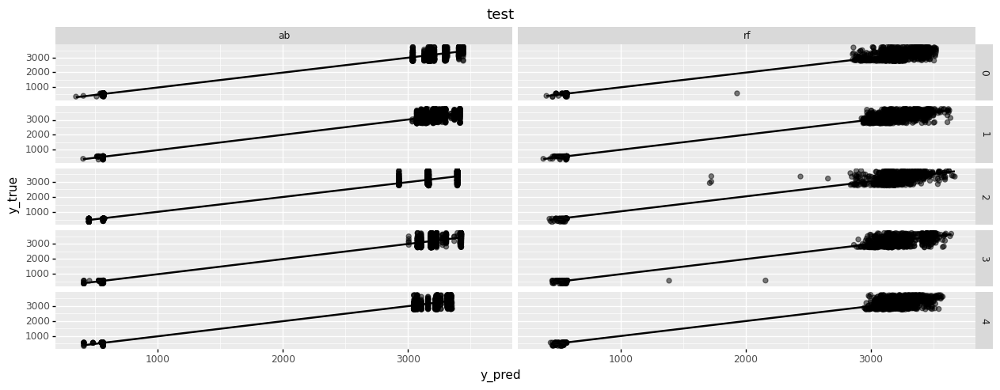

<ggplot: (-9223371891851659384)>

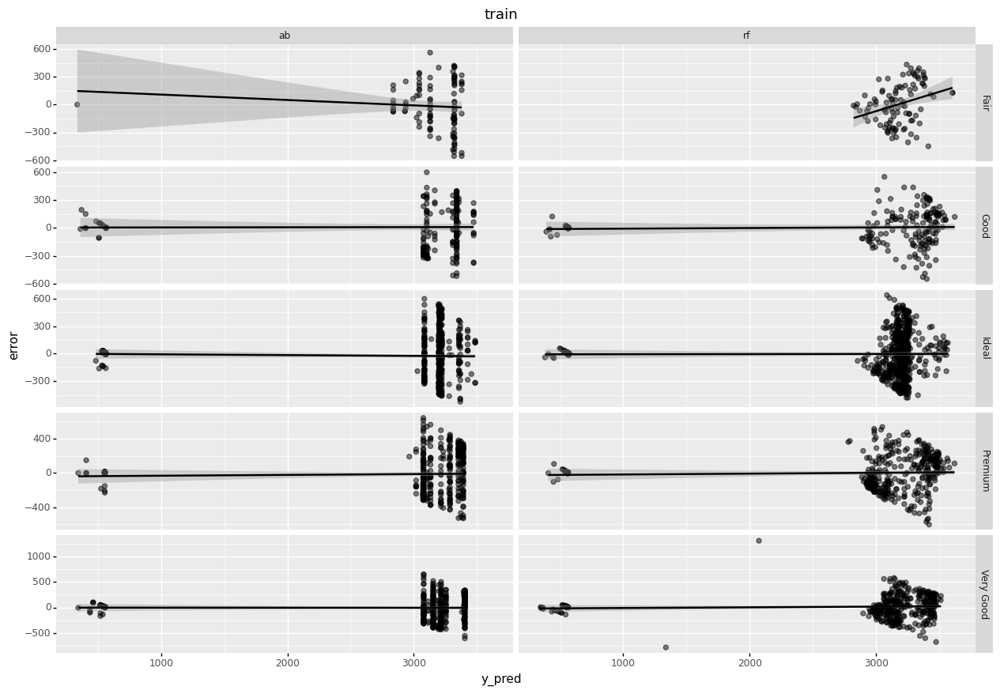

<ggplot: (-9223371891879544428)>

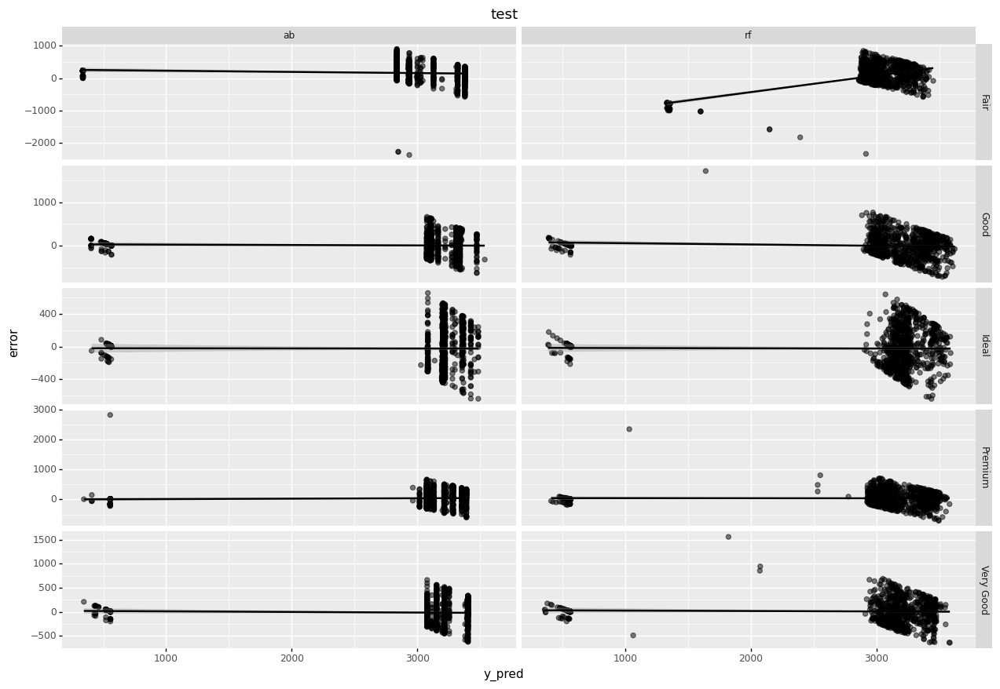

<ggplot: (-9223371891886141212)>

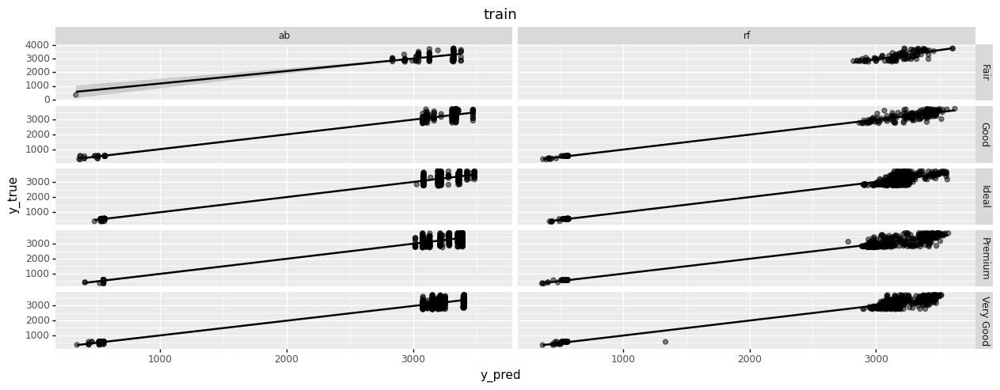

<ggplot: (-9223371891892348364)>

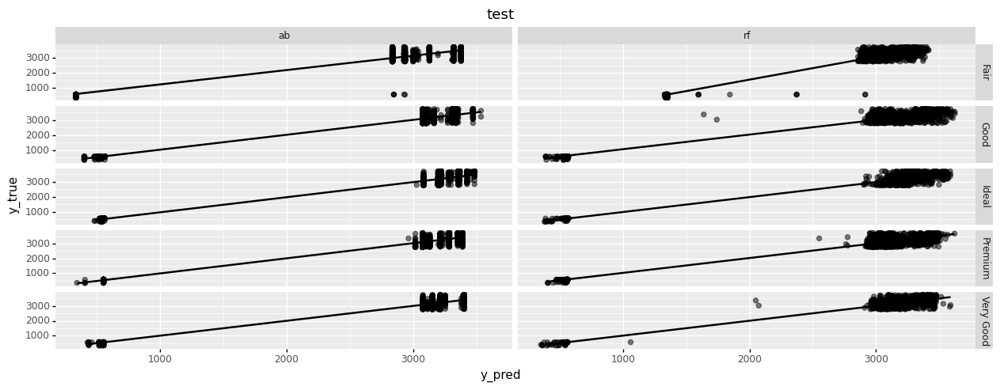

<ggplot: (-9223371891886040248)>

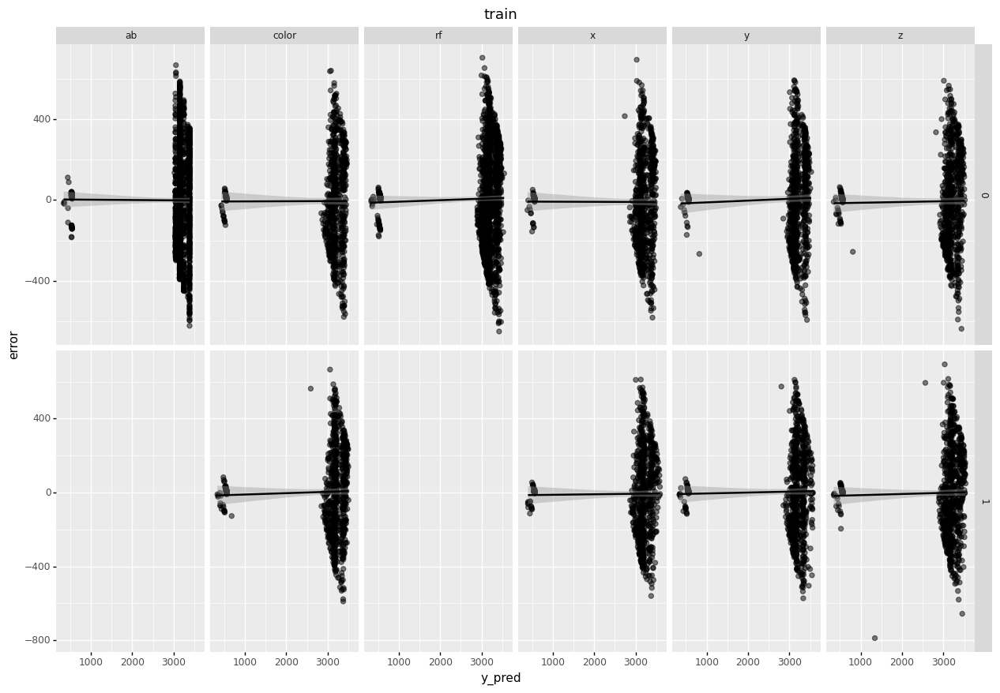

<ggplot: (-9223371891892430972)>

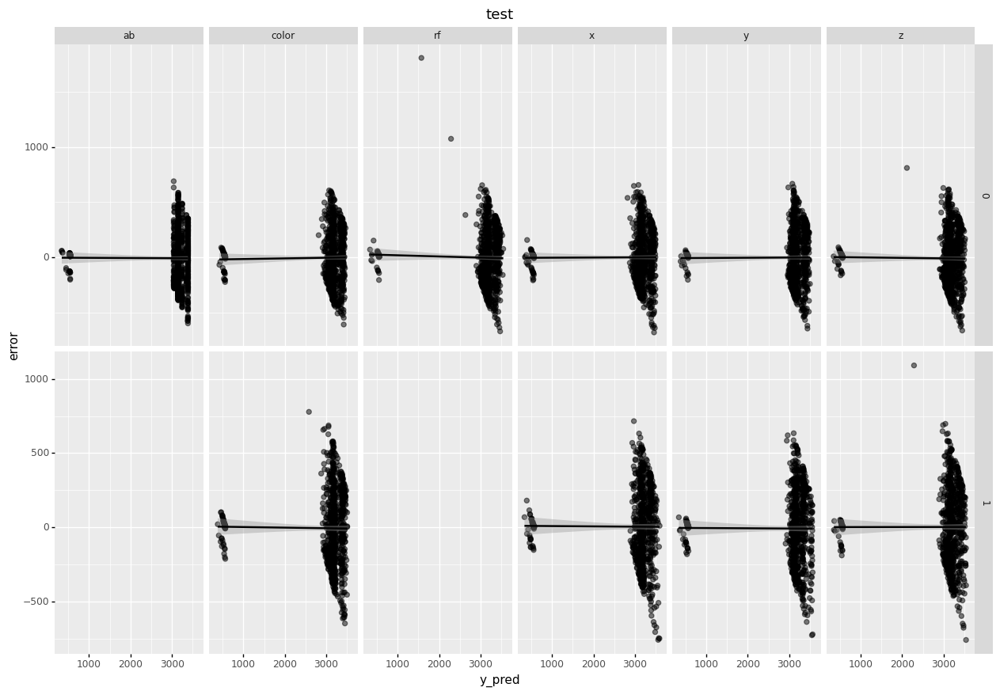

<ggplot: (-9223371891891430824)>

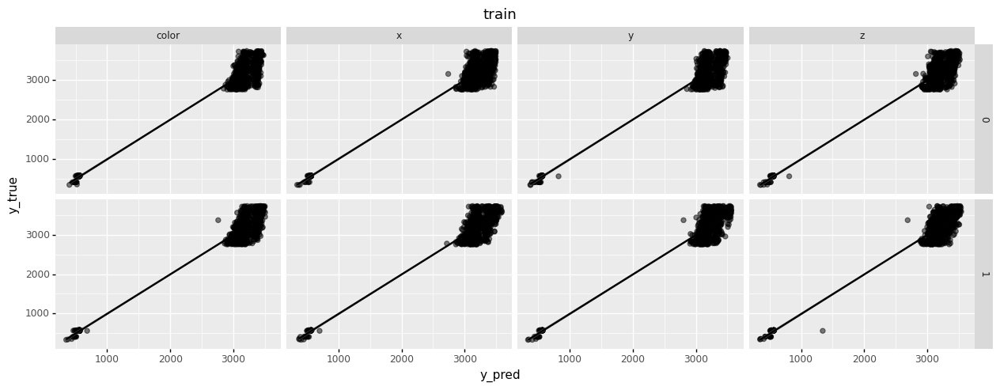

<ggplot: (-9223371891847080768)>

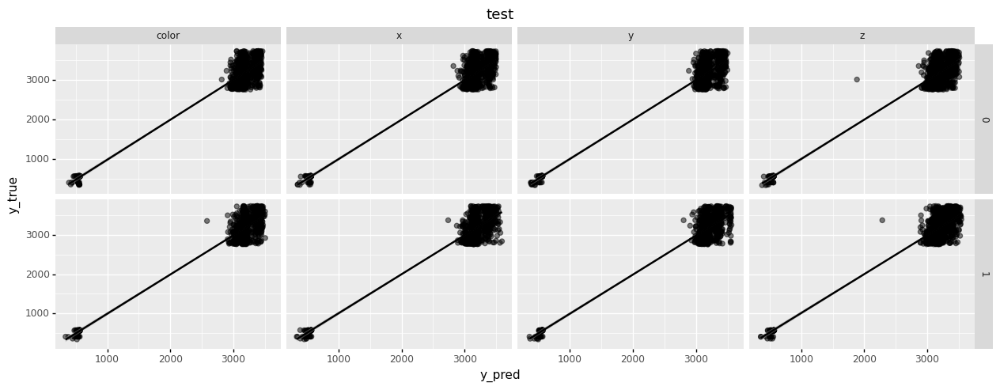

<ggplot: (-9223371891886134540)>

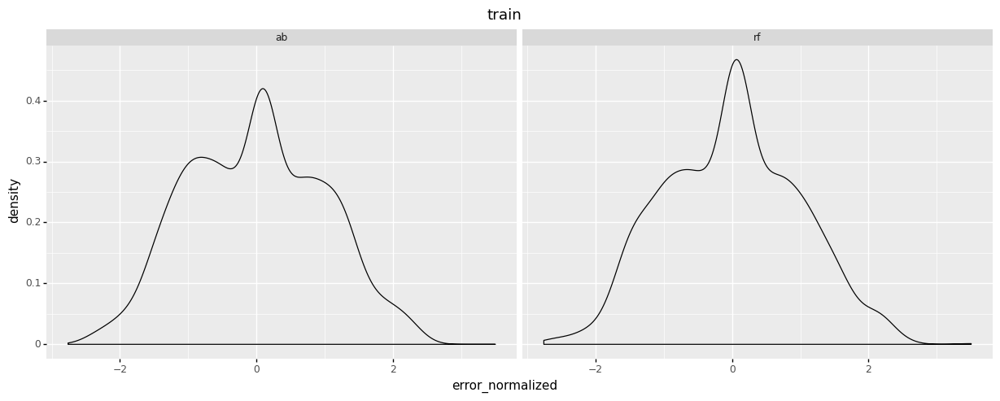

<ggplot: (-9223371891840135332)>

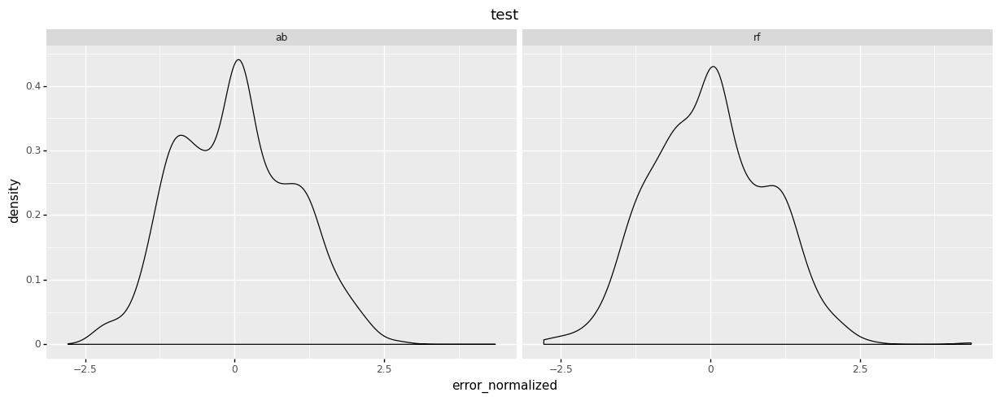

<ggplot: (-9223371891892279064)>

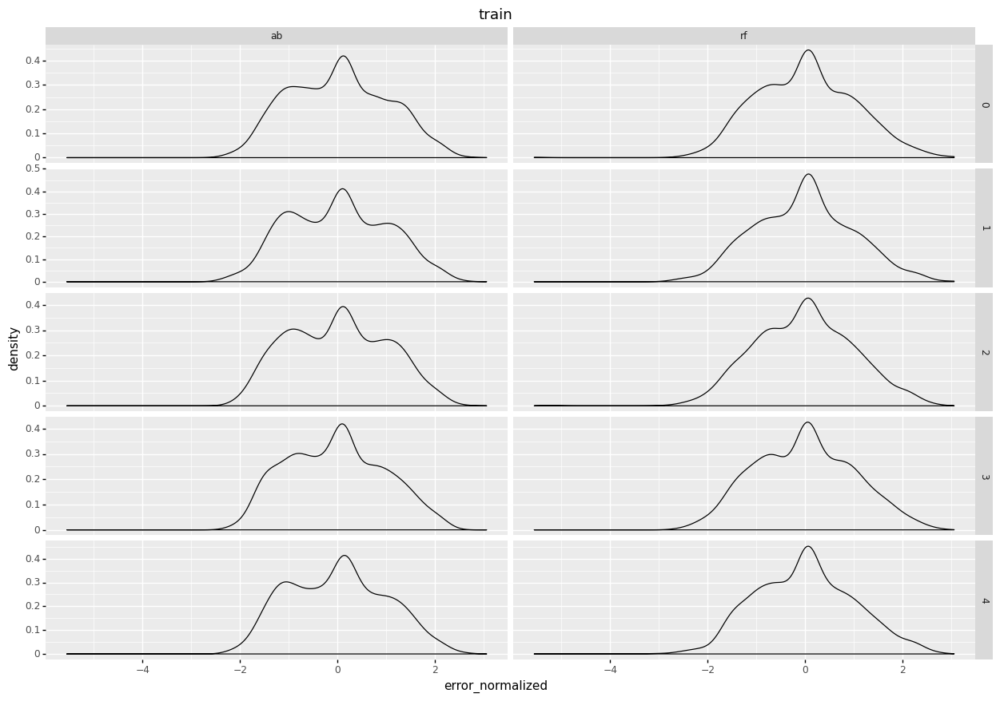

<ggplot: (-9223371891847092328)>

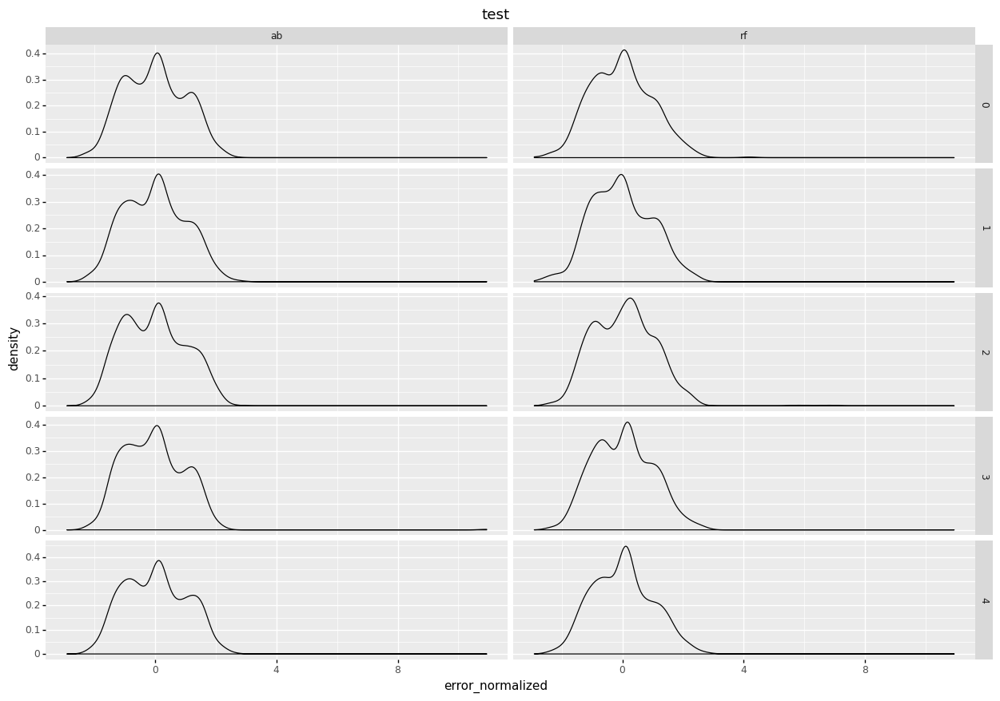

<ggplot: (-9223371891886060444)>

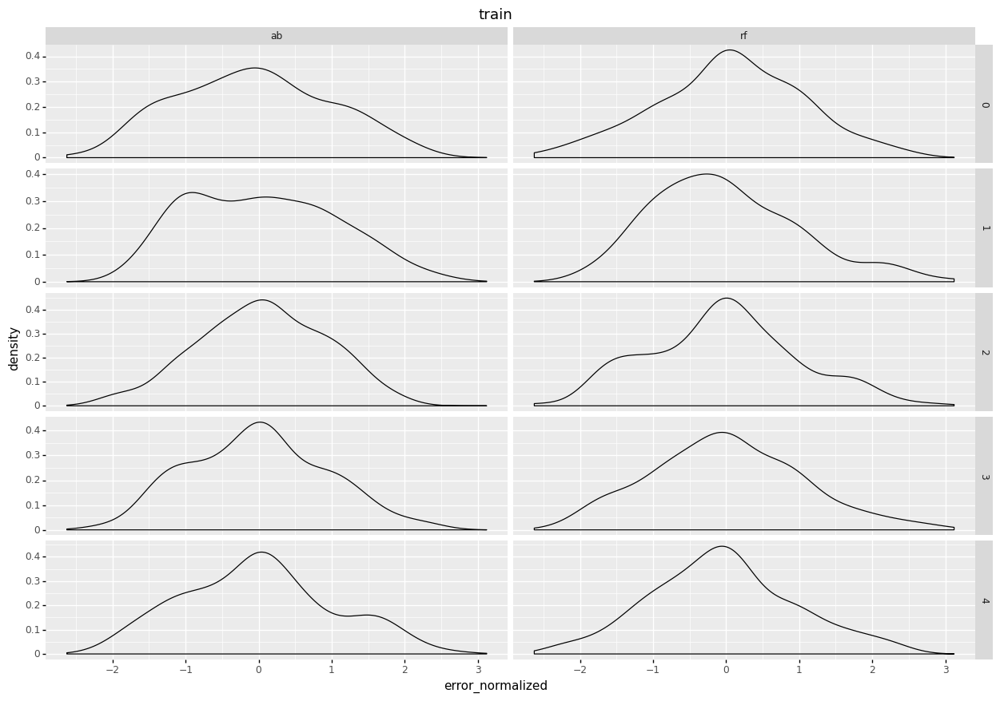

<ggplot: (-9223371891880324636)>

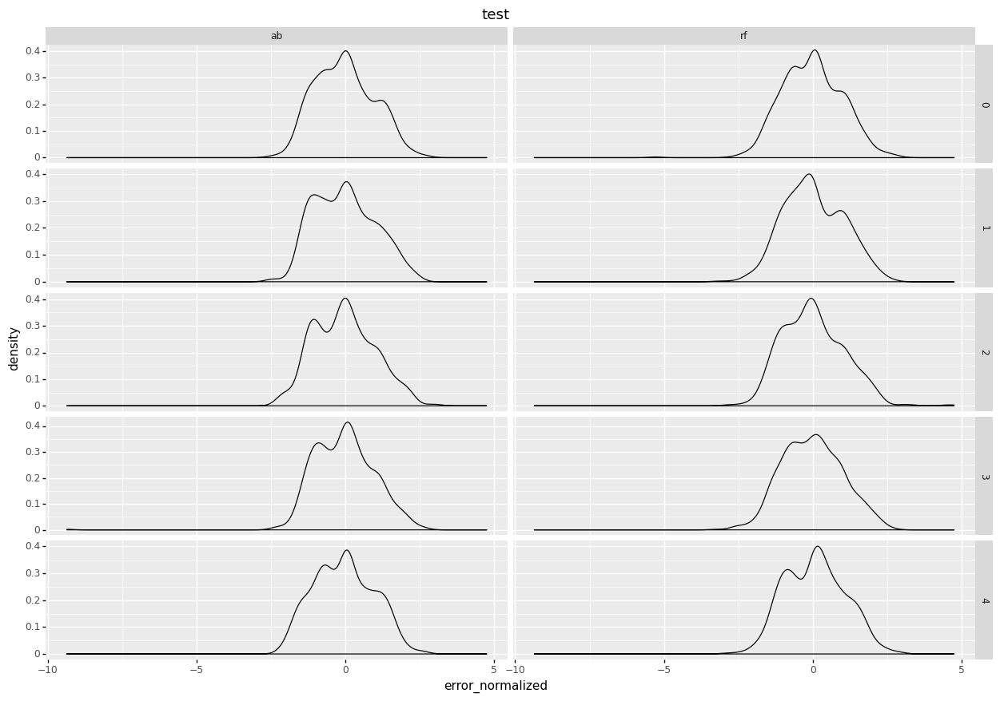

<ggplot: (-9223371891880740892)>

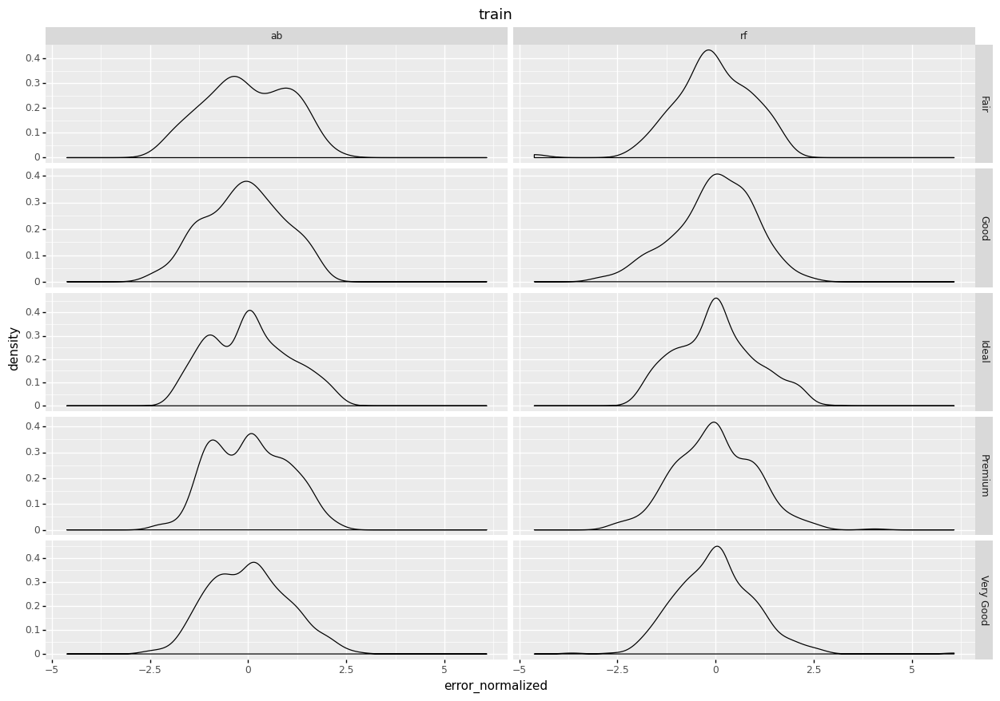

<ggplot: (-9223371891885786716)>

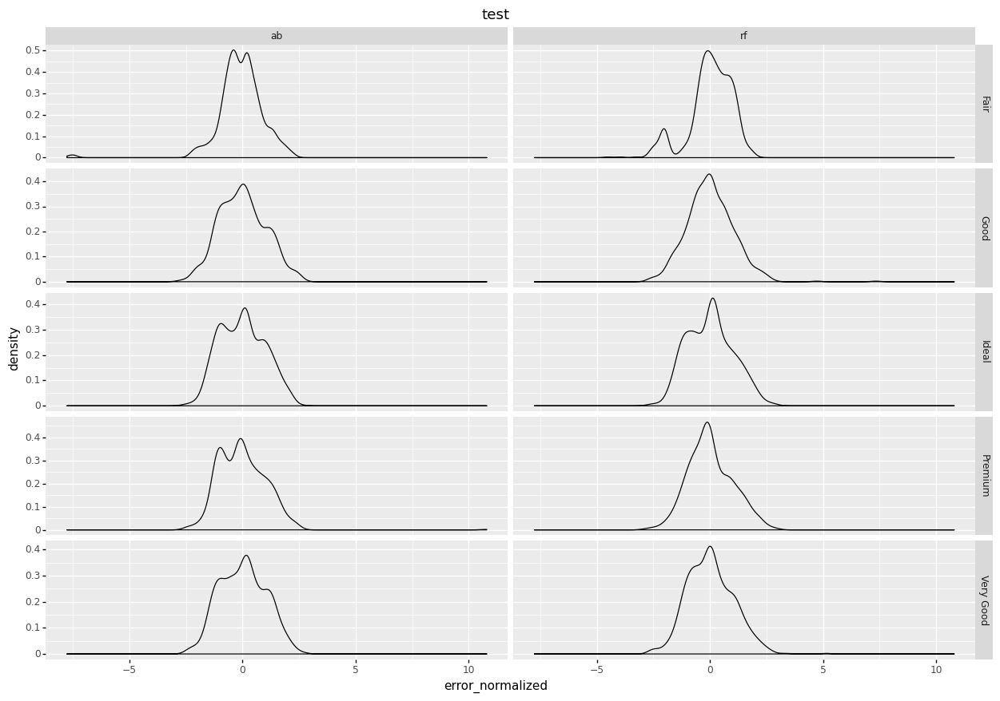

<ggplot: (-9223371891855297100)>

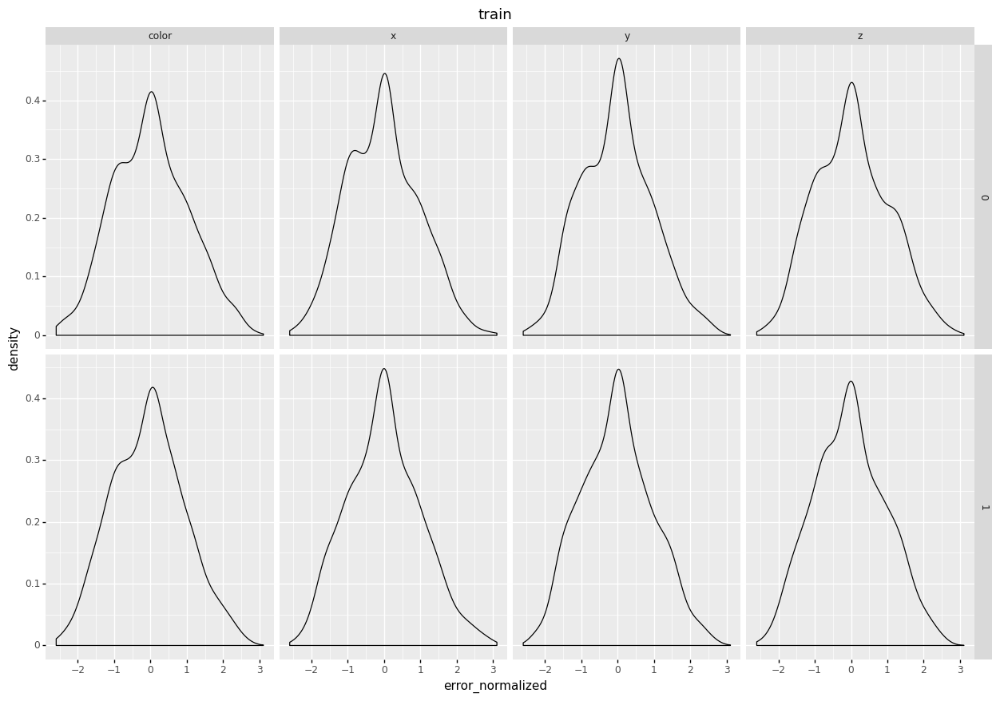

<ggplot: (-9223371891885699372)>

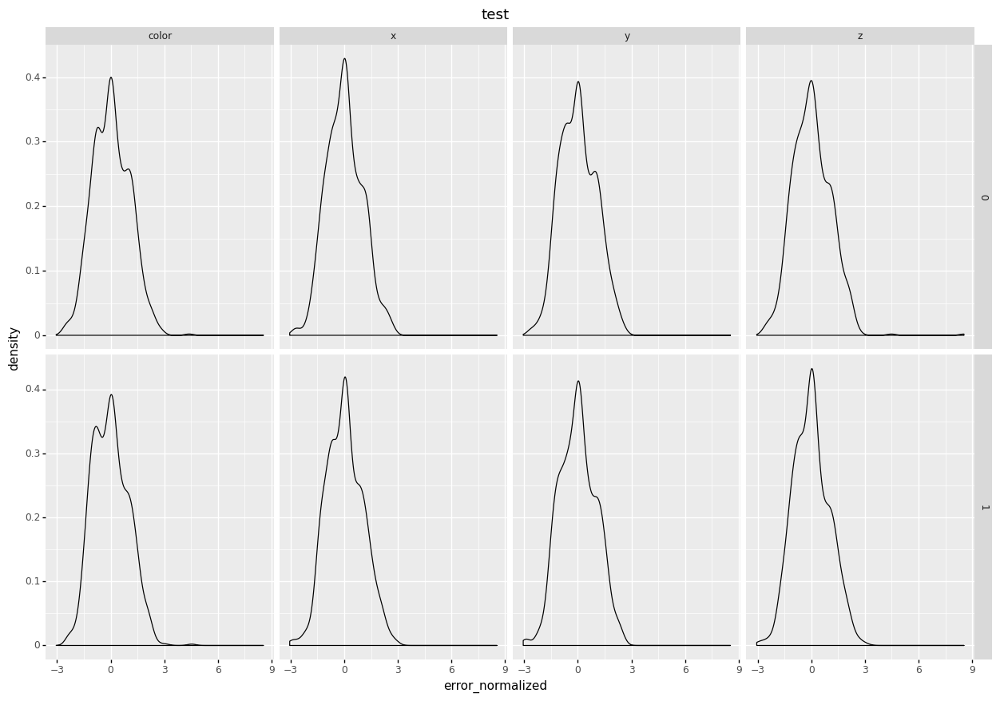

<ggplot: (-9223371891851586684)>

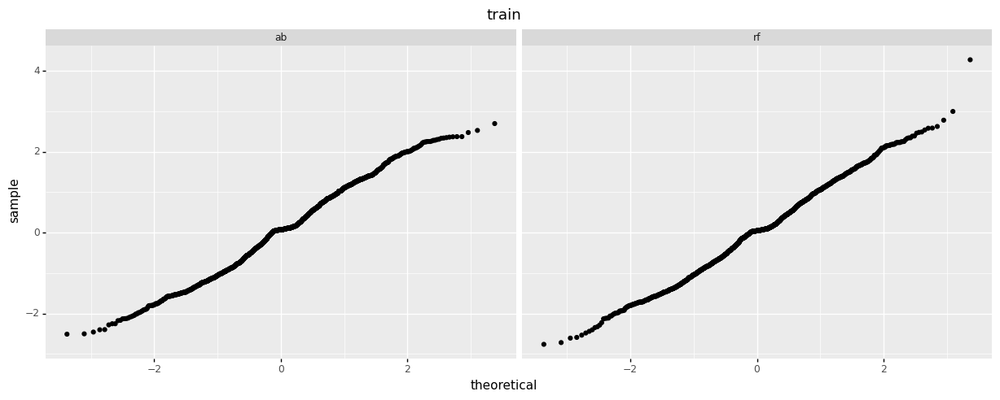

<ggplot: (-9223371891889758048)>

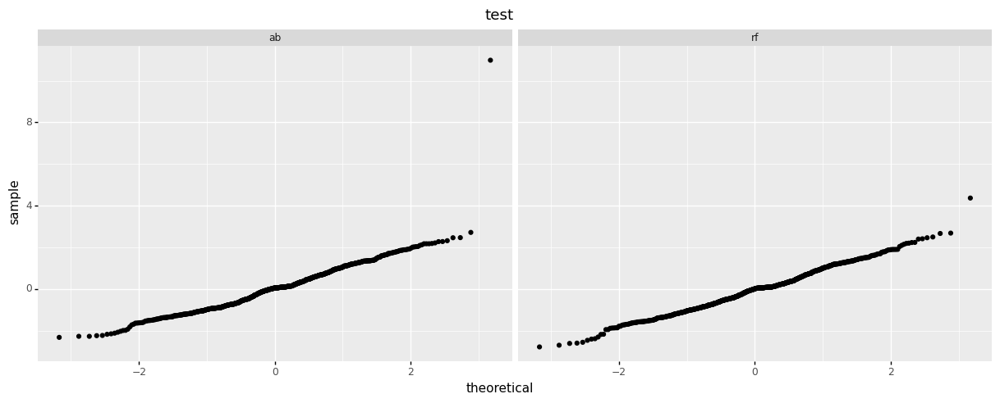

<ggplot: (-9223371891884651016)>

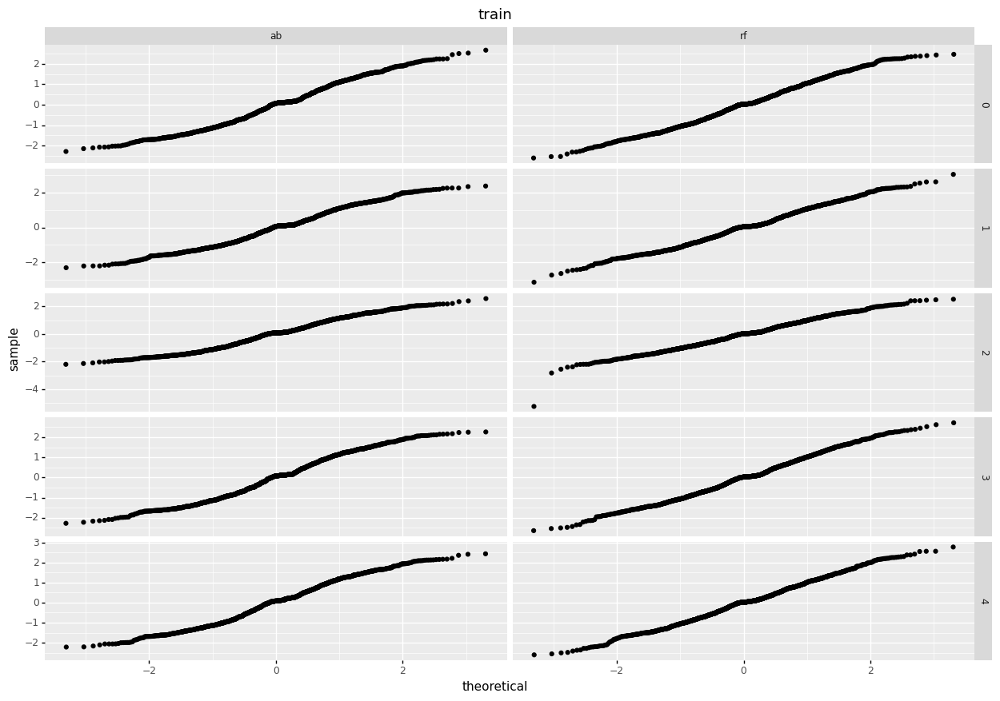

<ggplot: (-9223371891891411428)>

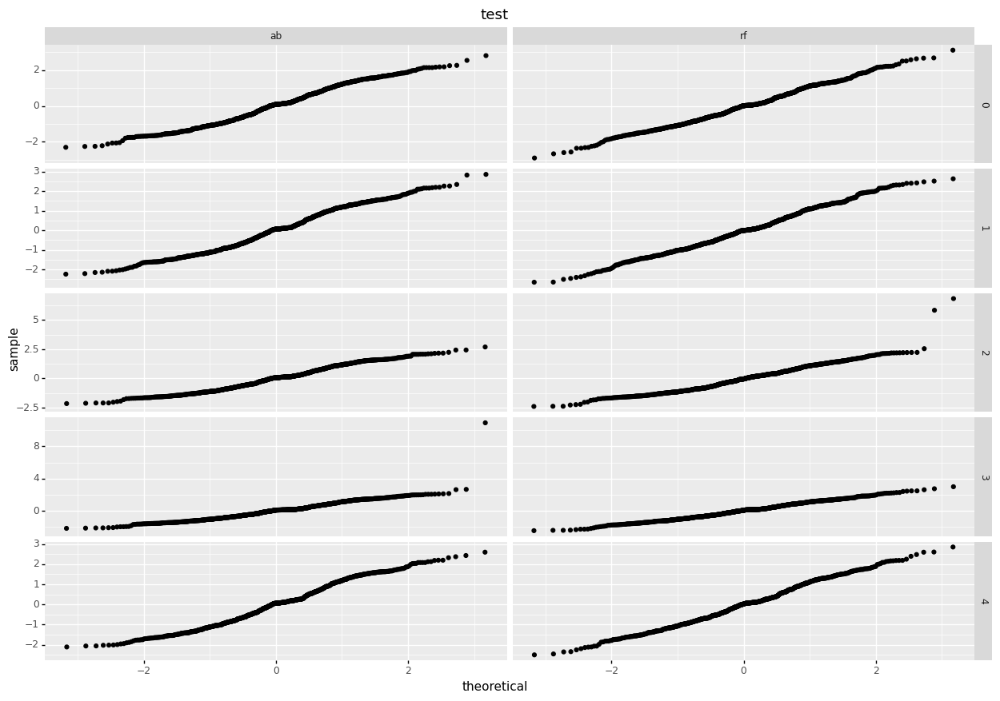

<ggplot: (-9223371891892306024)>

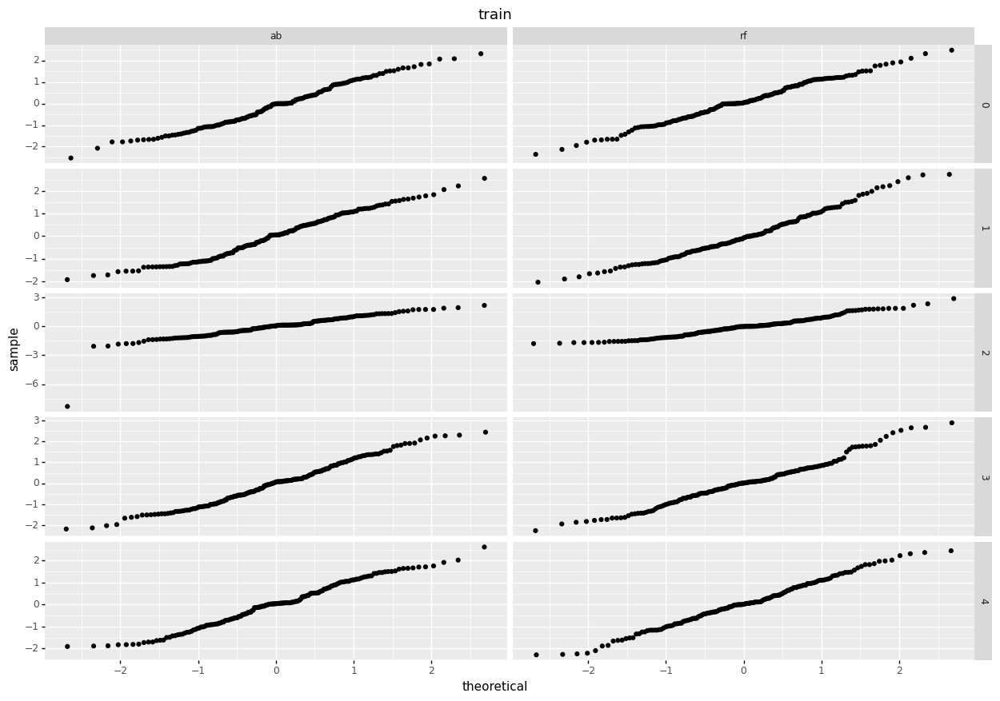

<ggplot: (-9223371891885199088)>

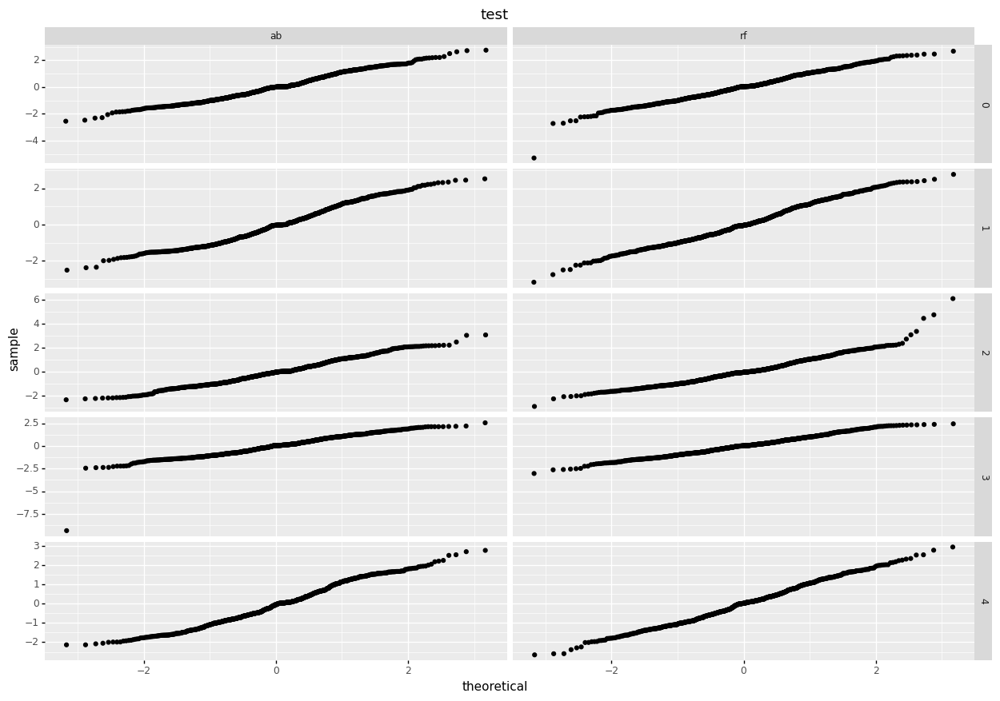

<ggplot: (-9223371891892864672)>

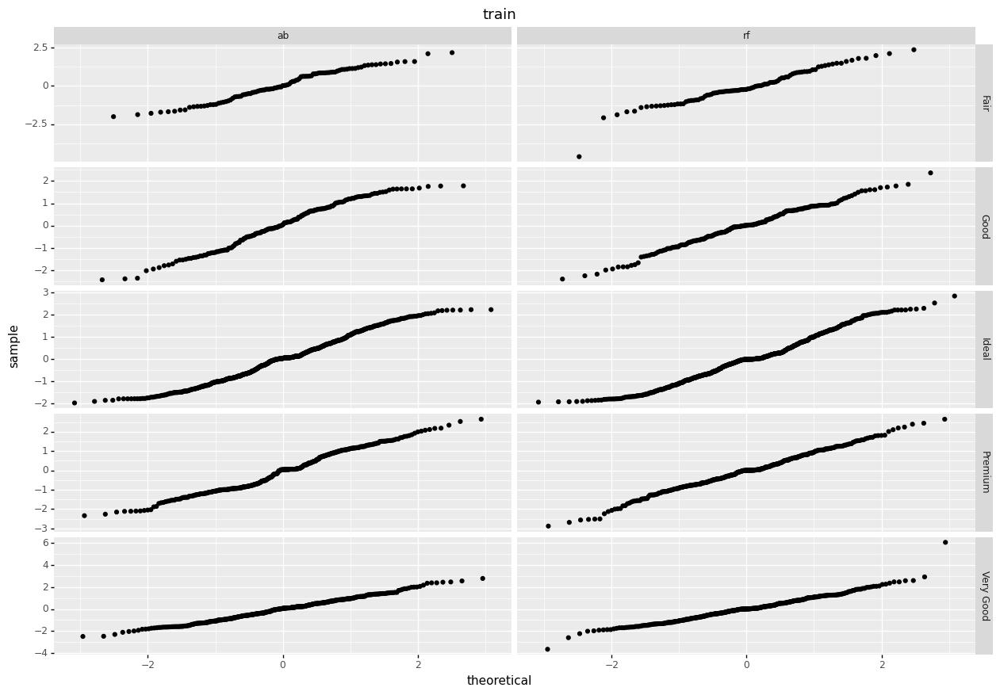

<ggplot: (-9223371891851719928)>

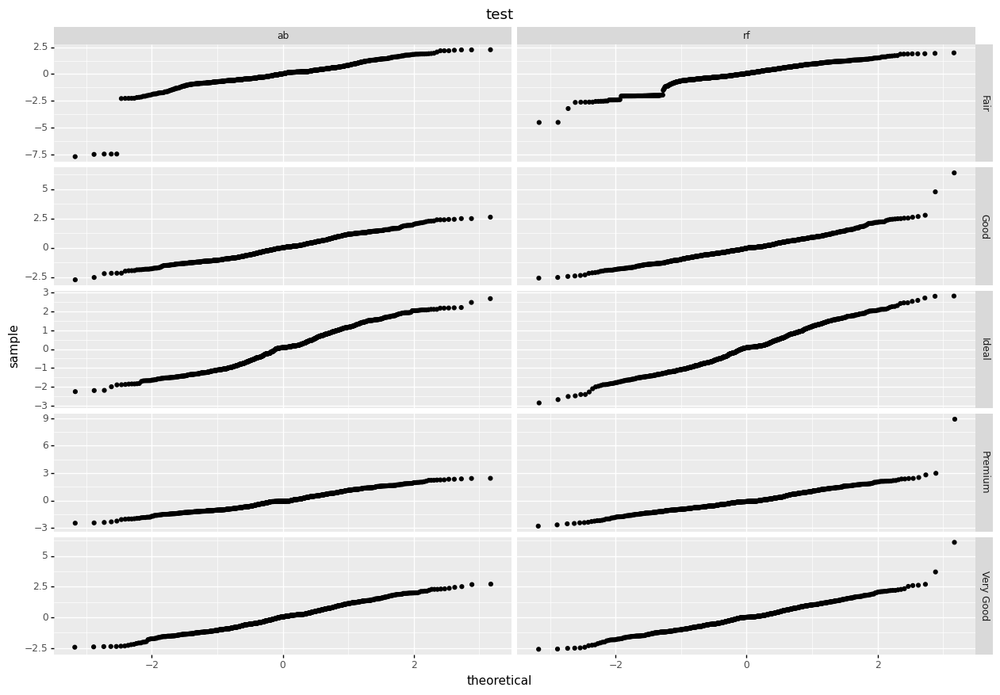

<ggplot: (-9223371891839974592)>

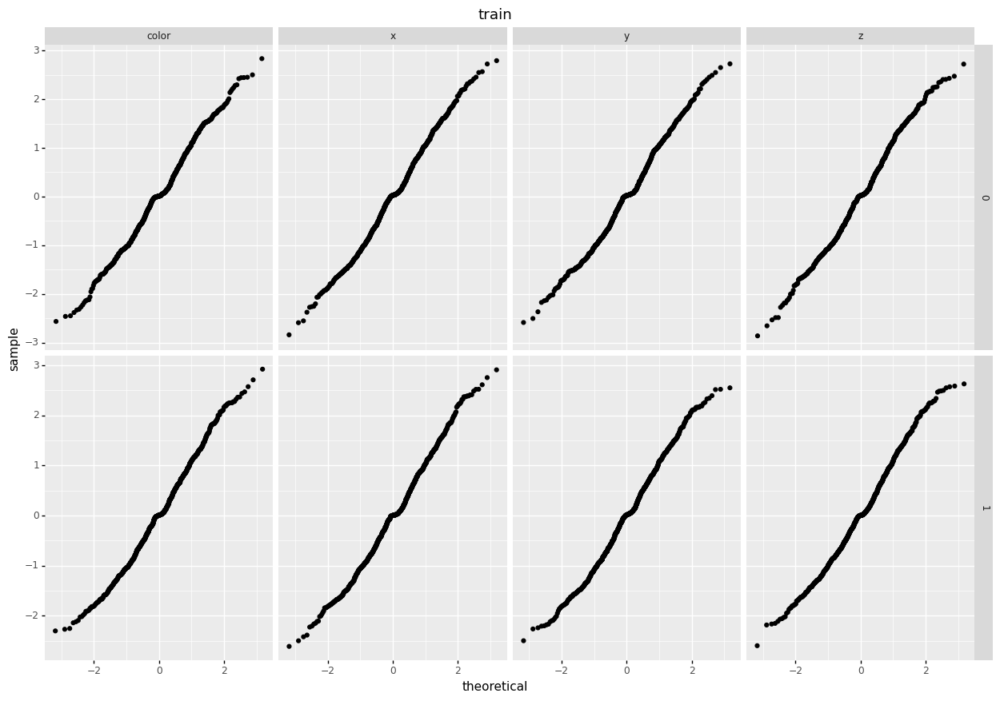

<ggplot: (-9223371891880375492)>

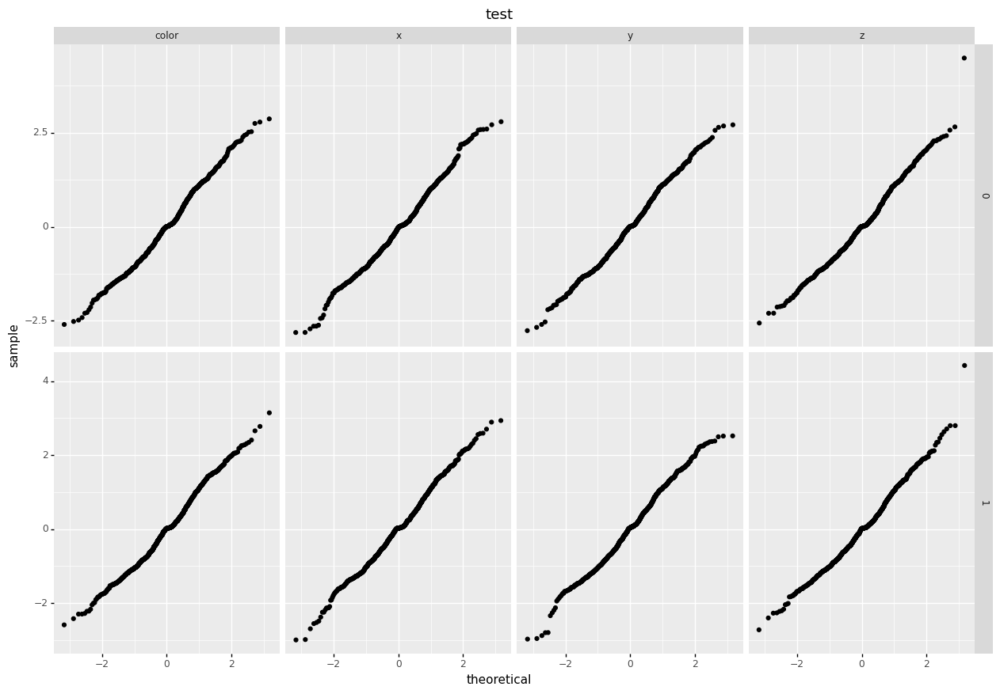

<ggplot: (-9223371891847100320)>

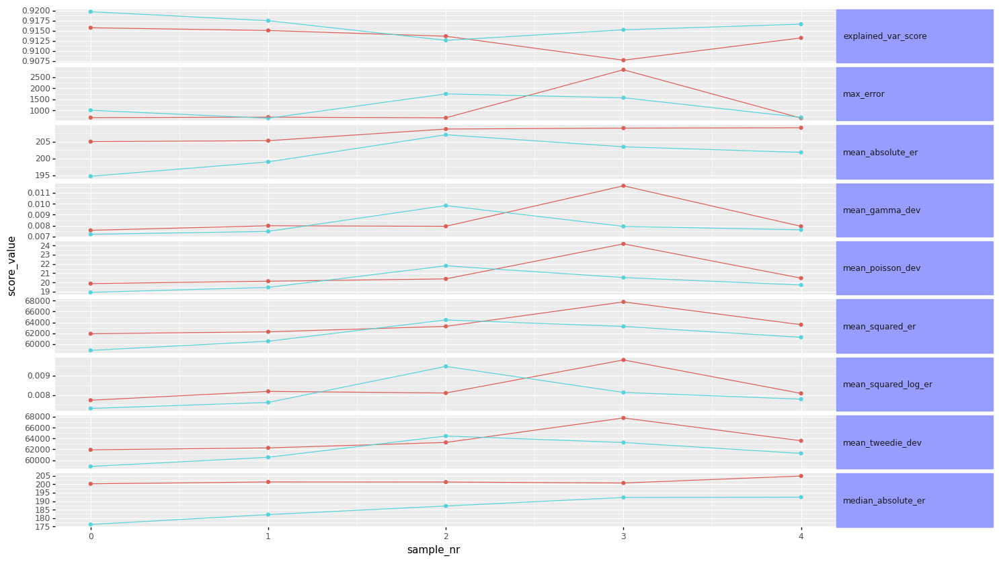

<ggplot: (-9223371891855504192)>

None

,model_name,set_type,sample_type,score_name,max,min,mean,std
0,ab,test,cv,explained_var_score,0.916,0.908,0.913,0.003
1,ab,test,cv,max_error,2828.418,659.419,1110.097,859.294
2,ab,test,cv,mean_absolute_er,209.114,205.022,207.438,1.868
3,ab,test,cv,mean_gamma_dev,0.012,0.008,0.009,0.002
4,ab,test,cv,mean_poisson_dev,24.190,19.877,21.014,1.602
5,ab,test,cv,mean_squared_er,67787.717,61910.965,63762.492,2105.078
6,ab,test,cv,mean_squared_log_er,0.010,0.008,0.008,0.001
7,ab,test,cv,mean_tweedie_dev,67787.717,61910.965,63762.492,2105.078
8,ab,test,cv,median_absolute_er,204.863,200.254,201.697,1.632
9,rf,test,cv,explained_var_score,0.920,0.913,0.916,0.002


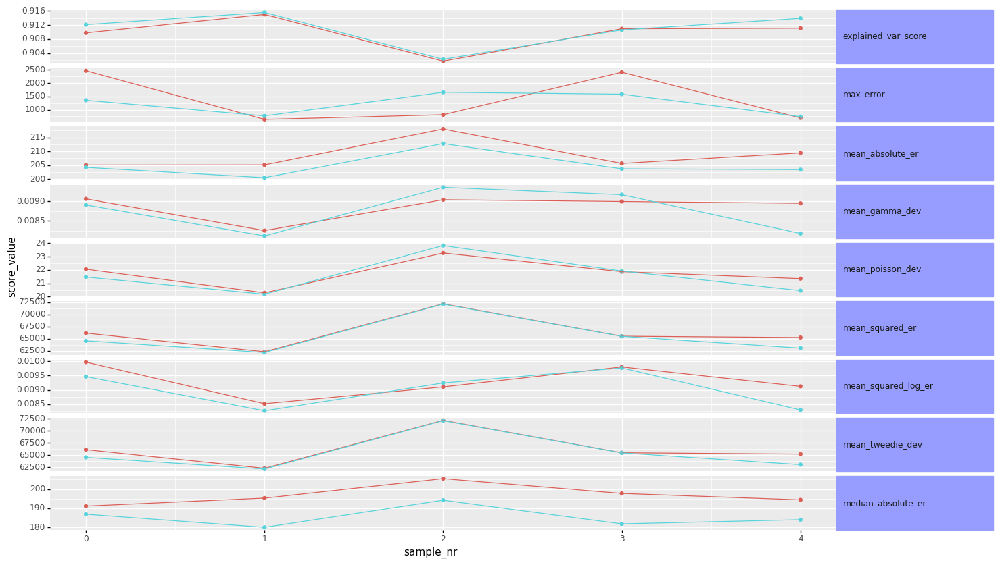

<ggplot: (-9223371891847167272)>

None

,model_name,set_type,sample_type,score_name,max,min,mean,std
0,ab,test,hold,explained_var_score,0.915,0.902,0.910,0.004
1,ab,test,hold,max_error,2462.250,638.931,1403.109,844.273
2,ab,test,hold,mean_absolute_er,218.041,205.087,208.669,4.959
3,ab,test,hold,mean_gamma_dev,0.009,0.008,0.009,0.000
4,ab,test,hold,mean_poisson_dev,23.267,20.286,21.765,0.971
5,ab,test,hold,mean_squared_er,72186.538,62312.985,66285.034,3233.616
6,ab,test,hold,mean_squared_log_er,0.010,0.009,0.009,0.001
7,ab,test,hold,mean_tweedie_dev,72186.538,62312.985,66285.034,3233.616
8,ab,test,hold,median_absolute_er,205.500,191.143,196.817,4.829
9,rf,test,hold,explained_var_score,0.916,0.902,0.911,0.005


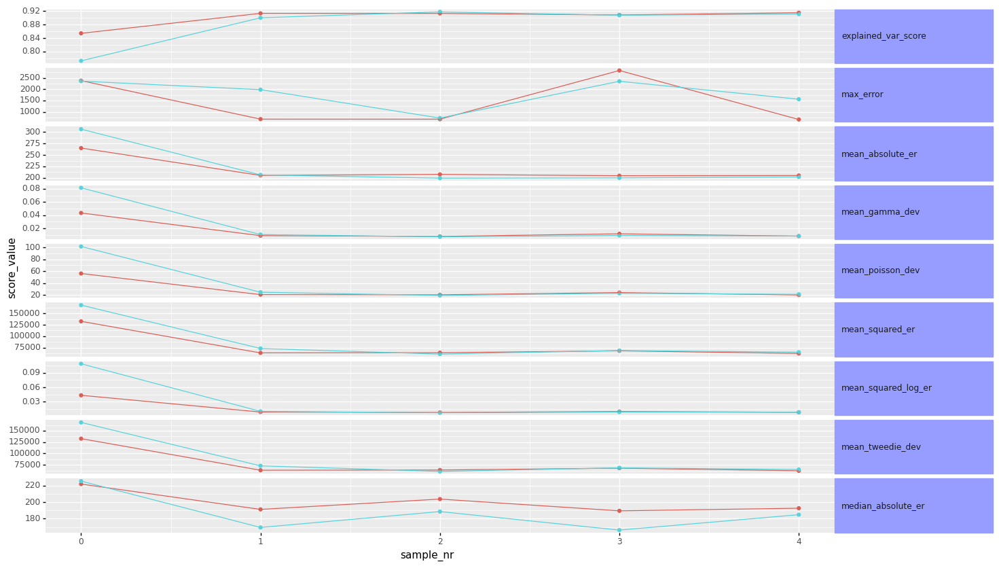

<ggplot: (-9223371891839757660)>

None

,model_name,set_type,sample_type,score_name,max,min,mean,std
0,ab,test,by_var,explained_var_score,0.916,0.854,0.901,0.024
1,ab,test,by_var,max_error,2823.478,662.445,1443.546,954.473
2,ab,test,by_var,mean_absolute_er,265.058,204.698,217.599,23.751
3,ab,test,by_var,mean_gamma_dev,0.043,0.008,0.016,0.014
4,ab,test,by_var,mean_poisson_dev,56.248,20.201,28.400,14.001
5,ab,test,by_var,mean_squared_er,132538.785,62049.710,77904.572,27386.597
6,ab,test,by_var,mean_squared_log_er,0.044,0.008,0.016,0.014
7,ab,test,by_var,mean_tweedie_dev,132538.785,62049.710,77904.572,27386.597
8,ab,test,by_var,median_absolute_er,222.016,189.545,199.881,12.138
9,rf,test,by_var,explained_var_score,0.918,0.773,0.882,0.055


In [249]:
%run "modules/F_regression.py"
# PARAMETERS FOR 'LEARNING THE MODEL'
simulation_name        = 'symulacja_1' # unique simulation name
simulation_description = 'pierwszy model na wszyskich zmiennych' # simulation description
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # dictionary with model we want to use. Elements selected from variable 'model_base'
cv_n                   = 5     # cross validation: number of k-folds ('None' if not to use)
hold_n                 = 5     # holdout validation: number of samples ('None' if not to use)
hold_train_sample_size = 0.1   # holdout validation: size of train set sample in percentage
hold_test_sample_size  = 0.1   # holdout validation: size of test set sample in percentage
fip_n                  = 2  # feature importatnce permutation validation:  number of samples ('None' if not to use. If we want to use it, it is recommended to provide value 1)
fip_type               = 'remove' # (currently available:'permutate_train', 'remove')
model_fip              = RandomForestRegressor(n_estimators=20, max_depth=7) # feature importatnce permutation validation: prividing the model
by_var                 = 'cut' # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var ('None' if not to use ). Uwaga: ta zmienna nie będzie uwgdlęniona w statystykach (np. w korelacjach)
cat_encoding_method    = 'target' # features encoding algorithm (currently available: 'target', 'None')


# INITIALIZATION of new object for simulation (needed only in the first simulation - next simulation carry out with the same object to store all results in one place)
c1 = classification_model()

# MODEL LEARNING (determining only probabilities)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , cv_n=cv_n, fip_n=fip_n, fip_type = fip_type, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)



c1.performance(simulation_name=simulation_name, filter_test_indicies=None, loops_progress=False)

 
# SAVING results on disk
# c1.save_results(path = r'C:\Users\memy\OneDrive\Pulpit\1_Programs_and_programing\DS_proj\classification_python\results\symulacja_1', override = True)

# LOADING results from disk (into empty object)
# c1.load_results(path = '...')

# RESULTS VISUALISATION
c1.summary_big(simulation_name, cv_n, hold_n, by_var, fip_n)

# Models aggregations

## Results aggregation

Zakładam że mam dwa różne modele na rozłączych zbiorach danych i chce uzyskać dla nich zagregowaną macierz pomysłek i scory

### Model 1

In [282]:
# variables
y_var     = ['price']  # target
x_var_num = ['y', 'z']              # numerical features
x_var_cat = ['color','clarity']     # categorical features
x_var     = x_var_num + x_var_cat   # all features

# data set for the first model
data_model_1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data_model_1=data_model_1.sample(frac = 1)
data_model_1=data_model_1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data_model_1[x_var], data_model_1[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var]
test_set[y_var]  = test_set[y_var]

In [283]:
%run "modules/F_regression.py"
# PARAMETRY SYMULACJI DO 'UCZENIA MODELI'
simulation_name        = 'symulacja_1_do_agreg' # unikalna nazwa symulacji
simulation_description = 'symulacja pierwsza do agregacji' # opis symulacji
models_list            = {'rf':models_base['rf'], 'cat':models_base['cat']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = None     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = None     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = None     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
fip_type               = 'remove' # (currently available:'permutate_train', 'remove')
model_fip              = RandomForestRegressor(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')


# inicjalizacja nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()

# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , cv_n=cv_n, fip_n=fip_n, fip_type=fip_type, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance(simulation_name = simulation_name)

# zapisanie wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 5)
(1650, 5)


You should provide test set for use best model. use_best_model parameter has been switched to false value.
You should provide test set for use best model. use_best_model parameter has been switched to false value.


### Model 2

In [285]:
# variables
y_var     = ['price']     # target
x_var_num = ['x']             # numerical features
x_var_cat = ['color','clarity','cut']  # categorical features
x_var     = x_var_num + x_var_cat      # all features

# date set for the second model
data_model_2 = data.iloc[10000:20000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data_model_2=data_model_2.sample(frac = 1)
data_model_2=data_model_2.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data_model_2[x_var], data_model_2[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var]
test_set[y_var]  = test_set[y_var]

In [286]:
# PARAMETRY SYMULACJI DO 'UCZENIA MODELI'
simulation_name        = 'symulacja_2_do_agreg' # unikalna nazwa symulacji
simulation_description = 'symulacja druga do agregacji' # opis symulacji
models_list            = {'rf':models_base['rf'], 'cat':models_base['cat']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = None     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = None     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = None     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
fip_type               = 'remove' # (currently available:'permutate_train', 'remove')
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')



# INICJALIZACJA nowego obiektu do symulacji : NIE JEST WYKONYWANA. PRACJEMY DALEJ NA OBIEKCIE Z POPRZEDNIEJ SYMULACJI


# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , cv_n=cv_n, fip_n=fip_n, fip_type = fip_type, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance(simulation_name = simulation_name)

# ZAPISANIE wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


(6700, 5)
(3300, 5)


You should provide test set for use best model. use_best_model parameter has been switched to false value.
You should provide test set for use best model. use_best_model parameter has been switched to false value.


### Agregating results of model 1 and model 2

In [309]:
c1.scores_agg_full(simulation_params = [['symulacja_1_do_agreg','cat'], ['symulacja_2_do_agreg','rf']])

# nazwa nowgo polaczonego performance
simulation_new_name = '_' + 'symulacja_1_do_agreg' + '_' +  'symulacja_2_do_agreg'

c1.scores_volatility(simulation_name=simulation_new_name, sample_type='full', set_type=['test'])

,model_name,set_type,sample_type,score_name,max,min,mean,std
0,_cat_rf,test,full,explained_var_score,0.926,0.926,0.926,0.000
1,_cat_rf,test,full,max_error,3042.941,3042.941,3042.941,0.000
2,_cat_rf,test,full,mean_absolute_er,404.408,404.408,404.408,0.000
3,_cat_rf,test,full,mean_gamma_dev,0.011,0.011,0.011,0.000
4,_cat_rf,test,full,mean_poisson_dev,54.749,54.749,54.749,0.000
5,_cat_rf,test,full,mean_squared_er,328683.628,328683.628,328683.628,0.000
6,_cat_rf,test,full,mean_squared_log_er,0.011,0.011,0.011,0.000
7,_cat_rf,test,full,mean_tweedie_dev,328683.628,328683.628,328683.628,0.000
8,_cat_rf,test,full,median_absolute_er,278.792,278.792,278.792,0.000


## Probability averaging

Jezeli usredniam miedzy roznymi symulacjami to zakladam ze byly one zbudowane na zbiorach z tymi samymi obserwacjami ktore byly tak samo posortowane

### Model 1

In [184]:
# variables
y_var     = ['price']    # target
x_var_num = ['x', 'table']        # numerical features
x_var_cat = ['color','clarity','cut'] # categorical features
x_var     = x_var_num + x_var_cat     # all features

# data set for the first model
data1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1=data1.sample(frac = 1)
data1=data1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)


# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var]
test_set[y_var]  = test_set[y_var]

In [185]:
%run "modules/F_regression.py"
# Parametry symulacji do UCZENIA MODELI
simulation_name        = 'symulacja_1_do_usredn' # unikalna nazwa symulacji
simulation_description = 'symulacja pierwsza do usredniania' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 4     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 4     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestRegressor(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
balancing_method       = None  # metoda balansowania (dostepne: ''over', 'under', 'None')
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')



# inicjalizacja nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()


# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance(simulation_name = simulation_name )

# zapisanie wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 6)
(1650, 6)
int64
int64
int64
int64
int64
int64
int64
int64


You should provide test set for use best model. use_best_model parameter has been switched to false value.


{'learn': {'RMSE': 321.70968319966204}}


### Model 2 

In [186]:
# variables
y_var     = ['price']    # target
x_var_num = ['y', 'z']                # numerical features
x_var_cat = ['color','clarity','cut'] # categorical features
x_var     = x_var_num + x_var_cat     # all features


# data set for the second model (the same observations as for the first model !!!)
data1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1=data1.sample(frac = 1)
data1=data1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var]
test_set[y_var]  = test_set[y_var]

In [187]:
# Parametry symulacji do UCZENIA MODELI
simulation_name        = 'symulacja_2_do_usredn' # unikalna nazwa symulacji
simulation_description = 'symulacja druga do usredniania' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 4     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 4     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
balancing_method       = None  # metoda balansowania (dostepne: ''over', 'under', 'None')
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')


# inicjalizacja nowego obiektu do symulacji : NIE JEST WYKONYWANA. PRACJEMY DALEJ NA OBIEKCIE W POPRZEDNIEJ SYMULACJI


# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance(simulation_name = simulation_name )

# zapisanie wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 6)
(1650, 6)
int64
int64
int64
int64
int64
int64
int64
int64


You should provide test set for use best model. use_best_model parameter has been switched to false value.


{'learn': {'RMSE': 311.911277218783}}


### Averaging

In [188]:
%run "modules/F_regression.py"
# lista z parami : (1) nazwa_symulacji - (2) model
list_to_stack = [['symulacja_1_do_usredn','rf'], ['symulacja_2_do_usredn','ab']]

# nazwa nowej usrednione symulacji
new_simulation_name = 'sim_new'

# usrednienie prawdopodobienstw
c1.stacking_between_sim(simulation_new_name = new_simulation_name, simulation_params = list_to_stack, method = 'mean')



# nowe przeliczenie performance
c1.performance(simulation_name = new_simulation_name )



### Results visualisation

,index,target_multi_label,proc
,index,target_multi_label,proc


,0,1,2,3,4,_sum_,_correctness_
0,1153,55,0,20,0,1228,93
1,95,578,17,35,0,725,79
2,112,166,98,21,0,397,24
3,330,323,25,139,1,818,16
4,70,73,9,11,18,181,9
_sum_,1760,1195,149,226,19,0,0
_correctness_,65,48,65,61,94,0,0
,0,1,2,3,4,_sum_,_correctness_
0,879,182,6,157,4,1228,71
1,53,660,0,12,0,725,91


,0,1,2,3,4,_sum_,_correctness_
0,581,27,2,6,0,616,94
1,56,263,14,35,1,369,71
2,67,67,36,20,0,190,18
3,161,159,11,49,1,381,12
4,35,41,10,3,5,94,5
_sum_,900,557,73,113,7,0,0
_correctness_,64,47,49,43,71,0,0
,0,1,2,3,4,_sum_,_correctness_
0,425,93,1,94,3,616,68
1,28,321,1,17,2,369,86


,model_name,set_type,threshold_priori_id,score_value
0,model_stack,test,p1,0.566
1,model_stack,train,p1,0.593
2,model_stack,test,p2,0.499
3,model_stack,train,p2,0.532
,model_name,set_type,threshold_priori_id,score_value
0,model_stack,test,p1,0.405
1,model_stack,train,p1,0.450
2,model_stack,test,p2,0.368
3,model_stack,train,p2,0.421
,model_name,set_type,threshold_priori_id,score_value


[None,
 None,
 None,
 None,
 None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

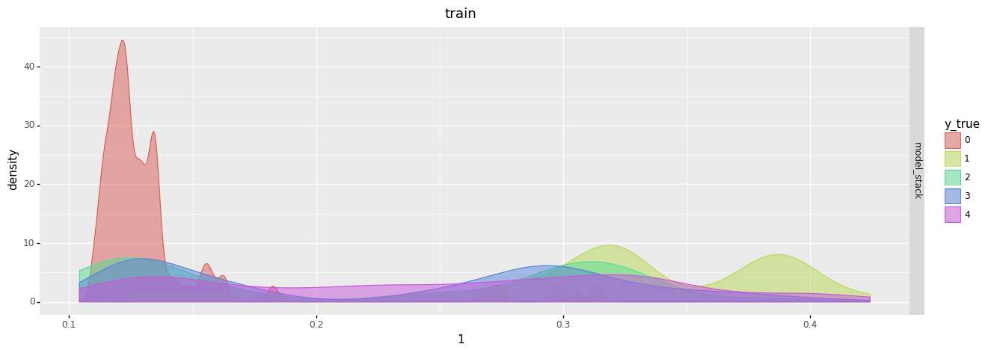

<ggplot: (-9223371899430566008)>

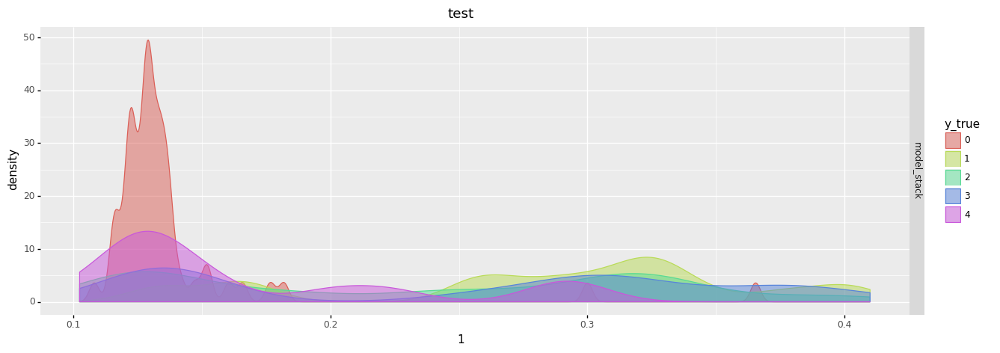

<ggplot: (-9223371899425653848)>

In [39]:
# wizualizacja wynikow (bez obliczec symulacyjnych np. walidacji krzyzowej)

c1.prediction


## Stacking

### Models

In [266]:
# variables
y_var     = ['price']    # variables
x_var_num = ['x', 'table']        # numerical features
x_var_cat = ['color','clarity','cut'] # categorical features
x_var     = x_var_num + x_var_cat     # all features


data1 = data.iloc[1:5000,:]

# random order of rows (without doing that the problem may happen in cross validation if target is not spread randomly)
data1=data1.sample(frac = 1)
data1=data1.reset_index(drop=True)

# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

# placing features and target in single data set
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# converting target to 'str' type
train_set[y_var] = train_set[y_var]
test_set[y_var]  = test_set[y_var]

In [272]:
# Parametry symulacji do UCZENIA MODELI
simulation_name        = 'symulacja_stack' # unikalna nazwa symulacji
simulation_description = 'symulacja do stackingu' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 4     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 4     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestRegressor(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')


# inicjalizacja nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()


# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance(simulation_name = simulation_name)

# zapisanie wynikow na dysk
c1.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 3)
(1650, 3)
int64
int64
int64
int64
int64
int64
int64
int64


You should provide test set for use best model. use_best_model parameter has been switched to false value.


{'learn': {'RMSE': 297.8007827928668}}


### Stack

In [268]:
# budowanie nowego zbioru danych


var_m1_names = ['m1']
var_m2_names = ['m2']

# predykcje model 1 (pierwszy predyktor modelu)
pb_model_1_train = c1.prediction.loc[(c1.prediction['simulation_name'] == 'symulacja_stack') &
                                  (c1.prediction['model_name']  == 'rf') &
                                  (c1.prediction['sample_type'] == 'full') & 
                                  (c1.prediction['set_type']    == 'train'), ['y_pred']].reset_index(drop = True)

pb_model_1_train = pb_model_1_train.rename(columns={'y_pred':var_m1_names[0]})

pb_model_1_test = c1.prediction.loc[(c1.prediction['simulation_name'] == 'symulacja_stack') &
                                  (c1.prediction['model_name']  == 'rf') &
                                  (c1.prediction['sample_type'] == 'full') & 
                                  (c1.prediction['set_type']    == 'test'), ['y_pred']].reset_index(drop = True)

pb_model_1_test = pb_model_1_test.rename(columns={'y_pred':var_m1_names[0]})


# predykcje model 2 (drugi predyktor modelu)
pb_model_2_train = c1.prediction.loc[(c1.prediction['simulation_name'] == 'symulacja_stack') &
                                  (c1.prediction['model_name']  == 'ab') &
                                  (c1.prediction['sample_type'] == 'full') & 
                                  (c1.prediction['set_type']    == 'train'), ['y_pred']].reset_index(drop = True)

pb_model_2_train = pb_model_2_train.rename(columns={'y_pred':var_m2_names[0]})


pb_model_2_test = c1.prediction.loc[(c1.prediction['simulation_name'] == 'symulacja_stack') &
                                  (c1.prediction['model_name']  == 'ab') &
                                  (c1.prediction['sample_type'] == 'full') & 
                                  (c1.prediction['set_type']    == 'test'), ['y_pred']].reset_index(drop = True)

pb_model_2_test = pb_model_2_test.rename(columns={'y_pred':var_m2_names[0]})



# wartosci faktyczne (target)
y_train = c1.prediction.loc[(c1.prediction['simulation_name'] == 'symulacja_stack') &
                               (c1.prediction['model_name']  == 'rf') &
                               (c1.prediction['sample_type'] == 'full') & 
                               (c1.prediction['set_type']    == 'train'), 'y_true'].reset_index(drop = True)


y_test = c1.prediction.loc[(c1.prediction['simulation_name'] == 'symulacja_stack') &
                               (c1.prediction['model_name']  == 'rf') &
                               (c1.prediction['sample_type'] == 'full') & 
                               (c1.prediction['set_type']    == 'test'), 'y_true'].reset_index(drop = True)



# utworzenie ostatecznego zbioru testowego i uczacego
y_var = ['y_true']
x_var_num = var_m1_names + var_m2_names
x_var_cat = []
x_var = x_var_num + x_var_cat

train_set = pd.concat([pb_model_1_train, pb_model_2_train, y_train], axis  = 1 )
test_set  = pd.concat([pb_model_1_test,  pb_model_2_test,  y_test], axis  = 1 )



In [270]:
# Parametry symulacji do UCZENIA MODELI
simulation_name        = 'symulacja pelny stacking' # unikalna nazwa symulacji
simulation_description = 'symulacja pelny stacking' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 4     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 4     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestRegressor(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')



# inicjalizacja nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c2 = classification_model()

# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c2.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = model_fip
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c2.performance(simulation_name = simulation_name)

# zapisanie wynikow na dysk
c2.save_results(path = path_results + 'symulacja_1', override = True)


(3349, 3)
(1650, 3)
int64
int64
int64
int64
int64
int64
int64
int64


You should provide test set for use best model. use_best_model parameter has been switched to false value.


{'learn': {'RMSE': 297.45437943939555}}


,simulation_name,description,x_n,y_name,x_num,x_cat,cat_encoding,simulation_start,simulation_end,performance start,performance end
0,symulacja pelny stacking,symulacja pelny stacking,2,y_true,"m1, m2",,target,2021-06-24 13:39:42,2021-06-24 13:39:44,2021-06-24 13:39:44,2021-06-24 13:39:44


,m1,m2
m1,1.000,1.000
m2,1.000,1.000
,m1,m2
m1,1.000,0.710
m2,0.710,1.000
,m1,m2
,feature,VIF
0,m1,1360.422
1,m2,1360.422


None

,Feature,Importance,Importance_abs,l1
0,m1,893.930,893.930,0.1
1,m2,-58.580,58.580,0.1
2,NOISE_normal,-8.900,8.900,0.1
3,NOISE_uniform,0.440,0.440,0.1
4,m1,903.700,903.700,0.5
5,m2,-68.680,68.680,0.5
6,NOISE_normal,-7.640,7.640,0.5
7,NOISE_uniform,0.160,0.160,0.5
8,m1,904.270,904.270,0.9
9,m2,-68.240,68.240,0.9


[None,
 'recall = TP / TP + FN;   precision = TP / (TP + FP);    f1 = ( 2*TP ) / (2*TP + FP + FN );   balanced_accuracy = (TP/(TP+FN) + TN/(TN+FP)) / 2 ']

,model_name,set_type,_explained_var_score,_max_error,_mean_absolute_er,_mean_gamma_dev,_mean_poisson_dev,_mean_squared_er,_mean_squared_log_er,_mean_tweedie_dev,_median_absolute_er
0,ab,test,0.929,671.123,192.863,0.007,18.105,56815.659,0.007,56815.659,177.840
1,ab,train,0.929,758.488,185.187,0.006,16.891,53924.780,0.006,53924.780,166.512
2,rf,test,0.929,803.434,188.935,0.007,18.004,56474.138,0.007,56474.138,165.934
3,rf,train,0.934,737.206,174.321,0.005,15.610,50040.677,0.005,50040.677,147.787


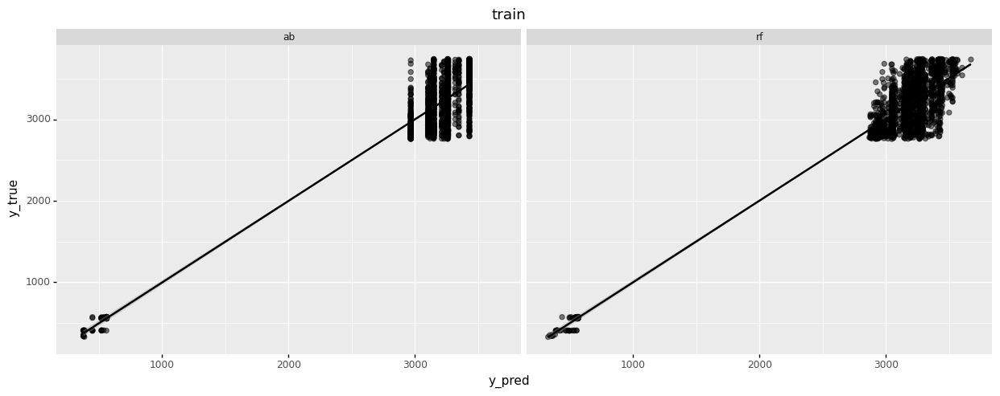

<ggplot: (-9223371891892684340)>

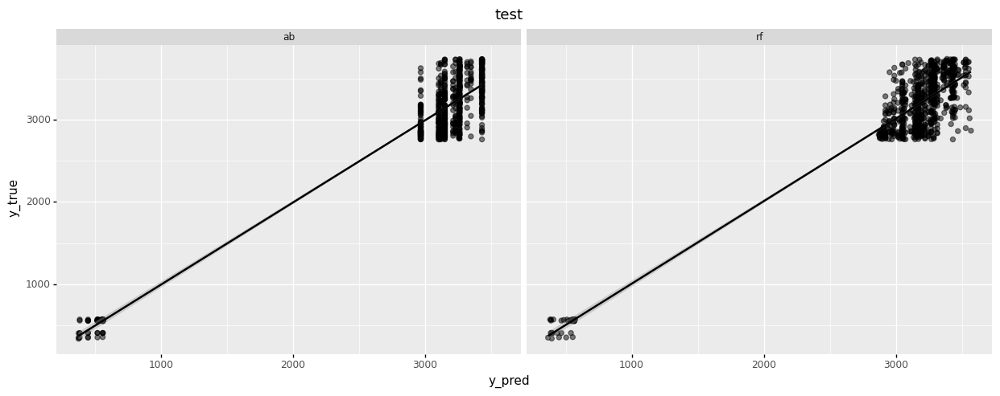

<ggplot: (-9223371891892608424)>

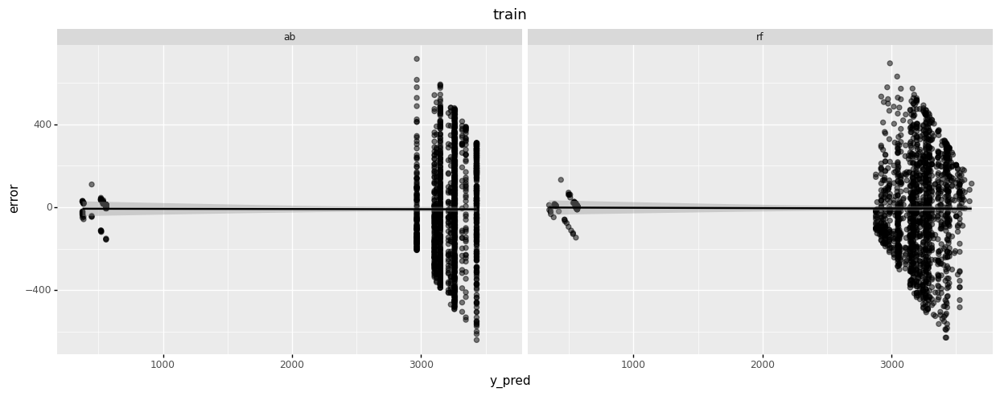

<ggplot: (-9223371891887058216)>

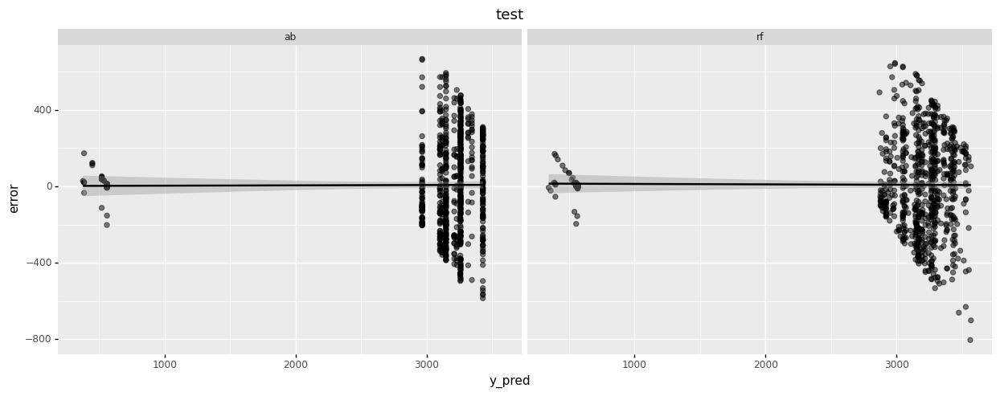

<ggplot: (-9223371891851510048)>

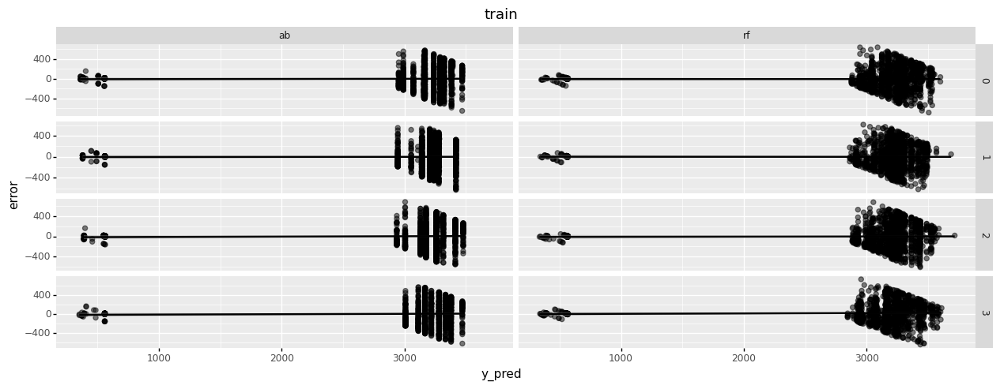

<ggplot: (-9223371891885746120)>

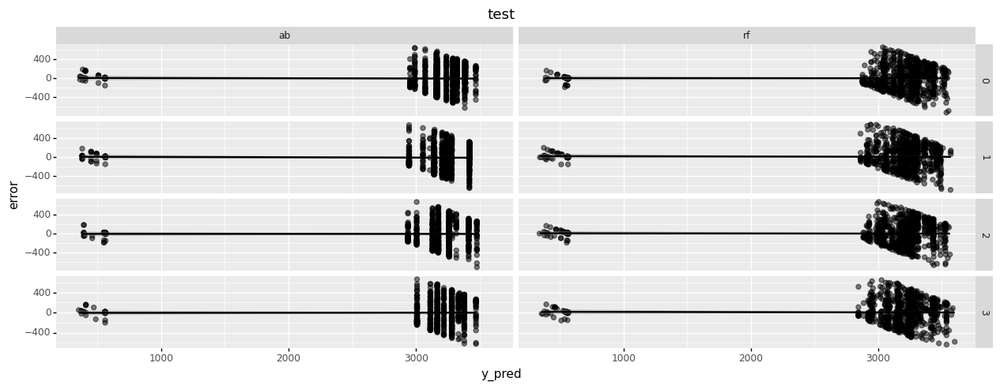

<ggplot: (-9223371891874233032)>

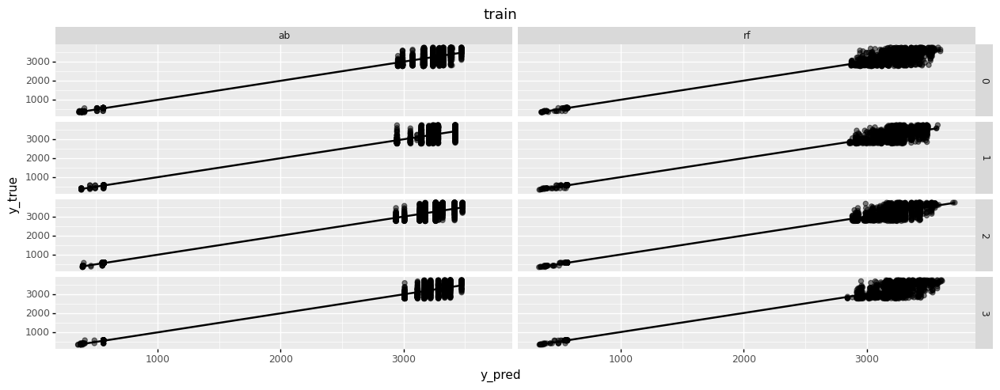

<ggplot: (-9223371891847056636)>

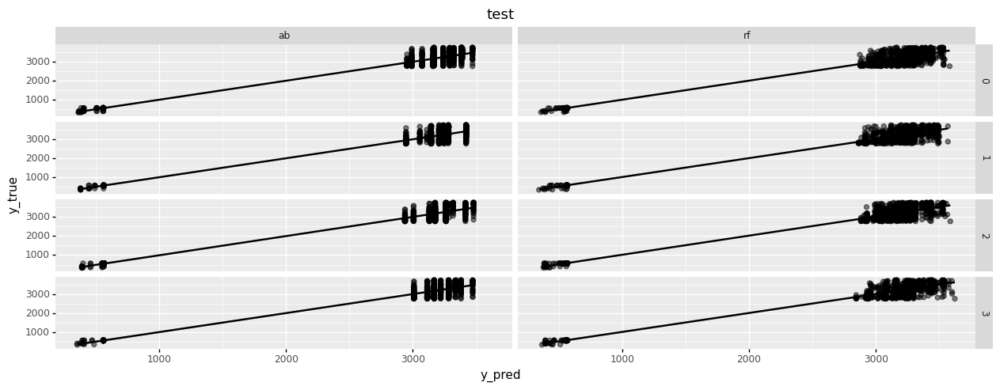

<ggplot: (-9223371891889922808)>

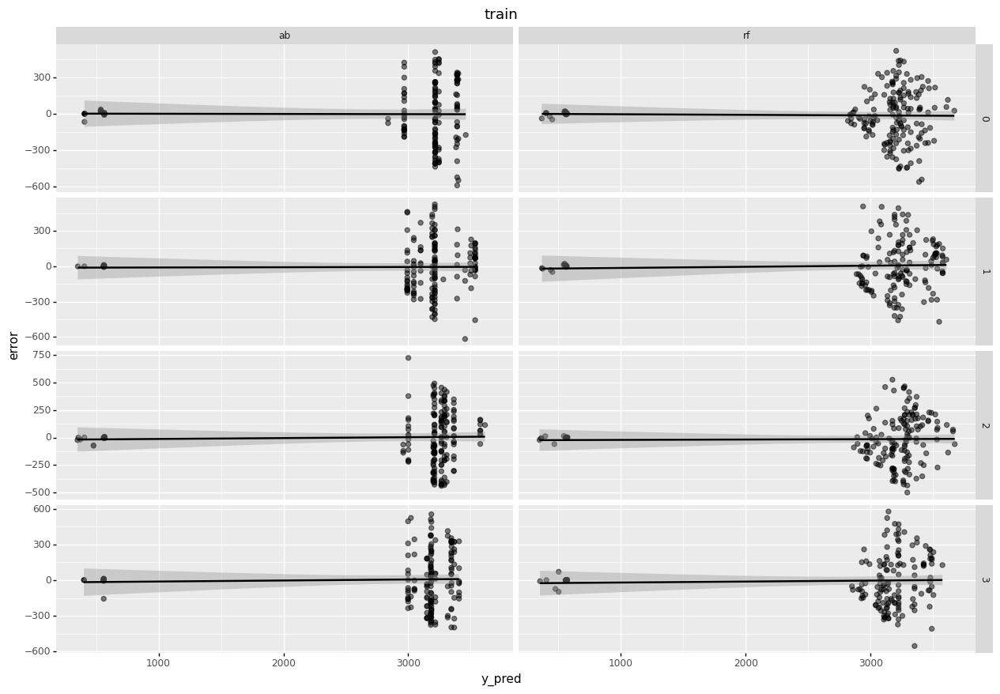

<ggplot: (-9223371891890110252)>

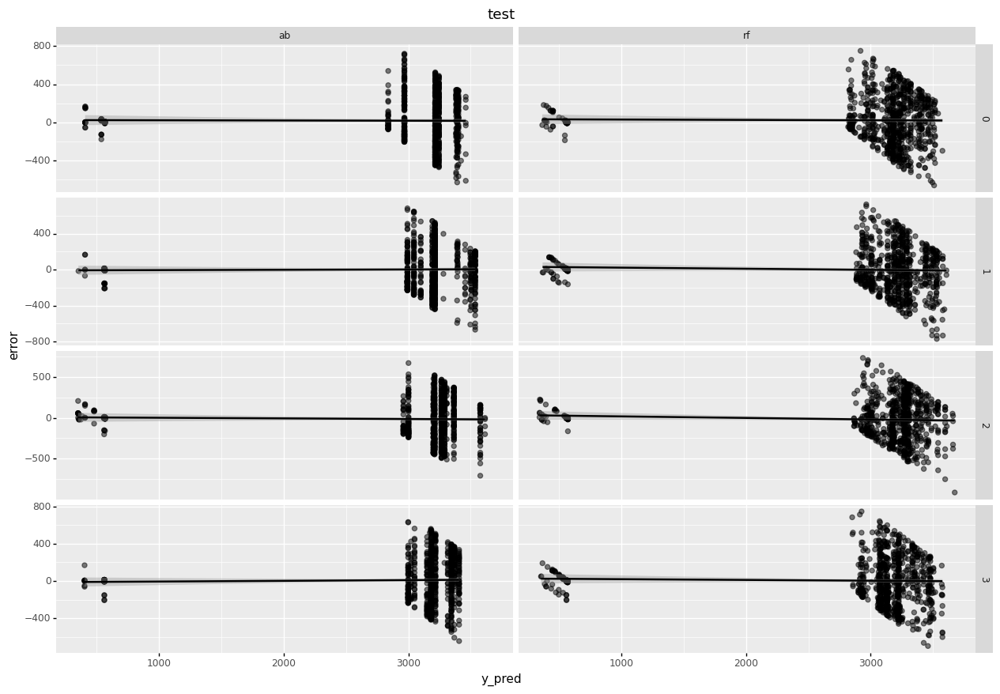

<ggplot: (-9223371891855289420)>

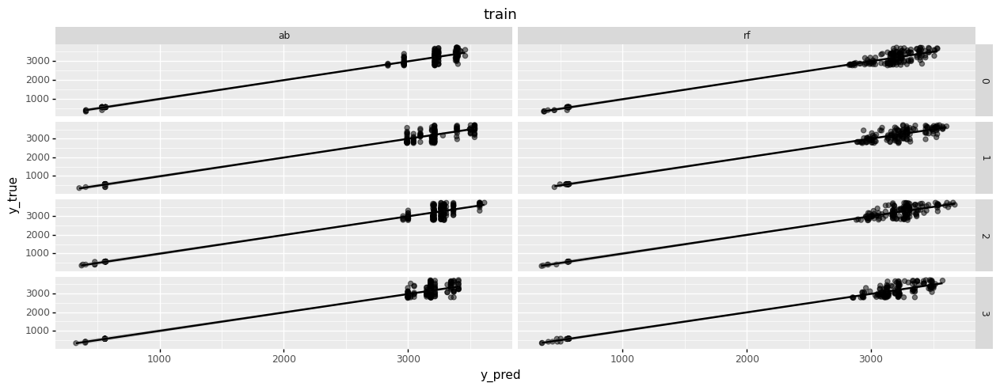

<ggplot: (-9223371891851307160)>

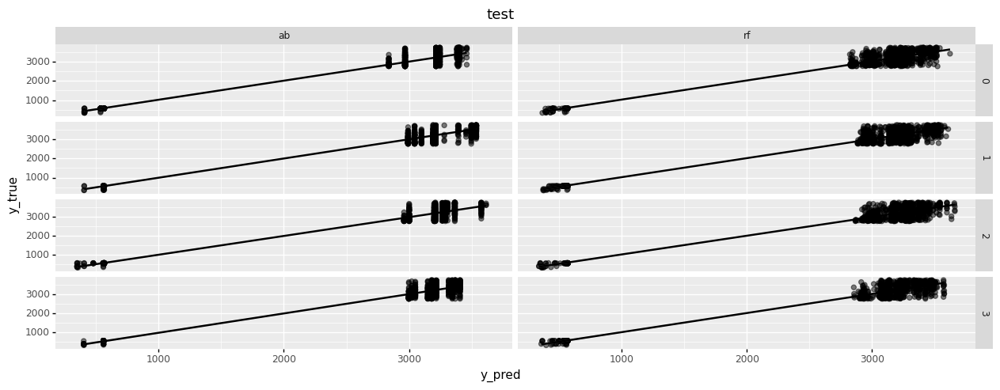

<ggplot: (-9223371891851550508)>

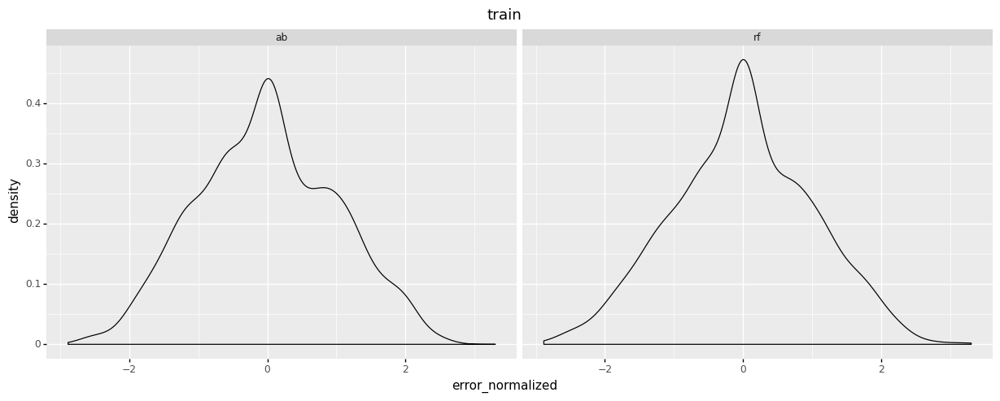

<ggplot: (-9223371891886012764)>

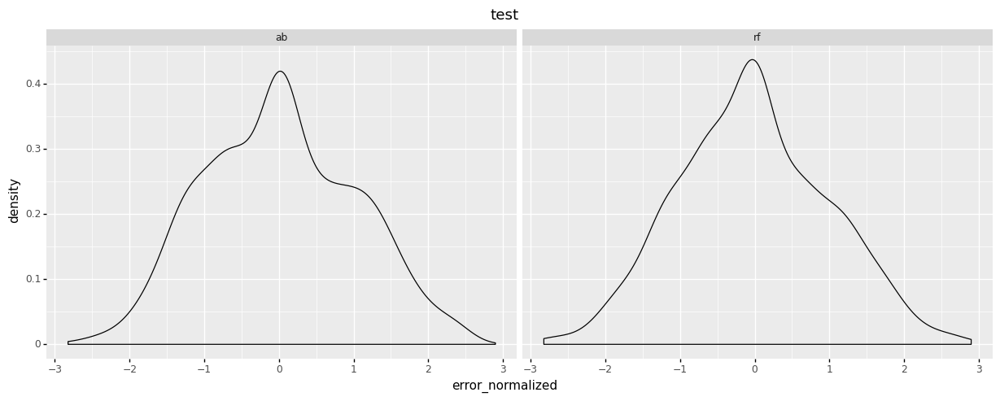

<ggplot: (-9223371891892445272)>

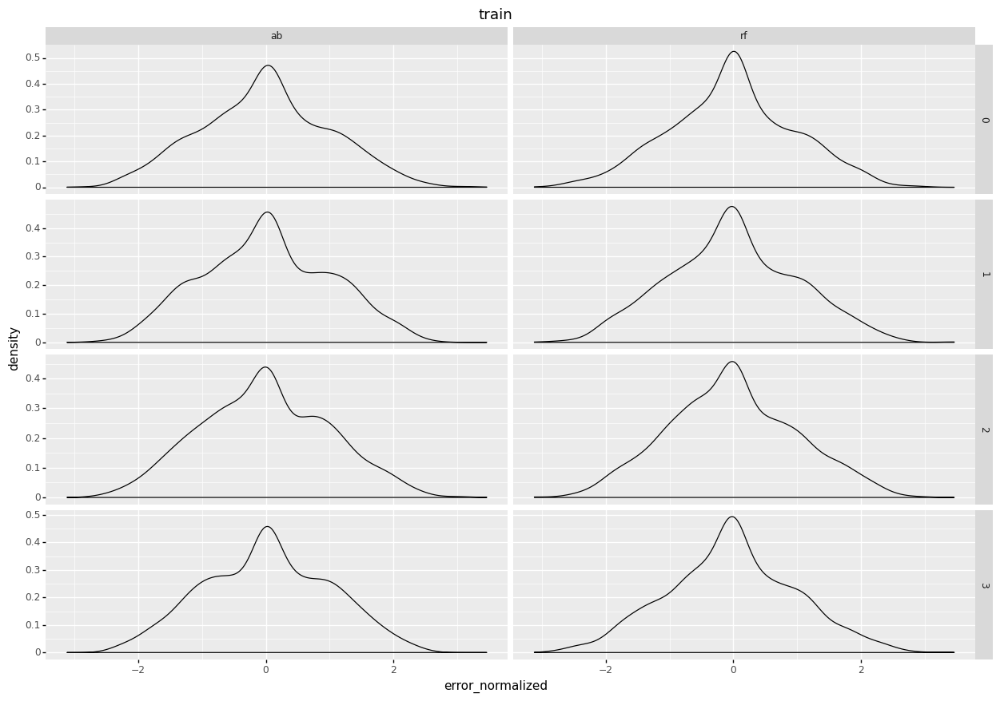

<ggplot: (-9223371891892440012)>

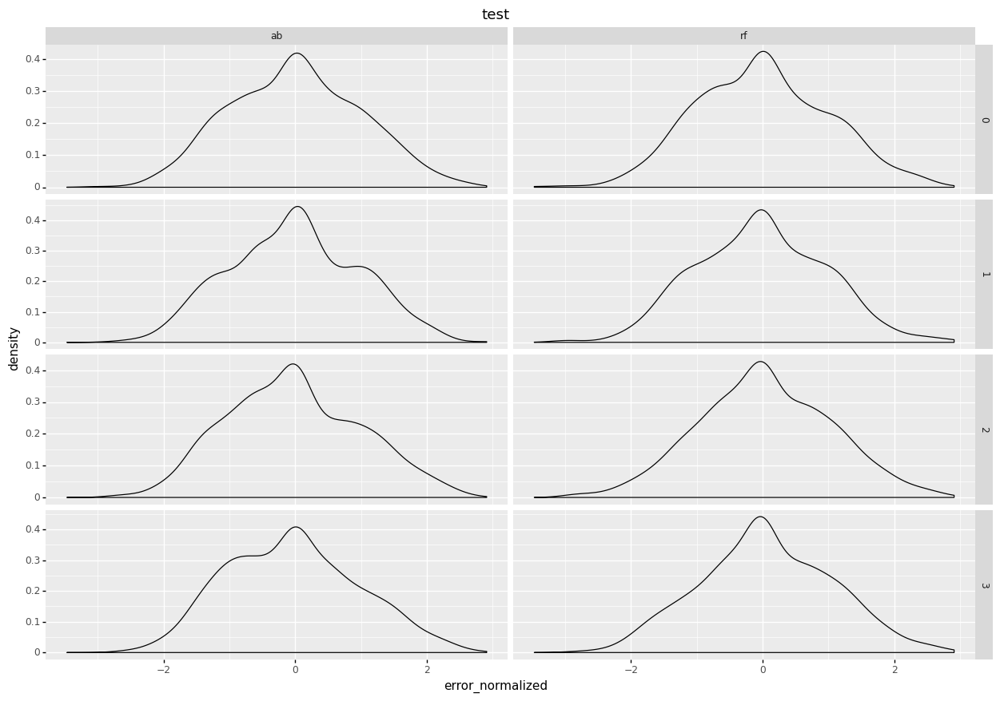

<ggplot: (-9223371891855302740)>

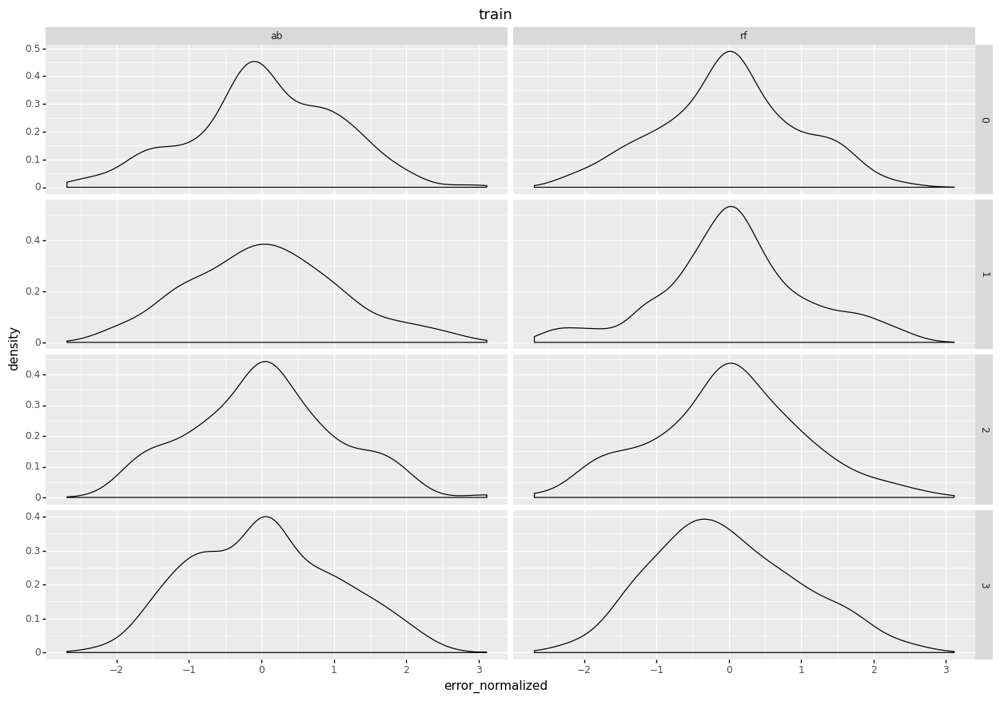

<ggplot: (-9223371891851410456)>

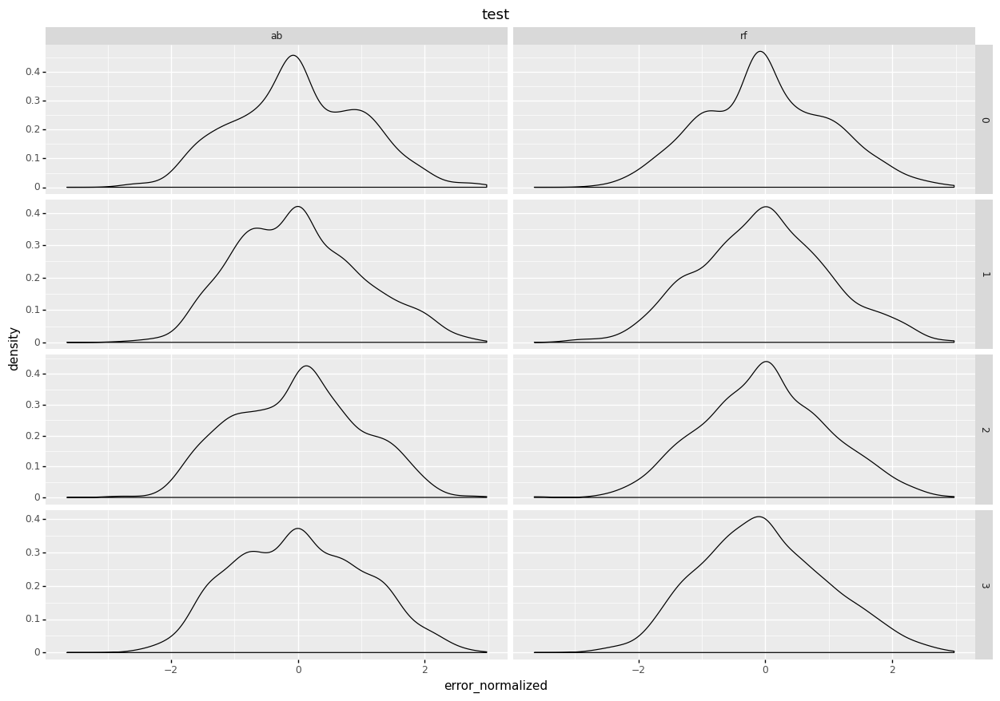

<ggplot: (-9223371891846993096)>

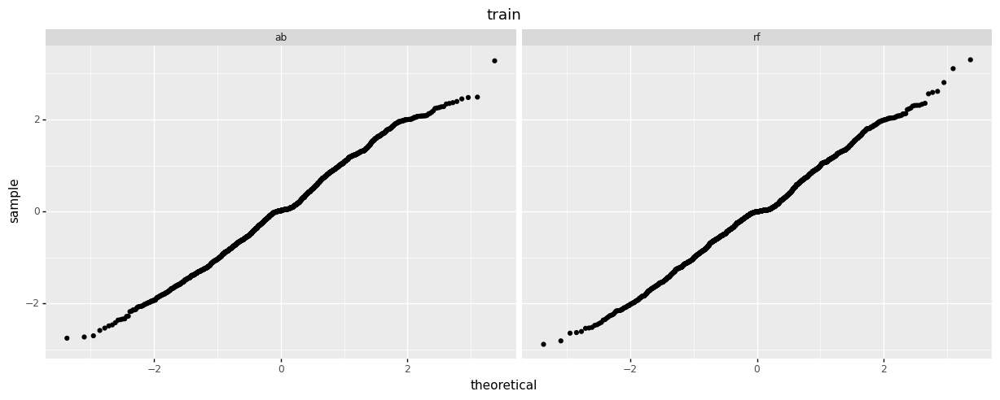

<ggplot: (-9223371891886942344)>

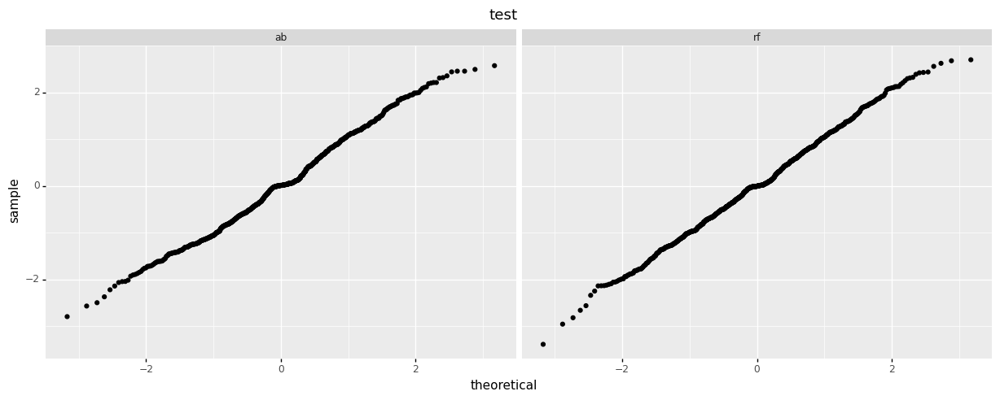

<ggplot: (-9223371891892236436)>

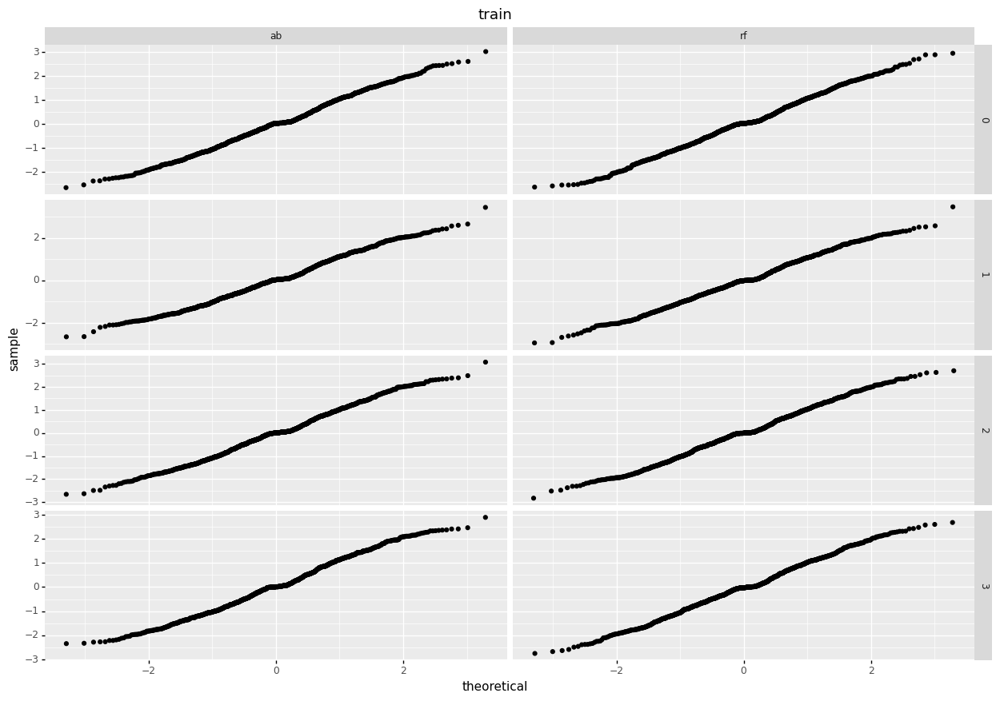

<ggplot: (-9223371891890822044)>

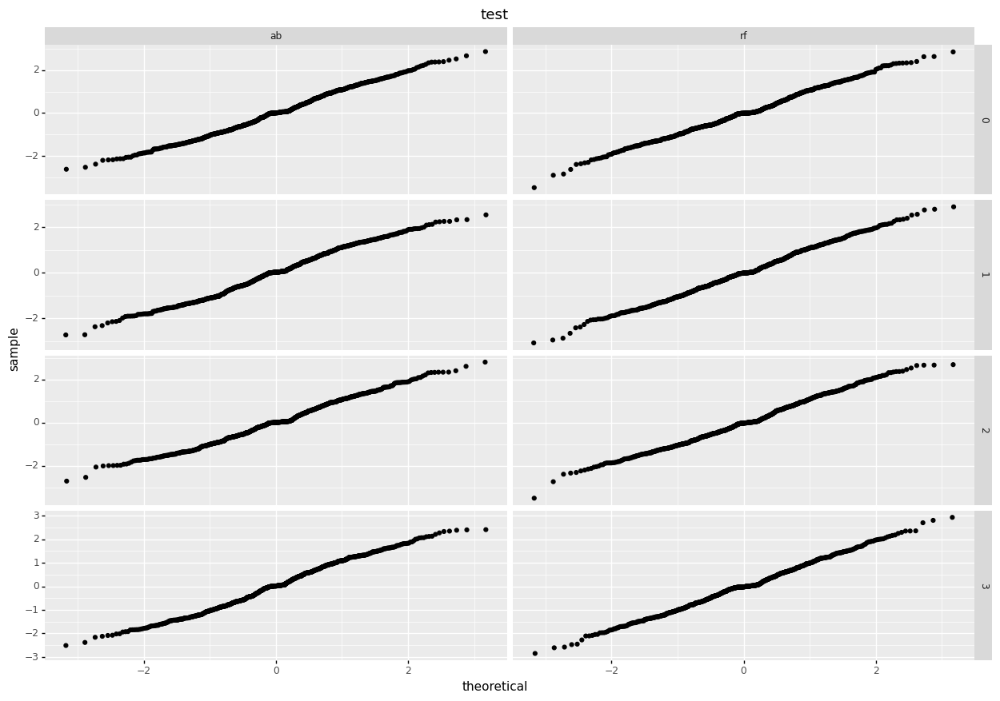

<ggplot: (-9223371891892412424)>

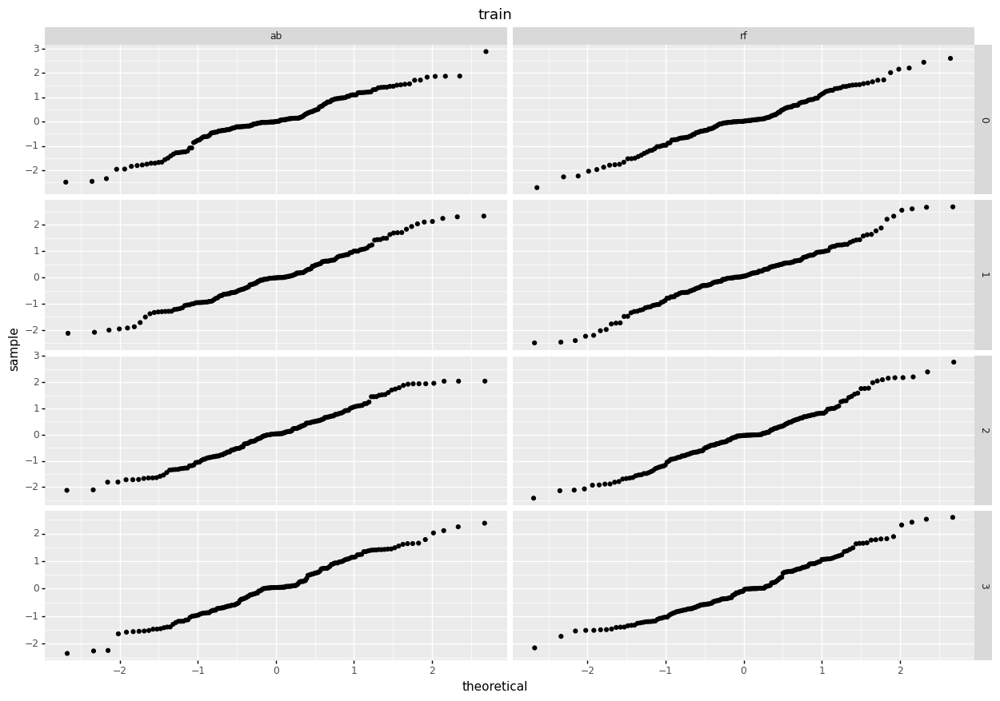

<ggplot: (-9223371891847032964)>

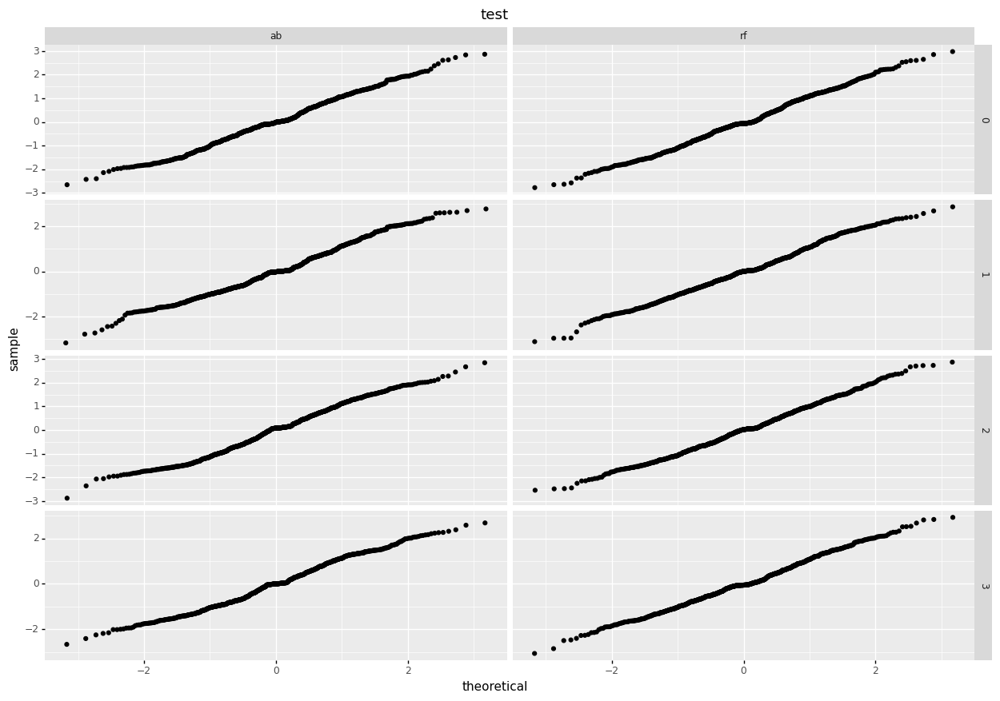

<ggplot: (-9223371891892402628)>

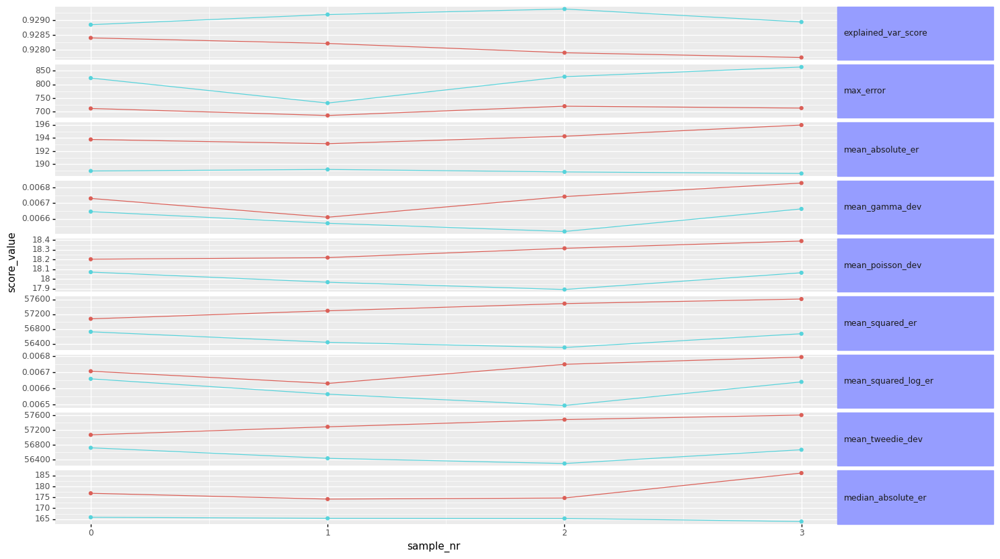

<ggplot: (-9223371891890083256)>

None

,model_name,set_type,sample_type,score_name,max,min,mean,std
0,ab,test,cv,explained_var_score,0.928,0.928,0.928,0.000
1,ab,test,cv,max_error,719.907,685.704,707.481,12.974
2,ab,test,cv,mean_absolute_er,195.970,193.130,194.285,1.053
3,ab,test,cv,mean_gamma_dev,0.007,0.007,0.007,0.000
4,ab,test,cv,mean_poisson_dev,18.390,18.203,18.282,0.076
5,ab,test,cv,mean_squared_er,57608.007,57073.800,57364.465,202.384
6,ab,test,cv,mean_squared_log_er,0.007,0.007,0.007,0.000
7,ab,test,cv,mean_tweedie_dev,57608.007,57073.800,57364.465,202.384
8,ab,test,cv,median_absolute_er,186.057,174.174,177.936,4.794
9,rf,test,cv,explained_var_score,0.929,0.929,0.929,0.000


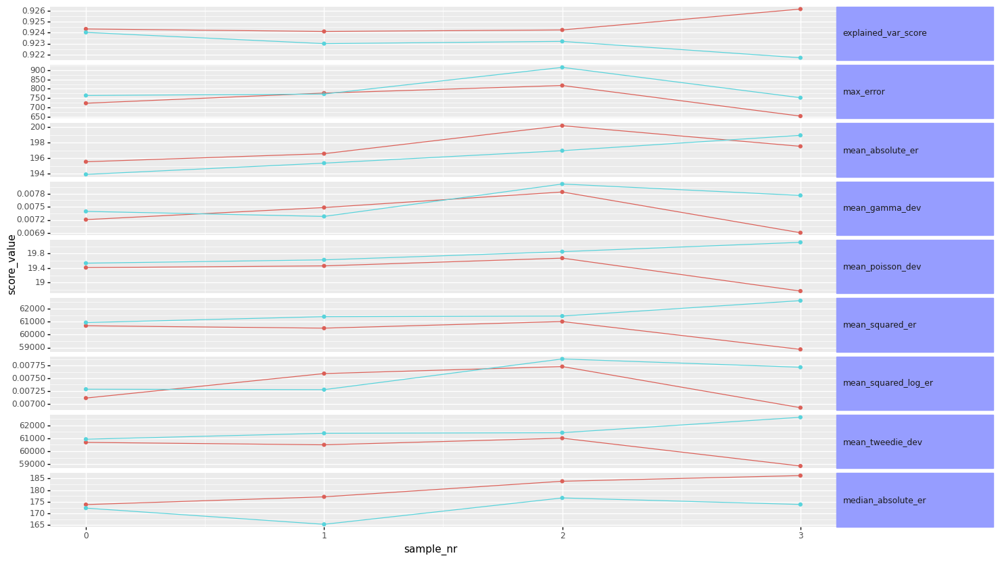

<ggplot: (-9223371891887070500)>

None

,model_name,set_type,sample_type,score_name,max,min,mean,std
0,ab,test,hold,explained_var_score,0.926,0.924,0.925,0.001
1,ab,test,hold,max_error,817.905,652.680,742.431,61.970
2,ab,test,hold,mean_absolute_er,200.198,195.561,197.476,1.721
3,ab,test,hold,mean_gamma_dev,0.008,0.007,0.007,0.000
4,ab,test,hold,mean_poisson_dev,19.675,18.769,19.330,0.339
5,ab,test,hold,mean_squared_er,61007.340,58859.639,60260.824,829.529
6,ab,test,hold,mean_squared_log_er,0.008,0.007,0.007,0.000
7,ab,test,hold,mean_tweedie_dev,61007.340,58859.639,60260.824,829.529
8,ab,test,hold,median_absolute_er,186.269,173.821,180.271,5.002
9,rf,test,hold,explained_var_score,0.924,0.922,0.923,0.001


LUCAS: after filtering no data to display. Suggestion is to check "set_type" if exists


None

None

,level_0,level_1,level_2,level_3,max,min,mean,std


In [271]:
c2.summary_big(simulation_name, pos_label, cv_n, hold_n, by_var)

# Grid search

## Calculations

In [257]:
%run "modules/grid_search_regression.py"

# variables
y_var = 'price'
x_var = ['z', 'x', 'y']


# splitting data set into train and test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

# indicies reset
x_train    = x_train.reset_index(drop=True)
y_train    = y_train.reset_index(drop=True)
x_test    = x_test.reset_index(drop=True)
y_test    = y_test.reset_index(drop=True)

# converting target to 'str' type
y_train = y_train
y_test  = y_test



# models list # Warning: list and range of parameters currently can be modified only in function code !!!!
methods_list = ['RF', 'AB'] # currently available: RF-random forest, AB-adata boost, GB-gradient boost, SVC-wektory nosne, NB-naive bayes, n_neighbors-KNN, XGB-xgboost, CAT-catboost, LGBM-lightgbm

# number of iterations
n_trials = 2


# optimisation
direction    = "minimize"  # to minimize or to maximize objective function
opt_function = 'mean_squared_er'    # objective function (dostepne: 'recall', 'precision', 'aps' (average_recall_precision), 'balanced_accuracy', 'accuracy')



# grid
trial_scores, trial_hyperparameters = grid_optuna_(methods_list = methods_list
            ,direction       = direction
            ,opt_function    = opt_function
            ,params_for_methods=None
            ,n_trials = n_trials
            ,x_train  = x_train
            ,y_train  = y_train
            ,x_test   = x_test
            ,y_test   = y_test)


[I 2021-06-24 13:22:13,743] A new study created in memory with name: no-name-4e07b63c-214a-42b4-b2e8-1d918655d3a7
[I 2021-06-24 13:22:22,428] Trial 0 finished with value: 112874.66717886108 and parameters: {'n_estimators': 183.69011552665933, 'max_depth': 35.32346453776781, 'criterion': 'mae', 'bootstrap': False}. Best is trial 0 with value: 112874.66717886108.
[I 2021-06-24 13:22:26,133] Trial 1 finished with value: 72621.64263938808 and parameters: {'n_estimators': 116.32278175816394, 'max_depth': 28.785216545281344, 'criterion': 'mae', 'bootstrap': True}. Best is trial 1 with value: 72621.64263938808.
[I 2021-06-24 13:22:26,232] A new study created in memory with name: no-name-4f9e6e2c-578e-4947-8231-5966a6024cfa
[I 2021-06-24 13:22:26,389] Trial 0 finished with value: 70057.73921856332 and parameters: {'n_estimators': 198.57804645063732, 'learning_rate': 0.14143199398606487, 'loss': 'linear'}. Best is trial 0 with value: 70057.73921856332.
[I 2021-06-24 13:22:26,727] Trial 1 finish

## Results visualisation

AB


,duration,mean_absolute_er_test,mean_squared_er_test,params_learning_rate,params_loss,params_n_estimators,value
1,0 days 00:00:00.253564,203.711,70057.785,0.092,exponential,87.565,70057.785
0,0 days 00:00:00.155035,204.282,70057.739,0.141,linear,198.578,70057.739


RF


,duration,mean_absolute_er_test,mean_squared_er_test,params_bootstrap,params_criterion,params_max_depth,params_n_estimators,value
0,0 days 00:00:08.683677,204.243,112874.667,False,mae,35.323,183.69,112874.667
1,0 days 00:00:03.619444,184.778,72621.643,True,mae,28.785,116.323,72621.643


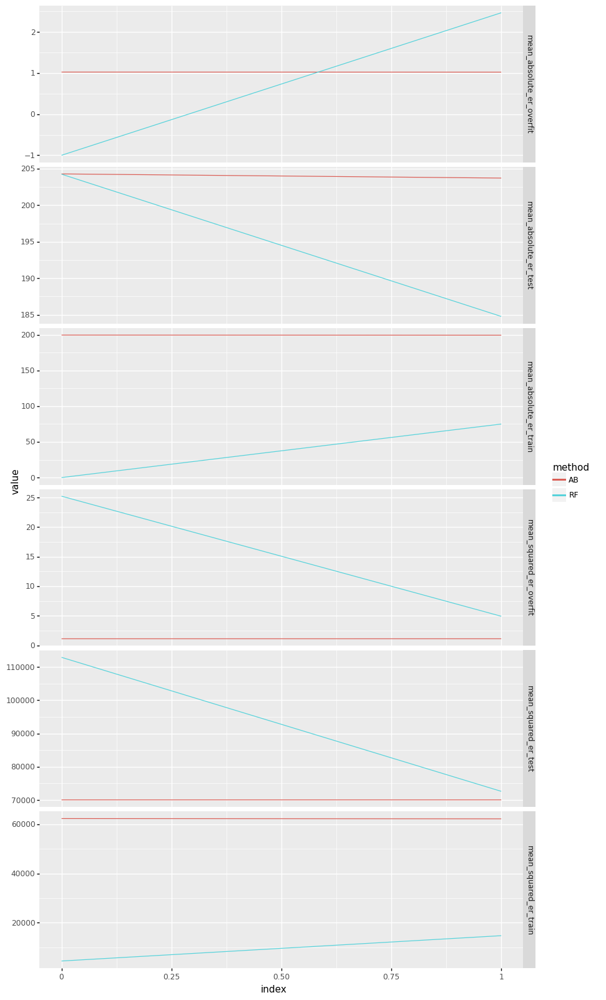

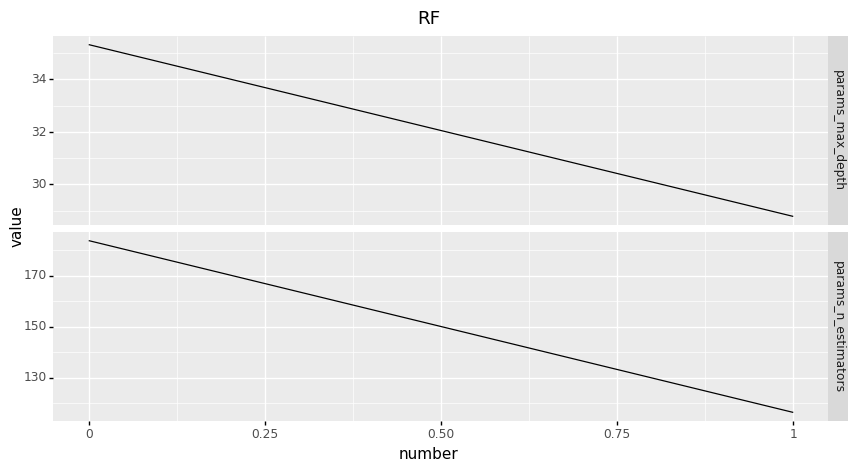

In [263]:
# tabele z wartosciami hiperparametrow (w kolumnie 'value' jest wartosc funkcji celu)    
grid_optuna_hyperparameters_tables(trial_hyperparameters)

# wykres parametrow oceniajacych dopasownaie po modelach i punktach odciecia
grid_optuna_scores_plot(trial_scores, fig_w = 10, fig_h = 20)

# wykres wartosci KONRETNYCH hiperparametrow dla KONRETNEGO modelu po roznych punktach odciecia
plotnine.options.figure_size = (20, 10) # width, hight
grid_optuna_hyperparameters_plot(trial_hyperparameters, params_to_print = ['n_estimators', 'max_depth'], method = 'RF')


# Code tests

In [494]:

# zmienne
y_var = ['target_multi_label']         # zmienna objasniana (wilostanowa)
x_var_num = ['price', 'x', 'y', 'z']  # zmienne objasniajace numeryczne
x_var_cat = ['color','clarity'] # zmienne objasniajace kategoryczne
x_var = x_var_num + x_var_cat         # wszystkie zmienne objasniajace

data1 = data.iloc[1:3000,:] 

#losowanie pomieszanie wierszy i reset indeksow (bez pomieszania mogę wystapic problemy przy walidacji krzyzowej jezeli target nie jest losow rorzucony)
data1=data1.sample(frac = 1)
data1=data1.reset_index(drop=True)

# podzial na zbioru 'data' na train i test
x_train, x_test, y_train, y_test = skl.model_selection.train_test_split(data1[x_var], data1[y_var], test_size=0.33)

# umieszczenie w jednym zbiorze zmiennych objasniajacych i zmiennej objasnianej
train_set = pd.concat([x_train, y_train], axis = 1)
test_set  = pd.concat([x_test, y_test], axis = 1)

# zamiana zmiennej objasnianej na typ 'str'
train_set[y_var] = train_set[y_var].astype(str)
test_set[y_var]  = test_set[y_var].astype(str)

In [495]:
%run "draft/F_classification_draft.py"
# PARAMETRY SYMULACJI DO 'UCZENIA MODELI'
simulation_name        = 'symulacja_1' # unikalna nazwa symulacji
simulation_description = 'pierwszy model na wszyskich zmiennych' # opis symulacji
models_list            = {'rf':models_base['rf'], 'ab':models_base['ab']} # slownik modeli do nauki wybranych z listy 'model_base'
cv_n                   = 3     # walidacja krzyzowa: ilosc k-foldow na walidacji krzyzowej (None jezeli nie chcemy walidacji krzyzowej)
hold_n                 = 2     # walidacja holdout: ilosc samplow na holdout (None jezeli nie chcemy walidacji holdout)
hold_train_sample_size = 0.1   # walidacja holdout: wielkosc losowanego zbioru train na holdout
hold_test_sample_size  = 0.1   # walidacja holdout: wielkosc losowanego zbioru test na holdout
fip_n                  = 1     # walidacja feature importatnce permutation:  ilosc samplow (None jezeli nie chcemy. Jezeli chcemy, zalecana wartosc to 1)
model_fip              = RandomForestClassifier(n_estimators=20, max_depth=7) # walidacja feature importatnce permutation: okreslenie modelu
by_var                 = None#'clarity' # walidacja segmentacyjna: zmienna po ktore wykonac segmentacje by_var (None jezeli nie chcemy)
pos_label              = '1'   # ktory label zmiennej objasnianej jest traktowany jako 'positive'
balancing_method       = None  # dla modeli wieloklasowych niedostepne
calibration_method     = None # metoda kalibracji prawdopodobienstwa (dostepne : 'isotonic', 'None')
cat_encoding_method    = 'target' # metoda enkodowania zmiennych kategorycznych (dostepne: 'target', 'None')

# PARAMETRY DLA 'PERFORMANCE' (dla zagadnienie wialostanowego nie ma thresholdow. Jest tylko wazenie priori gdzie wagu sumuja sie do wartosci 1)
thresholds_priori_list ={  'p1':[None,{'0':0.2, '1':0.2, '2':0.2, '3':0.2,'4':0.2}]
      , 'p2':[None,{'0':0.1, '1':0.3, '2':0.2, '3':0.2,'4':0.2}]}


# INICJALIZACJA nowego obiektu do symulacji (na tym obiekcie bedziemy wykonywac kolejne symulacje, więc kolejne inicjalizacje nie sa potrzebne)
c1 = classification_model()

# UCZENIE MODELI (obliczane tylko prawdopodobienstwa)
c1.simulation(  train_set = train_set, test_set = test_set, y_var = y_var, x_var_num = x_var_num, x_var_cat = x_var_cat, by_var=by_var
              , balancing_method=balancing_method
              , cv_n=cv_n, fip_n=fip_n, hold_n = hold_n, hold_train_sample_size = hold_train_sample_size, hold_test_sample_size = hold_test_sample_size
              , data_check=True, models_list=models_list, correlation = True, model_fip = RandomForestClassifier(n_estimators=30, max_depth=7)
              , simulation_name = simulation_name, description = simulation_description)

# PERFORMANCE (na uzyskane w poprzednim kroku prawdopodobienstwa nadkladamy thresholdy i liczymy scory confusion matrix itp.)
c1.performance_multi_thr(thresholds_priori_list = thresholds_priori_list, simulation_name = simulation_name, pos_label = '1' )

# ZAPISANIE wynikow na dysk
# c1.save_results(path = r'C:\Users\memy\OneDrive\Pulpit\1_Programs_and_programing\DS_proj\classification_python\results\symulacja_1', override = True)

# # LADOWANIE z dysku do zainicjowanego wczeniej pustego obiektu
# # c1.load_results(path = '...')

# # WIZUALIZACJA
# c1.summary_big(simulation_name, pos_label, cv_n, hold_n, by_var)

(2009, 7)
(990, 7)
1339
670
1339
670
1340
669
1339
670
1339
670
1340
669


## Probabilities

In [496]:
simulation_name = 'symulacja_1'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full') & (c1.probabilities['set_type']=='test')].shape

h('cv')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='test')].shape

h('hold')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='test')].shape

h('by_var')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='test')].shape

h('fip')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='test')].shape






(2999, 13)

(2009, 7)

(990, 7)

(5998, 13)

(4018, 13)

(1980, 13)

(17994, 13)

(8036, 13)

(4018, 13)

(5940, 13)

(5564, 13)

(800, 13)

(804, 13)

(3960, 13)

(0, 13)

(0, 13)

(0, 13)

(0, 13)

(17994, 13)

(6024, 13)

(6030, 13)

(5940, 13)

In [481]:
simulation_name = 'symulacja_2'



h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='full') & (c1.probabilities['set_type']=='test')].shape

h('cv')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='cv') & (c1.probabilities['set_type']=='test')].shape

h('hold')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='hold') & (c1.probabilities['set_type']=='test')].shape

h('by_var')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='by_var') & (c1.probabilities['set_type']=='test')].shape

h('fip')
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='train')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='valid')].shape
c1.probabilities[(c1.probabilities['simulation_name']==simulation_name) & (c1.probabilities['sample_type']=='fip') & (c1.probabilities['set_type']=='test')].shape





(2999, 13)

(2009, 7)

(990, 7)

(5998, 13)

(4018, 13)

(1980, 13)

(11996, 13)

(4018, 13)

(4018, 13)

(3960, 13)

(5564, 13)

(800, 13)

(804, 13)

(3960, 13)

(21838, 13)

(4018, 13)

(1980, 13)

(15840, 13)

(14995, 13)

(5020, 13)

(5025, 13)

(4950, 13)

## Classification

In [388]:
simulation_name = 'symulacja_1'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full') & (c1.classification['set_type']=='test')].shape

h('cv')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='test')].shape

h('hold')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='test')].shape

h('by_var')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='test')].shape

h('fip')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='test')].shape

(4999, 13)

(3349, 7)

(1650, 7)

(29994, 11)

(20094, 11)

(9900, 11)

(39992, 11)

(13396, 11)

(13396, 11)

(13200, 11)

(18552, 11)

(2672, 11)

(2680, 11)

(13200, 11)

(72796, 11)

(13396, 11)

(6600, 11)

(52800, 11)

(74985, 11)

(25110, 11)

(25125, 11)

(24750, 11)

In [389]:
simulation_name = 'symulacja_2'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='full') & (c1.classification['set_type']=='test')].shape

h('cv')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='cv') & (c1.classification['set_type']=='test')].shape

h('hold')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='hold') & (c1.classification['set_type']=='test')].shape

h('by_var')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='by_var') & (c1.classification['set_type']=='test')].shape

h('fip')
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='train')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='valid')].shape
c1.classification[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='test')].shape

(4999, 13)

(3349, 7)

(1650, 7)

(29994, 11)

(20094, 11)

(9900, 11)

(39992, 11)

(13396, 11)

(13396, 11)

(13200, 11)

(18552, 11)

(2672, 11)

(2680, 11)

(13200, 11)

(72796, 11)

(13396, 11)

(6600, 11)

(52800, 11)

(74985, 11)

(25110, 11)

(25125, 11)

(24750, 11)

## Scores

In [430]:
simulation_name = 'symulacja_1'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full') & (c1.scores['set_type']=='test')].shape

h('cv')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='test')].shape

h('hold')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='test')].shape

h('by_var')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='test')].shape

h('fip')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='test')].shape

(999, 13)

(669, 7)

(330, 7)

(40, 10)

(20, 10)

(20, 10)

(120, 10)

(40, 10)

(40, 10)

(40, 10)

(120, 10)

(40, 10)

(40, 10)

(40, 10)

(480, 10)

(160, 10)

(160, 10)

(160, 10)

(150, 10)

(50, 10)

(50, 10)

(50, 10)

In [443]:
simulation_name = 'symulacja_2'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='full') & (c1.scores['set_type']=='test')].shape

h('cv')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='cv') & (c1.scores['set_type']=='test')].shape

h('hold')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='hold') & (c1.scores['set_type']=='test')].shape

h('by_var')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='by_var') & (c1.scores['set_type']=='test')].shape

h('fip')
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='train')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='valid')].shape
c1.scores[(c1.scores['simulation_name']==simulation_name) & (c1.scores['sample_type']=='fip') & (c1.scores['set_type']=='test')].shape

(999, 13)

(669, 7)

(330, 7)

(40, 10)

(20, 10)

(20, 10)

(120, 10)

(40, 10)

(40, 10)

(40, 10)

(120, 10)

(40, 10)

(40, 10)

(40, 10)

(480, 10)

(160, 10)

(160, 10)

(160, 10)

(150, 10)

(50, 10)

(50, 10)

(50, 10)

## Confusion matrix

In [497]:
    
simulation_name = 'symulacja_1'

h('sets')
data1.shape
train_set.shape
test_set.shape

h('full')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full') & (c1.confusion_matrix['set_type']=='test')].shape

h('cv')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='test')].shape

h('hold')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='test')].shape

h('by_var')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='test')].shape

h('fip')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='test')].shape


(2999, 13)

(2009, 7)

(990, 7)

(8, 33)

(4, 33)

(4, 33)

(36, 33)

(12, 33)

(12, 33)

(12, 33)

(24, 33)

(8, 33)

(8, 33)

(8, 33)

(0, 33)

(0, 33)

(0, 33)

(0, 33)

(36, 33)

(12, 33)

(12, 33)

(12, 33)

In [482]:
    
simulation_name = 'symulacja_2'


h('full')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='full') & (c1.confusion_matrix['set_type']=='test')].shape

h('cv')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='cv') & (c1.confusion_matrix['set_type']=='test')].shape

h('hold')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='hold') & (c1.confusion_matrix['set_type']=='test')].shape

h('by_var')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='by_var') & (c1.confusion_matrix['set_type']=='test')].shape

h('fip')
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='train')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='valid')].shape
c1.confusion_matrix[(c1.confusion_matrix['simulation_name']==simulation_name) & (c1.confusion_matrix['sample_type']=='fip') & (c1.confusion_matrix['set_type']=='test')].shape


(8, 33)

(4, 33)

(4, 33)

(24, 33)

(8, 33)

(8, 33)

(8, 33)

(24, 33)

(8, 33)

(8, 33)

(8, 33)

(96, 33)

(32, 33)

(32, 33)

(32, 33)

(30, 33)

(10, 33)

(10, 33)

(10, 33)

In [ ]:
# c1.scores[c1.scores['sample_type']=='fip']



# def scores_determining(self, y_true, y_pred, pos_label = 1):


y_true=c1.classification.loc[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='train'), 'y_true']
y_pred=c1.classification.loc[(c1.classification['simulation_name']==simulation_name) & (c1.classification['sample_type']=='fip') & (c1.classification['set_type']=='train'), 'y_pred']
    
pos_label = 1
    
"""
calculation scores for models predictions. Scores are not saved here. It is done in f:performance
"""

# accuracy
try:
    accuracy = skm.accuracy_score(y_true = y_true, y_pred = y_pred )
except:
    accuracy = np.nan


# balanced accuracy
try:
    balanced_accuracy = skm.balanced_accuracy_score(y_true = y_true, y_pred = y_pred)
except:
    balanced_accuracy = np.nan


# recall
try:
  if len(self.y_labels) < 3:
    recall  = skm.recall_score(y_true = y_true.astype(int), y_pred = y_pred.astype(int), average = 'binary', pos_label = int(pos_label))
  else:
    recall = skm.recall_score(y_true = y_true.astype(str), y_pred = y_pred.astype(str), average = 'weighted')
except:
    recall = np.nan



# precision
try:
  if len(self.y_labels) < 3:
    precision  = skm.precision_score(y_true = y_true.astype(int), y_pred = y_pred.astype(int), average = 'binary', pos_label = int(pos_label))
  else:
    precision = skm.precision_score(y_true = y_true.astype(str), y_pred = y_pred.astype(str), average = 'weighted')
except:
    precision = np.nan

# f1
try:
  if len(self.y_labels) < 3:
    f1 = skm.f1_score(y_true = y_true, y_pred = y_pred, average = 'binary', pos_label = str(pos_label))
  else:
    f1 = skm.f1_score(y_true = y_true, y_pred = y_pred, average = 'weighted')
except:
  f1 = np.nan

# putting all scores into Dataframe
scores = pd.DataFrame({'score_name' :['accuracy','balanced_accuracy', 'recall', 'precision', 'f1'], 
                       'score_value':[ accuracy , balanced_accuracy ,  recall ,  precision ,  f1]})



## performance

In [440]:


simulation_name='symulacja_2'
threshold_priori_id = 'p1'

cls = c1.classification.loc[(c1.classification['simulation_name']==simulation_name) & (c1.classification['threshold_priori_id']==threshold_priori_id), : ]


# indicies filter for test set
if filter_test_indicies is not None:
  cls_other = cls[cls['set_type']!='test']
  cls_test  = cls[cls['set_type']=='test'] 
  cls_test = cls_test[cls_test['index'].isin(filter_test_indicies)]

  cls = pd.concat([cls_other, cls_test], axis = 0)

cls = cls.drop(columns='index') # nie potrzebujemy indeksu

# data grouping with classification decision
group_structure = ['simulation_name', 'model_name', 'set_type', 'sample_type', 'sample_nr', 'sample_name',  'if_automatic', 'threshold_priori_id']
gr = cls.groupby(group_structure)

# empty matrices to collect results
scores = pd.DataFrame()
confusion_matrix = pd.DataFrame()

# loop over groups
for name, group in gr:

    # printing progress of the loop
    print(name)

('symulacja_2', 'ab', 'test', 'by_var', 0, 'I1', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 1, 'IF', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 2, 'SI1', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 3, 'SI2', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 4, 'VS1', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 5, 'VS2', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 6, 'VVS1', 0, 'p1')
('symulacja_2', 'ab', 'test', 'by_var', 7, 'VVS2', 0, 'p1')
('symulacja_2', 'ab', 'test', 'cv', 0, '_', 0, 'p1')
('symulacja_2', 'ab', 'test', 'cv', 1, '_', 0, 'p1')
('symulacja_2', 'ab', 'test', 'full', 0, '_', 0, 'p1')
('symulacja_2', 'ab', 'test', 'hold', 0, '_', 0, 'p1')
('symulacja_2', 'ab', 'test', 'hold', 1, '_', 0, 'p1')
('symulacja_2', 'ab', 'train', 'by_var', 0, 'I1', 0, 'p1')
('symulacja_2', 'ab', 'train', 'by_var', 1, 'IF', 0, 'p1')
('symulacja_2', 'ab', 'train', 'by_var', 2, 'SI1', 0, 'p1')
('symulacja_2', 'ab', 'train', 'by_var', 3, 'SI2', 0, 'p1')
('symulacja_2', 'ab

In [1]:
import pandas as pd
import plotly.graph_objects as go

df = pd.read_csv('https://raw.githubusercontent.com/vyaduvanshi/helper-files/master/parallel_coordinates.csv')
group_vars = df['country'].unique()
dfg = pd.DataFrame({'country':df['country'].unique()})
dfg['dummy'] = dfg.index
df = pd.merge(df, dfg, on = 'country', how='left')


dimensions = list([dict(range=[df['gm_Retail & Recreation'].min(),df['gm_Retail & Recreation'].max()],
                        label='Retail & Recreation', values=df['gm_Retail & Recreation']),
                  dict(range=[df['gm_Grocery & Pharmacy'].min(),df['gm_Grocery & Pharmacy'].max()],
                       label='Grocery & Pharmacy', values=df['gm_Grocery & Pharmacy']),
                  dict(range=[df['gm_Parks'].min(),df['gm_Parks'].max()],
                       label='Parks', values=df['gm_Parks']),
                  dict(range=[df['gm_Transit Stations'].min(),df['gm_Transit Stations'].max()],
                       label='Transit Stations', values=df['gm_Transit Stations']),
                  dict(range=[df['gm_Workplaces'].min(),df['gm_Workplaces'].max()],
                       label='Workplaces', values=df['gm_Workplaces']),
                  dict(range=[df['gm_Residential'].min(),df['gm_Residential'].max()],
                       label='Residential', values=df['gm_Residential']),
                   
                  dict(range=[0,df['dummy'].max()],
                       tickvals = dfg['dummy'], ticktext = dfg['country'],
                       label='Country', values=df['dummy']),
                  
                  ])

fig = go.Figure(data=go.Parcoords(line = dict(color = df['dummy'],
                   colorscale = [[0,'rgba(200,0,0,0.1)'],[0.5,'rgba(0,200,0,0.1)'],[1,'rgba(0,0,200,0.1)']]), dimensions=dimensions))
fig.show()

# Dustbin

,feature,VIF
0,x,9752.247
1,y,8611.514
2,price,2.772
3,z,982.514


In [354]:
cat_vars = ['cut','color']

encode = ce.TargetEncoder(cols = cat_vars  )  
    
encode.fit(X=data[cat_vars], y=data['target'])
# transforming train data set with encoded values
data_encoded_train = encode.transform(X=data[cat_vars], y=data['target'])

data_encoded_train

TargetEncoder(cols=['cut', 'color'])

,cut,color
0,0.439,0.315
1,0.269,0.315
2,0.243,0.315
3,0.269,0.337
4,0.243,0.284
...,...,...
53935,0.439,0.234
53936,0.243,0.234
53937,0.337,0.234
53938,0.269,0.320


In [4]:
import plotnine as gg
import matplotlib.pyplot as plt
import matplotlib.image as img
import os
import numpy as np

def _check_plotnine_grid(plots_list, figsize):
    if not type(plots_list) == list:
        raise ValueError('Input plots_list is not a list')
    if (not type(figsize) == tuple) or (not len(figsize) == 2):
        raise ValueError('Input figsize should be a tuple of length 2')


def plotnine_grid(plots_list, row=None, col=1, height=None, width=None, dpi=500, ratio=None, pixels=10000,
                  figsize=(12, 8)):

    """
    Create a grid of plotnine plots.


    Function input
    ----------
    plots_list      : a list of plotnine.ggplots
    row, col        : numerics to indicate in how many rows and columns the plots should be ordered in the grid
                  defaults: row -> length of plots_list; col -> 1
    height, width   : the height and width of the individual subplots created by plotnine
                    can be automatically determined by a combination of dpi, ratio and pixels
    dpi             : the density of pixels in the image. Default: 500. Higher numbers could lead to crisper output,
                    depending on exact situation
    ratio           : the ratio of heigth to width in the output. Standard value is 1.5 x col/row.
                    Not used if height & width are given.
    pixels          : the total number of pixels used, default 10000. Not used if height & width are given.
    figsize         : tuple containing the size of the final output after making a grid, in pixels (default: (1200,800))



    Function output
    ----------
    A matplotlib figure that can be directly saved with output.savefig().
    """

    _check_plotnine_grid(plots_list, figsize)  # Check the input

    # Assign values that have not been provided based on others. In the end, height and width should be provided.
    if row is None:
        row = len(plots_list)

    if ratio is None:
        ratio = 1.5 * col / row

    if height is None and width is not None:
        height = ratio * width

    if height is not None and width is None:
        width = height / ratio

    if height is None and width is None:
        area = pixels / dpi
        width = np.sqrt(area/ratio)
        height = ratio * width

    # Do actual subplot creation and plot output.
    i = 1
    fig = plt.figure(figsize=figsize)
    plt.autoscale(tight=True)
    plt.axis('off')
    for image_sel in plots_list:  # image_sel = plots_list[i]
        image_sel.save('image' + str(i) + '.png', height=height, width=width, dpi=500, verbose=False)
        fig.add_subplot(row, col, i)
        plt.imshow(img.imread('image' + str(i) + '.png'), aspect='auto')
        fig.tight_layout()
        fig.get_axes()[i-1].axis('off')
        i = i + 1
        os.unlink('image' + str(i - 1) + '.png')  # os.unlink is basically os.remove but in some cases quicker
        fig.patch.set_visible(False)
    # return fig
    
    
    
def reorder_columns(columns, first_cols=[], last_cols=[], drop_cols=[]):
    columns = list(set(columns) - set(first_cols))
    columns = list(set(columns) - set(drop_cols))
    columns = list(set(columns) - set(last_cols))
    new_order = first_cols + columns + last_cols
    return new_order

def df_nan_summary(df):
    nan_summary = df.isnull().sum(axis=0)/len(df)
    return nan_summary





def df_nan_summary_grouped(df, var_group):
    df_na = df.drop([var_group], axis=1).isna()
    df_na_group = df_na.groupby([var_group]).apply(lambda x: x.sum()/len(x))
    df_na_group = df_na_group.reset_indes()
    return df_na_group

    
    
    